- [Run on Colab](https://colab.research.google.com/drive/1ptCZAc_HBHDx97J4s9cfjvDMv4qhj5Mt?usp=sharing)
- [The Authors paper](https://arxiv.org/pdf/2305.18415) and [Github Repo](https://github.com/Qualcomm-AI-research/geometric-algebra-transformer/tree/main)

# GATr Architecture and Workflow

In this section of the notebook, we are going to provide a general overview and outline of GATR architecture and workflow. We are going to describe how GATR works in more detail in the next sections.

These two figures below are the fundamentals of the whole project. One is the `Architecture` and the other is the `Embedding` of Multi Vectors and Transformations (Rotations, Reflections, Translations) in Projective Geometry Algebra Pin(3,0,1).

![GATr Architecture and Workflow](https://github.com/YusuphaJuwara/geometric-algebra-transformer-gatr/blob/main/img/gatr-architecture-1.png?raw=1)

![Embedding Objects and Symmetries](https://github.com/YusuphaJuwara/geometric-algebra-transformer-gatr/blob/main/img/gatr-embed-objects-and-symmetries.png?raw=1)

The GATr (Geometric Algebra Transformer) architecture is designed to process geometric data represented as multivectors in the projective geometric algebra $\mathcal{G}_{3,0,1}$. It leverages the properties of geometric algebra, such as the geometric product and equivariance to the Euclidean group E(3), to capture and process geometric relationships and transformations in the input data.


## 1. Data Preprocessing

Before feeding the data into the GATr network, it needs to be preprocessed and embedded into multivectors of $\mathcal{G}_{3,0,1}$. This process involves the following steps:

1. **Geometric Type Extraction**: If necessary, raw inputs are preprocessed into geometric types, such as points, lines, planes, or other geometric objects.
2. **Multivector Embedding**: The geometric objects are embedded into multivectors of the projective geometric algebra $\mathcal{G}_{3,0,1}$ following the recipe described in Table 1 of the paper/above.

Table 1 specifies how common geometric objects and transformations are mapped to multivectors in $\mathcal{G}_{3,0,1}$. For example, a scalar $\lambda \in \mathbb{R}$ is embedded as $\lambda$, a plane with normal $n \in \mathbb{R}^3$ and origin shift $d \in \mathbb{R}$ is embedded as $d + n$, and a rotation expressed as a quaternion $q \in \mathbb{R}^4$ is embedded as $q_0 + q_1 e_1 + q_2 e_2 + q_3 e_3$.

| Single Outlet      | Bifurcating |
| ----------- | ----------- |
|<img src="https://github.com/YusuphaJuwara/geometric-algebra-transformer-gatr/blob/main/img/single_outlet_random_sample.png?raw=true" width="600"/> | <img src="https://github.com/YusuphaJuwara/geometric-algebra-transformer-gatr/blob/main/img/bifurcating_random_sample.png?raw=true" width="600"/>|
Figure 2






## 2. GATr Network Architecture

The embedded multivector-valued data is then processed using the GATr network, which consists of $N$ transformer blocks. Each transformer block comprises the following components:

The GATr architecture comprises a combination of the following layers/modules:

**Note: change the formulae later**

## 1. EquiLinear Layer

The EquiLinear layer is a linear transformation that preserves the geometric structure of the input multivectors in the Projective Geometric Algebra (PGA) $\mathcal{G}_{3,0,1}$.

Any linear map $\phi : G_{d,0,1} \to G_{d,0,1}$ equivariant to the Pin(d,0,1) group can be expressed as:
$$
\phi(x) = \sum^{d+1}_{k=0} w_k \langle x \rangle_k + \sum^{d}_{k=0} v_k e_0 \langle x \rangle_k
$$
where:
- x: Input multivector.
- $w_k \in R^{d+2}$, $v_k \in R^{d+1}$: Learnable parameters.
- $\langle x \rangle_k$: Blade projection of x, setting all elements except grade-k to zero.
- $e_0$: Homogeneous basis vector.

The matrix $w_k$ and $v_k$ are learned during the training process and ensures that the linear transformation preserves the geometric properties of the input multivectors.

## 2. EquiLayerNorm Layer

The EquiLayerNorm layer performs $E(3)$-equivariant layer normalization on multivector inputs while preserving the geometric structure and E(3) equivariance, defined as:
$$
\text{LayerNorm}(x) = \frac{x}{ \sqrt{ \mathbb{E}_c\langle x, x\rangle }}
$$
where the expectation $\mathbb{E}c$ is taken over the channel dimension, and $\langle \cdot, \cdot \rangle$ denotes the invariant inner product of $\mathbb{G}{3,0,1}$.

This layer normalization operation ensures equivariance by normalizing each multivector in the input tensor separately, using the invariant inner product to compute the normalization factor.

This implies $\mathbb{E}_c ||\text{inputs}||^2 = 1$.

## 3. TODO: fix me. Geometric Attention

The Geometric Attention module is an adaptation of the self-attention mechanism used in transformers, but it operates on multivector inputs in $\mathcal{G}_{3,0,1}$. It computes the attention scores and output multivectors while preserving the geometric structure and E(3) equivariance.

For input multivectors $X = [x_1, x_2, \ldots, x_n]$, the Geometric Attention computes the output multivectors $Y = [y_1, y_2, \ldots, y_n]$ as:

$$y_i = \sum_{j=1}^{n} \alpha_{ij} (x_j \odot W_V)$$

where $W_V$ is a learnable weight matrix, and the attention scores $\alpha_{ij}$ are computed using the geometric product and other geometric operations in $\mathcal{G}_{3,0,1}$.

## 4. Equivariant Geometric Bilinears

In the context of GATr and PGA, equivariant linear maps alone are not sufficient to build expressive networks. To enable the construction of new geometric features from existing ones and to enhance the representational power of the network, two additional geometric primitives are introduced: the **geometric product** and the **join operation**.

1. **Geometric Product**

The geometric product, denoted by $x, y \rightarrow xy$, is the fundamental bilinear operation in geometric algebra. It allows for substantial mixing between grades, enabling the network to combine geometric entities in a meaningful way. For instance, the geometric product of vectors consists of scalar and bivector components, capturing essential geometric information.

The geometric product is equivariant, as shown in Appendix A of the paper. Its inclusion in the network architecture is crucial for expressivity and the ability to represent complex geometric relationships.

2. **Join Operation:**

The second geometric primitive used in GATr is derived from the join operation, denoted by $x, y \rightarrow (x^* \wedge y^*)^*$. While the notation may appear complicated, the join operation plays a simple role in the architecture: it provides an equivariant map that involves the dual operation, $x \rightarrow x^*$.

Including the dual operation is essential for expressivity in the $\mathbb{G}_{3,0,1}$ algebra (the algebra of 3D Euclidean space). **Without dualization, it is impossible to represent even simple functions like the Euclidean distance between two points**, as shown in Appendix A of the paper.

However, the dual operation itself is not $\text{Pin}(3,0,1)$-equivariant (with respect to the $\rho$ representation).

To make the $\text{EquiJoin}$ operation equivariant to mirror transformations as well, the authors multiply its output with a pseudoscalar derived from the network inputs, resulting in the following expression:
$$
x, y, z \rightarrow \text{EquiJoin}(x, y; z) = z_{0123} (x^* \wedge y^*)^*
$$
Here, $z_{0123} \in \mathbb{R}$ is the pseudoscalar component of a reference multivector $z$ (see Appendix B for details). This operation ensures equivariance to even (non-mirror) transformations.

3. **Geometric Bilinear Layer:**

The geometric product and the $\text{EquiJoin}$ operation are combined in a geometric bilinear layer, denoted by $\text{Geometric}(x, y; z)$, which is defined as:

$$
\text{Geometric}(x, y; z) = \text{Concatenate}_{\text{channels}}(xy, \text{EquiJoin}(x, y; z))
$$

This layer concatenates the results of the geometric product and the $\text{EquiJoin}$ operation along the channel dimension, providing a rich representation of geometric features and relationships.

By incorporating the geometric product and the $\text{EquiJoin}$ operation, the GATr architecture gains the ability to construct new geometric features from existing ones, capture complex geometric relationships, and achieve a higher level of expressivity in representing and processing geometric data. These geometric bilinears form a crucial component of the GATr framework, enabling it to leverage the powerful formalism of Projective Geometric Algebra (PGA) for equivariant geometric deep learning tasks.

## 5. Residual Connection

The Residual Connection is a skip connection that adds the input multivector to the output of a layer or module. For an input multivector $x$ and a layer or module output $y$, the residual connection computes the output $z$ as:

$$z = x + y$$

Residual connections help alleviate the vanishing gradient problem and facilitate the flow of information in deep neural networks.

## 6. Gated GELU/ReLU for Multivectors
In the paper, the authors proposed the use of scalar-gated GELU nonlinearities for multivectors. This nonlinearity is defined as:
$$
\text{GatedGELU}(x) = \text{GELU}(x_1) x
$$
where $x_1$ is the scalar component of the multivector $x$. This gating mechanism utilizes the scalar component of the multivector to control the activation of the entire multivector.

This way of implementing GELU is also valid for other similar activation functions, such as ReLU as thus:
$$
\text{GatedReLU}(x) = \text{ReLU}(x_1) x
$$

This cell below inplements both the two nonlinearities.


## 7. Output Extraction

After processing the multivector-valued data through the GATr network, the target variables (e.g., scalar, vector, bivector, trivector, or pseudoscalar outputs) are extracted from the output multivectors. The extraction process follows the mapping described in Table 1 above, which specifies how different geometric objects and transformations are embedded into $\mathcal{G}_{3,0,1}$.

In the code in later sections, we extracted only the vectors ($e_0, e_1, e_2, e_3$ -- grade 1) for the last classifier layer because they correspond to planes and symmetries (rotations, translations, and reflections) in 3D.

The GATr architecture is designed to process geometric data in a way that respects the geometric structure of the input, potentially improving performance on tasks involving geometric reasoning and manipulation.

# Install and import dependencies

In [ ]:
# @title seed Environment Variables
import os

# Set environment variable for NumPy deterministic behavior
os.environ['NUMPY_DONT_WRITE_BYTECODE'] = '1'

# Set environment variable for CuBLAS deterministic behavior
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'  # or ':16:8'

# Set environment variable for CuDNN deterministic behavior
os.environ['CUDNN_DETERMINISTIC'] = '1'

# Set environment variable for PyTorch deterministic behavior
os.environ['PYTHONHASHSEED'] = str(2024)

# Set environment variable for PyTorch deterministic behavior
os.environ["PL_DETERMINISTIC_CUPM"] = "1"


In [ ]:
# !pip install -q pytorch-lightning

# @title Install Pytorch Lightning Module
# Note: look at the lighning docs and not the pytorch-lightning -> name change
# Link: https://lightning.ai/docs/pytorch/stable/common/early_stopping.html

# The lastest one is 2.0, link: https://lightning.ai/releases/2.0.0/
!pip install -q lightning

import lightning as L
from torchmetrics.functional import accuracy, auroc
from torchmetrics import F1Score # as f1
# from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping # for pytorch_lightning
from lightning.pytorch.callbacks.early_stopping import EarlyStopping
from lightning.pytorch.callbacks.model_checkpoint import ModelCheckpoint
from lightning.pytorch import loggers

seed = 2024
# L.seed_everything(seed, workers=True) # Sets all the seeds for torch, numpy, random, torch backend,etc
# trainer = Trainer(deterministic=True)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 868.8/868.8 kB 55.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 802.3/802.3 kB 57.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 36.6 MB/s eta 0:00:00


In [ ]:
# @title Seed Everthing

import random
import numpy as np
import torch

# Set random seeds for reproducibility
def seed_everything(seed=seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.use_deterministic_algorithms(True)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    L.seed_everything(seed)

seed_everything(seed=2024)

INFO: Seed set to 2024
INFO:lightning.fabric.utilities.seed:Seed set to 2024


In [ ]:
!pip -q install einops
!pip -q install optuna
!pip install -q optuna-integration
!pip -q install matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 812.4 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 380.1/380.1 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 18.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.4/93.4 kB 1.1 MB/s eta 0:00:00


In [ ]:
# @title Intall and load Watermark for displaying versions of imports
%%capture
!pip install watermark

#load
%load_ext watermark

#To view all available commands, uncomment this below
# %watermark?

In [ ]:
# @title Imports

import warnings
warnings.filterwarnings("ignore")

import copy

import torch
from torch import nn
import torch.nn.functional as F
import h5py
import numpy as np
import math
import h5py
import re
import zipfile
import pickle as pkl
import matplotlib.pyplot as plt
import seaborn as sns
import optuna

# from clifford import pga as PGA
# from torch_geometric.data import Data
from functools import lru_cache
from typing import Optional, Tuple, Union, List, Dict, Any, Callable, Literal
from einops import rearrange
from torch.nn.functional import scaled_dot_product_attention as sdpa
from torch.utils.data import DataLoader, random_split, Dataset
from torchvision import transforms
# from torchmetrics import F1Score
from tqdm.notebook import tqdm # use this in notebooks, the other one is bugged
from torch.optim.lr_scheduler import ReduceLROnPlateau

In [ ]:
# get_ipython().kernel.do_shutdown(restart=True)
# exit() # To restart the runtime without loosing the data and variables' state.

In [ ]:
# %load_ext cudf.pandas
# import pandas as pd

In [ ]:
# @title These are the versions used in this notebook
%watermark -a "Yusupha Juwara & Ali Ghasemi" -i -u -v -w -iv -p tqdm
%watermark -p sklearn

Author: Yusupha Juwara & Ali Ghasemi

Last updated: 2024-05-27T02:11:43.276262+00:00

Python implementation: CPython
Python version       : 3.10.12
IPython version      : 7.34.0

tqdm: 4.66.4

optuna     : 3.6.1
torchvision: 0.18.0+cu121
h5py       : 3.9.0
re         : 2.2.1
lightning  : 2.2.5
numpy      : 1.25.2
torch      : 2.3.0+cu121
matplotlib : 3.7.1
seaborn    : 0.13.1

Watermark: 2.4.3

sklearn: 1.2.2



In [ ]:
# @title Configuration Class
from dataclasses import dataclass

@dataclass
class Config:
    seed = 2024
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Gdrive paths
    sin_gdrive_path = "https://drive.google.com/file/d/1b4Nhc3PUL_ZAChoOCRpCK4Nh-eKL66-v/view?usp=drive_link"
    bif_gdrive_path = "https://drive.google.com/file/d/1U1UZR1nlIhlhzgGcPisASbTugn3iO7G5/view?usp=drive_link"

    # Local paths
    sin_path = "/content/single.hdf5"
    bif_path = "/content/bifurcating.hdf5"

    lr = 3e-4
    train_test_split = 0.2
    train_val_split = 0.2
    num_epochs = 10
    batch_size = 32
    patience = 5  # patience for early stopping
    scheduler_patience = 3  # patience for scheduler
    scheduler_factor = 0.1

    gradient_clip_value = 0.5


    # Which metric to monitor for the optimizer, model checkpoint, etc?
    monitor: Literal["val_acc", "val_loss", "val_f1_score"] = "val_loss"
    monitor_mode: Literal["min", "max"] = "min"
    # Accuracy, F1 score, and AUROC use 'max', loss use 'min'

    input_mv_channels = 3
    input_s_channels = 1
    hidden_dim = 8
    n_heads = 4
    num_items = 100

    # The links for the Geometric Product and Outer Product
    geo_product_link = 'https://drive.google.com/uc?id=18J-CCR6ahySuN8lEBHQGCw-_mz3FZtg-'
    outer_product_link = 'https://drive.google.com/uc?id=1vDKBfAzn3qvKRoRspTl1YpspbG1xRiM7'

    geo_product = None # Hold the geometric product matrix
    outer_product = None

config = Config
print(config)


<class '__main__.Config'>


---
---
# Data Preprocessing

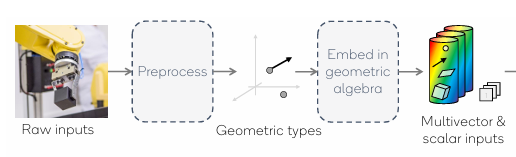


As mentioned earlier, the GATr network is designed to process multivectors and scalars of data in the projective geometric algebra of $\mathcal{G}_{3,0,1}$.

Therefore, before feeding the data into the GATr network, it needs to be preprocessed and embedded into multivectors of $\mathcal{G}_{3,0,1}$. This process involves the following steps:

1. **Geometric Type Extraction**: If necessary, raw inputs are preprocessed into geometric types, such as points, lines, planes, or other geometric objects.
2. **Multivector Embedding**: The geometric objects are embedded into multivectors of the projective geometric algebra $\mathcal{G}_{3,0,1}$ following the recipe described in Table 1 of the paper/above.

Table 1 specifies how common geometric objects and transformations are mapped to multivectors in $\mathcal{G}_{3,0,1}$. For example, a scalar $\lambda \in \mathbb{R}$ is embedded as $\lambda$, a plane with normal $n \in \mathbb{R}^3$ and origin shift $d \in \mathbb{R}$ is embedded as $d + n$, and a rotation expressed as a quaternion $q \in \mathbb{R}^4$ is embedded as $q_0 + q_1 e_1 + q_2 e_2 + q_3 e_3$.

In [ ]:
# @title Download the Data

def download_file(gdrive_file_link, output_file):

    file_id = gdrive_file_link.split('/')[-2] # Get the file ID from the Google Drive link
    # gdrive_download_link = f"https://drive.google.com/uc?id={file_id}" # Construct the correct download link
    # gdown.download(gdrive_download_link, output_file, quiet=False)
    !gdown --id {file_id} -O {output_file}

    print(f"Downloaded and extracted files from {gdrive_file_link} to {output_file}")

download_file(config.sin_gdrive_path, config.sin_path)
download_file(config.bif_gdrive_path, config.bif_path)

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1b4Nhc3PUL_ZAChoOCRpCK4Nh-eKL66-v
From (redirected): https://drive.google.com/uc?id=1b4Nhc3PUL_ZAChoOCRpCK4Nh-eKL66-v&confirm=t&uuid=2a4fa789-0008-4f31-ba5c-04a150b9dffd
To: /content/single.hdf5
100% 966M/966M [00:09<00:00, 106MB/s]
Downloaded and extracted files from https://drive.google.com/file/d/1b4Nhc3PUL_ZAChoOCRpCK4Nh-eKL66-v/view?usp=drive_link to /content/single.hdf5
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1U1UZR1nlIhlhzgGcPisASbTugn3iO7G5
From (redirected): 

In [ ]:
# Let's inspect the data
# Note that hdf5 has 2 data formats: dataset (List of items) and group (Dict -> folder structure)
# By inspection, the datset doesn't have the same shape for each 2nd level key.
# E.g. for face: sample_0000 -> (20946, 3), sample_0009 -> (19828, 3), sample_0909 -> (18922, 3), etc.

with h5py.File(config.sin_path, "r+") as hdf_file:

    # First level keys
    print(f"First level keys: ", hdf_file.keys())
    print(f"Type: {type(hdf_file).__name__}")

    print(f"2nd level keys: ", hdf_file["sample_0000"].keys())

    # Let's print the shapes of the 2nd level keys
    for key in hdf_file["sample_0000"].keys():
        print("Key: ", key, "\tShape: ", hdf_file["sample_0000"][key].shape, "\tType: ", type(hdf_file["sample_0000"][key]).__name__, "\tType within: ", hdf_file["sample_0000"][key].dtype)



First level keys:  <KeysViewHDF5 ['sample_0000', 'sample_0001', 'sample_0002', 'sample_0003', 'sample_0004', 'sample_0005', 'sample_0006', 'sample_0007', 'sample_0008', 'sample_0009', 'sample_0010', 'sample_0011', 'sample_0012', 'sample_0013', 'sample_0014', 'sample_0015', 'sample_0016', 'sample_0017', 'sample_0018', 'sample_0019', 'sample_0020', 'sample_0021', 'sample_0022', 'sample_0023', 'sample_0024', 'sample_0025', 'sample_0026', 'sample_0027', 'sample_0028', 'sample_0029', 'sample_0030', 'sample_0031', 'sample_0032', 'sample_0033', 'sample_0034', 'sample_0035', 'sample_0036', 'sample_0037', 'sample_0038', 'sample_0039', 'sample_0040', 'sample_0041', 'sample_0042', 'sample_0043', 'sample_0044', 'sample_0045', 'sample_0046', 'sample_0047', 'sample_0048', 'sample_0049', 'sample_0050', 'sample_0051', 'sample_0052', 'sample_0053', 'sample_0054', 'sample_0055', 'sample_0056', 'sample_0057', 'sample_0058', 'sample_0059', 'sample_0060', 'sample_0061', 'sample_0062', 'sample_0063', 'sampl

In [ ]:
# use the more efficient cuda pandas
if torch.cuda.is_available():
    %load_ext cudf
    import cudf
    import pandas as pd

    # Check GPU
    !nvidia-smi
else:
    import pandas as pd

The cudf module is not an IPython extension.
Mon May 27 02:12:19 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8              10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+----------------------

In [ ]:
# @title HDF5 to DataFrame

@lru_cache()
def hdf5_2_df(hdf_path, label: int=0):

    """Convert the HDF5 file to a pandas DataFrame and add labels and ids to the DataFrame.

    Note that we are flattening the data into 1D arrays so that it can be stared in a pandas DataFrame.
    This operation is simply reshaping the data. The reverse operation is just reversing the reshaping.

    Args:
        hdf_path (Path, str): Path to the HDF5 file
        label (int): Label to add to the DataFrame

    Returns:
        pandas DataFrame
    """

    # Open the HDF5 file
    with h5py.File(hdf_path, 'r') as hdf_file:
        # List all groups in the HDF5 file (e.g., 'sample_0000', 'sample_0001', etc.)
        groups = list(hdf_file.keys())
        dfs = [] # Create an empty list to store DataFrames

        # Iterate over each group
        for idx, group in enumerate( tqdm(groups, desc="Processing groups") ):
            group_data = hdf_file[group]
            # Note that pandas DF takes 1D arrays as input, not more than 1D, so let's flatten them
            face = group_data['face'][:].reshape(-1)#.tolist()
            pos = group_data['pos'][:].reshape(-1)#.tolist()
            wss = group_data['wss'][:].reshape(-1)#.tolist()

            dfs.append( pd.DataFrame({
                        'id_orig': idx,
                        'face': [face],
                        'inlet_idcs': [group_data['inlet_idcs'][:]],
                        'label': label,
                        'pos': [pos],
                        'pressure': [group_data['pressure'][:]],
                        'wss': [wss]
                      })
            )

        combined_df = pd.concat(dfs, keys=groups) # Concatenate all DataFrames into one

        # Reset the index to a range starting from 0 and ending at the maximum length
        combined_df.reset_index(drop=True, inplace=True)

    return combined_df

In [ ]:
# @title Single dataset
single_df = hdf5_2_df(config.sin_path, label=0)
print(f"Shape of single dataset: {single_df.shape}")
single_df

Processing groups:   0%|          | 0/2000 [00:00<?, ?it/s]

Shape of single dataset: (2000, 7)


,id_orig,face,inlet_idcs,label,pos,pressure,wss
0,0,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[4904, 4903, 4905, 4906, 6278, 6277, 10084, 58...",0,"[-1.6634878, 0.5977221, -0.14623034, -1.639305...","[137516.61, 137509.38, 137504.31, 137520.55, 1...","[37.656456, -15.887314, 0.103681274, 33.161873..."
1,1,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[4211, 4210, 4209, 4214, 4217, 9874, 9875, 421...",0,"[-1.7170717, -0.67348653, 0.09727499, -1.69393...","[134978.83, 134965.62, 134965.03, 134975.28, 1...","[35.997448, 17.926884, -0.20090649, 31.120863,..."
2,2,"[1, 0, 2, 4, 3, 5, 3, 6, 5, 8, 7, 4, 4, 7, 3, ...","[8333, 8335, 8334, 8336, 8396, 8397, 9110, 901...",0,"[-1.1628478, -1.1747793, 0.08082309, -1.143276...","[135524.67, 135501.72, 135508.27, 135491.78, 1...","[33.831013, 28.30102, 0.07786529, 31.040365, 2..."
3,3,"[1, 0, 2, 4, 3, 5, 5, 6, 7, 7, 8, 9, 9, 10, 11...","[5354, 5353, 5355, 5356, 9727, 9726, 11427, 58...",0,"[-1.7381623, 0.8070083, -0.00857696, -1.762849...","[138243.19, 138286.1, 138270.47, 138240.36, 13...","[40.4433, -24.139816, 0.061637864, 46.632454, ..."
4,4,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 6, 8, 5, ...","[2, 1, 0, 7693, 7049, 7702, 7703, 3, 7058, 705...",0,"[-0.9938266, -0.862775, -0.044097792, -1.00052...","[137532.75, 137477.92, 137534.38, 137526.11, 1...","[0.0, 0.0, 0.0, 289.15024, 198.78397, -5.75360..."
...,...,...,...,...,...,...,...
1995,1995,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[4206, 4205, 4204, 6354, 6357, 9762, 9763, 420...",0,"[-1.7461525, -0.54356295, 0.074279234, -1.7210...","[135007.16, 134986.27, 134994.1, 134996.27, 13...","[37.523945, 15.587713, 0.063927114, 34.39165, ..."
1996,1996,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 6, 8, 5, ...","[2, 1, 0, 8858, 8849, 8859, 8860, 3, 7709, 771...",0,"[-1.2597517, 0.7533587, 0.12767847, -1.2728709...","[139433.86, 139409.1, 139406.03, 139434.86, 13...","[0.0, 0.0, 0.0, 306.3239, -165.54039, -0.12564..."
1997,1997,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[4402, 4401, 4403, 4404, 4407, 4406, 9263, 746...",0,"[-1.6490406, -0.1853284, 0.14659692, -1.625463...","[135915.9, 135899.83, 135892.9, 135908.86, 135...","[42.105885, 7.1596594, -0.013477484, 38.054443..."
1998,1998,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 5, 2, 6, 5, 1, 2, ...","[2, 1, 0, 6, 5, 9109, 9110, 3, 8847, 8848, 8, ...",0,"[-1.2209615, 1.198552, 0.12063687, -1.2386876,...","[136483.19, 136333.52, 136334.89, 136494.19, 1...","[0.0, 0.0, 0.0, 264.2387, -226.32863, 0.782674..."


In [ ]:
# @title Bifurcating dataset
bif_df = hdf5_2_df(config.bif_path, label=1)
print(f"Shape of bifurcating dataset: {bif_df.shape}")
bif_df

Processing groups:   0%|          | 0/1999 [00:00<?, ?it/s]

Shape of bifurcating dataset: (1999, 7)


,id_orig,face,inlet_idcs,label,pos,pressure,wss
0,0,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 6, 8, 5, ...","[2, 1, 0, 5, 8, 17421, 17422, 3, 11161, 11162,...",1,"[-0.14346066, -0.15499471, -0.0040547107, -0.1...","[133372.53, 133347.19, 133348.75, 133369.2, 13...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,1,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 1, 9, 10, 12, 11, ...","[17136, 8926, 8929, 34, 17860, 17861, 18017, 4...",1,"[-0.3406898, -0.44518524, 1.1061692, -0.336826...","[133368.78, 133368.62, 133369.81, 133381.0, 13...","[-2.619563, -7.57559, -1.5136665, -2.6139448, ..."
2,2,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 8, 12, 11, ...","[60, 59, 58, 13401, 2058, 16652, 16653, 61, 15...",1,"[-0.07204999, -0.71268684, 1.3231279, -0.05775...","[133432.03, 133433.2, 133434.7, 133438.02, 133...","[-0.76358294, -8.033029, 1.2654027, -0.8731057..."
3,3,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[12003, 12002, 12004, 1077, 12009, 12008, 1569...",1,"[-0.055379037, -0.16440114, 0.10375278, -0.062...","[133741.47, 133737.33, 133737.98, 133728.55, 1...","[-0.045588695, 1.4797673, 14.098197, -0.074374..."
4,4,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 10, 12,...","[11, 10, 9, 1858, 1857, 14917, 14918, 12, 1460...",1,"[-0.22965148, -0.17610241, 1.400259, -0.226065...","[133494.86, 133498.25, 133496.6, 133757.88, 13...","[-1.6926321, -6.8415756, 2.1289616, -1.6467565..."
...,...,...,...,...,...,...,...
1994,1994,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 9, 8, 10,...","[2, 1, 0, 8, 11, 11408, 11409, 3, 216, 217, 10...",1,"[-0.1192309, 0.07389089, 0.0064579095, -0.1263...","[134135.97, 134145.72, 134146.14, 134135.45, 1...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1995,1995,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[29, 28, 27, 32, 35, 17004, 17005, 30, 16993, ...",1,"[-0.17015655, 0.5503211, 1.5077916, -0.1776447...","[133419.44, 133414.17, 133424.06, 133558.53, 1...","[-4.834763, -13.364471, 17.32925, -5.153789, -..."
1996,1996,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[14185, 14187, 14186, 1815, 12037, 14896, 1530...",1,"[-0.1948077, -0.023417149, 0.099937275, -0.195...","[133794.81, 133792.44, 133793.83, 133792.62, 1...","[-1.0170583, 1.0383871, 11.288908, -0.8495299,..."
1997,1997,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[340, 16283, 10255, 1839, 10271, 1840, 17871, ...",1,"[0.1015828, -0.18797742, 0.10745045, 0.1160526...","[133666.58, 133665.23, 133666.6, 133598.8, 133...","[1.0820825, 1.396963, 8.6344185, 1.0746431, 1...."


Notice that the Bifurcation is one less than the Single. This should not be a problem. However, if there were too much data imbalance, then we could use imbalance mitigation techniques, such as weighting the loss function, data augmentation, etc.

In [ ]:
# @title Concatenate the two datasets

df = pd.concat([single_df, bif_df], axis=0)
print(f"Shape of the entire dataset: {df.shape}")
df.reset_index(drop=True, inplace=True)
df

Shape of the entire dataset: (3999, 7)


,id_orig,face,inlet_idcs,label,pos,pressure,wss
0,0,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[4904, 4903, 4905, 4906, 6278, 6277, 10084, 58...",0,"[-1.6634878, 0.5977221, -0.14623034, -1.639305...","[137516.61, 137509.38, 137504.31, 137520.55, 1...","[37.656456, -15.887314, 0.103681274, 33.161873..."
1,1,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[4211, 4210, 4209, 4214, 4217, 9874, 9875, 421...",0,"[-1.7170717, -0.67348653, 0.09727499, -1.69393...","[134978.83, 134965.62, 134965.03, 134975.28, 1...","[35.997448, 17.926884, -0.20090649, 31.120863,..."
2,2,"[1, 0, 2, 4, 3, 5, 3, 6, 5, 8, 7, 4, 4, 7, 3, ...","[8333, 8335, 8334, 8336, 8396, 8397, 9110, 901...",0,"[-1.1628478, -1.1747793, 0.08082309, -1.143276...","[135524.67, 135501.72, 135508.27, 135491.78, 1...","[33.831013, 28.30102, 0.07786529, 31.040365, 2..."
3,3,"[1, 0, 2, 4, 3, 5, 5, 6, 7, 7, 8, 9, 9, 10, 11...","[5354, 5353, 5355, 5356, 9727, 9726, 11427, 58...",0,"[-1.7381623, 0.8070083, -0.00857696, -1.762849...","[138243.19, 138286.1, 138270.47, 138240.36, 13...","[40.4433, -24.139816, 0.061637864, 46.632454, ..."
4,4,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 6, 8, 5, ...","[2, 1, 0, 7693, 7049, 7702, 7703, 3, 7058, 705...",0,"[-0.9938266, -0.862775, -0.044097792, -1.00052...","[137532.75, 137477.92, 137534.38, 137526.11, 1...","[0.0, 0.0, 0.0, 289.15024, 198.78397, -5.75360..."
...,...,...,...,...,...,...,...
3994,1994,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 9, 8, 10,...","[2, 1, 0, 8, 11, 11408, 11409, 3, 216, 217, 10...",1,"[-0.1192309, 0.07389089, 0.0064579095, -0.1263...","[134135.97, 134145.72, 134146.14, 134135.45, 1...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3995,1995,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[29, 28, 27, 32, 35, 17004, 17005, 30, 16993, ...",1,"[-0.17015655, 0.5503211, 1.5077916, -0.1776447...","[133419.44, 133414.17, 133424.06, 133558.53, 1...","[-4.834763, -13.364471, 17.32925, -5.153789, -..."
3996,1996,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[14185, 14187, 14186, 1815, 12037, 14896, 1530...",1,"[-0.1948077, -0.023417149, 0.099937275, -0.195...","[133794.81, 133792.44, 133793.83, 133792.62, 1...","[-1.0170583, 1.0383871, 11.288908, -0.8495299,..."
3997,1997,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[340, 16283, 10255, 1839, 10271, 1840, 17871, ...",1,"[0.1015828, -0.18797742, 0.10745045, 0.1160526...","[133666.58, 133665.23, 133666.6, 133598.8, 133...","[1.0820825, 1.396963, 8.6344185, 1.0746431, 1...."


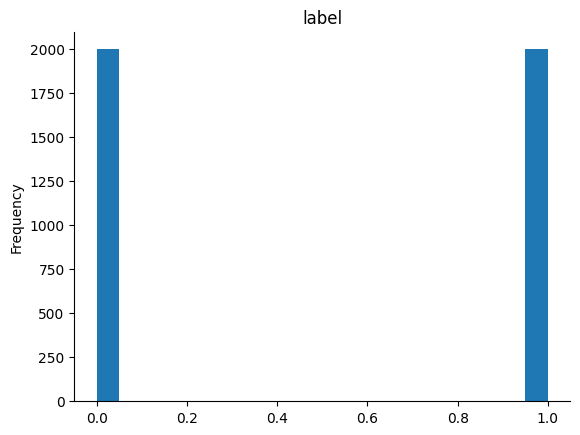

In [ ]:

from matplotlib import pyplot as plt
df['label'].plot(kind='hist', bins=20, title='label')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:

# Get the max and min values of the 'face' column
min_values = df['face'].apply(np.min, axis=0)
max_values = df['face'].apply(np.max, axis=0)

print("Minimum values:")
print(min_values[:5])

print("\nMaximum values:")
print(max_values[:5])

Minimum values:
0    0
1    0
2    0
3    0
4    0
Name: face, dtype: int32

Maximum values:
0    10474
1    10275
2     9462
3    11844
4     7979
Name: face, dtype: int32


In [ ]:
# Get the min and max lengths of the 'face' column
array_lengths = df['face'].apply(len)

min_length = array_lengths.min()
max_length = array_lengths.max()

print("Minimum length of arrays:", min_length//3)
print("Maximum length of arrays:", max_length//3)

# This is a very long sequence, so we'll need to truncate it

Minimum length of arrays: 10928
Maximum length of arrays: 49596


In [ ]:
min_length_idx = array_lengths.idxmin()
max_length_idx = array_lengths.idxmax()

print("Index of array with minimum length:", min_length_idx)
print("Index of array with maximum length:", max_length_idx)

Index of array with minimum length: 905
Index of array with maximum length: 3611


In [ ]:
# @title Train, val, test splits

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    df, df['label'], test_size=config.train_test_split, random_state=config.seed, stratify=df['label'], shuffle=True
    )
X_train, val_train, y_train, val_test = train_test_split(
    X_train, X_train['label'], test_size=config.train_val_split, random_state=config.seed, stratify=X_train['label'], shuffle=True
    )

X_train.shape, y_train.shape, val_train.shape, val_test.shape, X_test.shape, y_test.shape

((2559, 7), (2559,), (640, 7), (640,), (800, 7), (800,))

In [ ]:
# Reset the indices
X_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
val_train.reset_index(drop=True, inplace=True)
val_test.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

X_train

,id_orig,face,inlet_idcs,label,pos,pressure,wss
0,1019,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 5, 2, 6, 5, 1, 2, ...","[2, 1, 0, 6, 5, 8702, 8703, 3, 7740, 7741, 9, ...",0,"[-1.478191, -0.3101027, 0.053197175, -1.474626...","[136328.0, 136334.05, 136351.45, 136325.53, 13...","[0.0, 0.0, 0.0, 332.0939, 104.414505, 1.541433..."
1,903,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[5468, 5467, 5469, 5470, 9409, 9408, 10656, 84...",0,"[-1.5479435, 1.1190703, -0.19063953, -1.532925...","[135854.77, 135844.6, 135842.77, 135857.12, 13...","[31.344744, -24.010406, 0.16083655, 27.406458,..."
2,975,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 13, 12,...","[13676, 13675, 13677, 46, 13819, 13156, 14335,...",1,"[0.16873719, 0.058666274, 0.035594247, 0.16814...","[133698.42, 133704.78, 133698.89, 133698.77, 1...","[0.4180786, -0.6655423, 10.603509, 0.2591929, ..."
3,1421,"[1, 0, 2, 3, 0, 1, 4, 0, 3, 6, 5, 7, 5, 8, 7, ...","[1, 0, 2, 3, 7046, 7049, 8545, 8352, 8353, 854...",0,"[-1.344189, -0.66886, 0.07959626, -1.3395914, ...","[137223.4, 137359.64, 137220.23, 137378.62, 13...","[275.42184, 109.119095, -0.82751703, 0.0, 0.0,..."
4,827,"[1, 0, 2, 1, 3, 0, 1, 4, 3, 6, 5, 7, 6, 8, 5, ...","[2, 1, 0, 3645, 1647, 17095, 17096, 3, 3855, 1...",1,"[-0.1915534, -0.07080804, 0.0069249747, -0.183...","[133697.03, 133681.03, 133681.48, 133696.88, 1...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...
2554,1446,"[1, 0, 2, 4, 3, 5, 3, 6, 5, 4, 7, 3, 2, 8, 1, ...","[4602, 4601, 4600, 8274, 8273, 9213, 9214, 460...",0,"[-1.6931572, 0.4220276, -0.1680019, -1.6633705...","[135240.31, 135230.42, 135234.77, 135208.36, 1...","[38.210293, -11.236585, -0.05296663, 34.352695..."
2555,154,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[3460, 3459, 3458, 10254, 10253, 10526, 10527,...",0,"[-1.8485427, -0.21681485, 0.13536322, -1.82025...","[136138.39, 136122.67, 136122.31, 136133.84, 1...","[39.830513, 7.5672936, -0.15206137, 34.721104,..."
2556,1750,"[1, 0, 2, 2, 3, 4, 4, 5, 6, 6, 7, 8, 8, 9, 10,...","[3641, 3640, 3642, 3643, 3646, 3645, 9088, 572...",0,"[-1.6391923, 0.17659545, -0.16513069, -1.61436...","[135214.53, 135199.19, 135195.47, 135213.83, 1...","[42.878963, -5.34008, -0.052091803, 37.895023,..."
2557,968,"[1, 0, 2, 4, 3, 5, 7, 6, 8, 10, 9, 11, 10, 12,...","[12859, 12861, 12860, 4, 3081, 3082, 14409, 11...",1,"[0.12363559, 0.11184157, 0.115741074, 0.124837...","[133855.89, 133852.39, 133853.14, 133868.31, 1...","[-1.8788491, 0.895948, 12.238262, -1.7300814, ..."


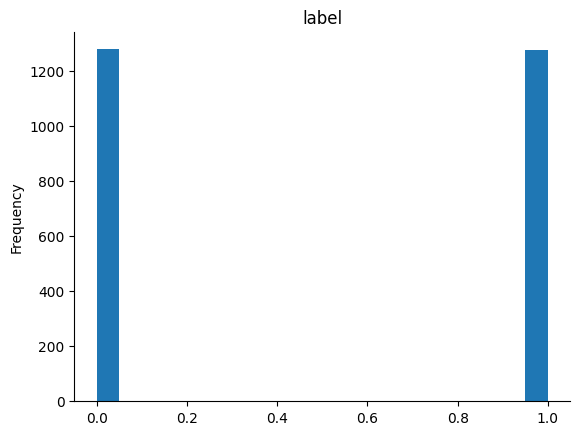

In [ ]:
# @title label distribution of the Train set

from matplotlib import pyplot as plt
X_train['label'].plot(kind='hist', bins=20, title='label')
plt.gca().spines[['top', 'right',]].set_visible(False)

Since the length of each feature of each sample is very long, to plot some statistics about the data, we need to reduce the dimension of the data.
In light of this, we average the features of each sample just for plotting. Note that this is not used in training the GATr model. See the appropriate section for details about this.

In [ ]:
# @title Plot the mean of each feature
# Let's get the mean of the values for each feature and then plot them

def feature_means(sample):
    """Get the mean of each feature in the sample for plottiing"""

    sample_face = sample['face'].mean()
    sample_inlet_idcs = sample['inlet_idcs'].mean()
    sample_pos = sample['pos'].mean()
    sample_pressure = sample['pressure'].mean()
    sample_wss = sample['wss'].mean()

    return pd.Series({
        'face': sample_face,
        'inlet': sample_inlet_idcs,
        'pos': sample_pos,
        'pressure': sample_pressure,
        'wss': sample_wss
    })

X_train_means = X_train.drop(columns=['id_orig', 'label'], inplace=False)
X_train_means = X_train_means.apply(lambda sample: feature_means(sample), axis=1)
# X_train_means = pd.DataFrame(X_train_means, columns=['face', 'inlet', 'pos', 'pressure', 'wss'])
X_train_means

,face,inlet,pos,pressure,wss
0,4523.145633,8244.366379,0.685182,134439.640625,5.847380
1,5521.365604,10176.150735,0.817614,134474.781250,6.934186
2,7730.011832,13537.957766,0.330236,133513.953125,1.998813
3,4437.576483,8301.747826,0.709519,134677.015625,8.132580
4,9395.970166,17008.751106,0.424851,133519.234375,2.112388
...,...,...,...,...,...
2554,4793.387789,9162.450980,0.785724,134262.187500,6.776742
2555,5455.085734,9922.247191,0.721090,134498.921875,7.890038
2556,4715.601199,8365.884921,0.613695,134167.187500,5.542541
2557,7827.180960,13481.857923,0.226964,133607.437500,-0.033570


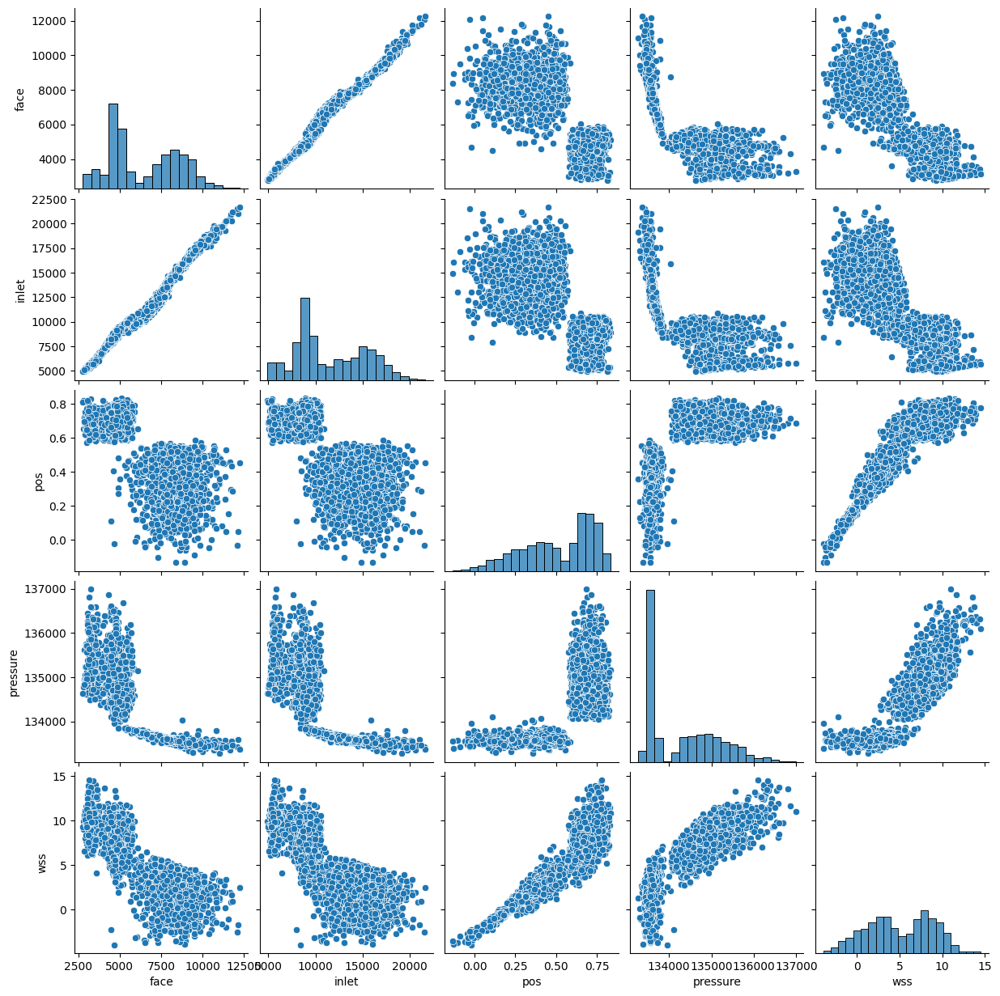

In [ ]:
sns.pairplot(X_train_means)
plt.show()

Even though we can inspect the data distribution like this, it does not provide us a crude numerical description of the data. For example, we can clearly see that the `face` and `inlet_idcs` features have a very high correlation of $\approx 99\%$



For that, we calculate and plot the `Correlation Matrix` like so:

Correlation shape:  (5, 5)


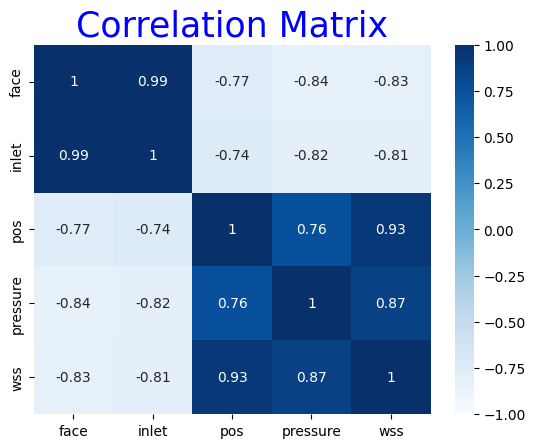

In [ ]:
# @title Correlation matrix

corr = X_train_means.corr()
print("Correlation shape: ", corr.shape)

# ax, fig = plt.subplots(figsize = (30,30))
plt.title("Correlation Matrix", color="blue", fontsize=25)
sns.heatmap(corr, vmin=-1, cmap=plt.cm.Blues, annot=True)
plt.show()

Looking at both the **pairplot** and the **heatmap** of the correlation matrix, we can see that there is strong correlation between the variables -- either in the same direction or the opposite, i.e., |corr| is high. In particular, the correlation between the **inlet** and the **face** is almost 1 $\approx 99\%$. This means that the **inlet** can be highly predicted from the **face**, and that it doesn't provide much information to the model for the classification. Therefore, removing it from the input to the model will reduce the dimensionality of the model and approximately no reduction in accuracy.



In [ ]:
# @title Confusion Matrix

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

def confusion_matrix_score(ytest, ypred, labels=["0","1"]):
    """A helper function for plotting the confusion matrix, accuracy score and classification report

    Args:
        ytest (list): list of true labels
        ypred (list): list of predicted labels
        labels (list): list of labels

    Returns:
        None
    """

    # Calculate accuracy score
    score = accuracy_score(ytest, ypred) * 100
    print(f"\n\nThe accuracy score is {score:.4f}%.", end="\n\n")

    # Confusion Matrix
    conf_matrix = confusion_matrix(ytest, ypred)

    # Plot Confusion Matrix using sns heatmap
    sns.heatmap(conf_matrix, square=True, annot=True, fmt='d', cbar=True, lw=0.6,
                xticklabels=labels,
                yticklabels=labels)

    plt.title("Confusion Matrix", color="blue", fontsize=25)

    plt.xlabel('True Label')
    plt.ylabel('Predicted Label');

    # classification_report
    print(f"classification_report: \n{ classification_report(ytest, ypred, target_names=labels) }", end="\n\n")

# confusion_matrix_score(gatr_model.targets, gatr_model.preds)

Mean pressure: [1.34969359 1.34103297 1.34405516 1.3554025  1.35049328]
ylim:  (-0.05500000000000001, 0.05500000000000001)


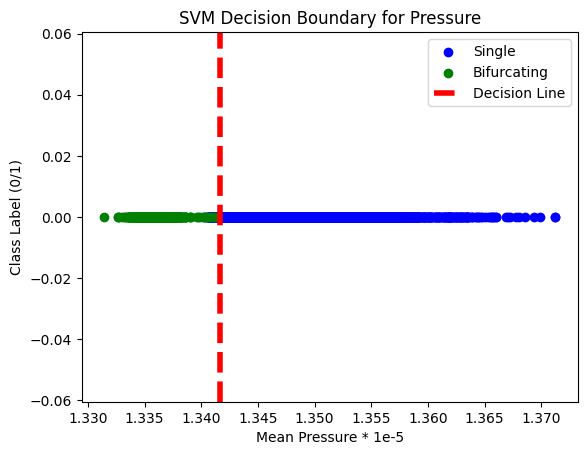

In [ ]:
# @title Plot feature
# From this cell we can see that the dataset is so simple that even a linear classifier can classify it with a very good accuracy.
# Even without the other features, the dataset is still very simple.

def plot_feature(df, feat_name: str):
    """Plot feature means

    Args:
        df (pd.DataFrame): dataframe
        feat_name (str): feature name

    Returns:
        None
    """

    # Calculate mean pressures for each sample
    mean_vals = df[feat_name].apply(lambda x: x.mean() *1e-5).to_numpy()
    print(f"Mean {feat_name}: {mean_vals[:5]}")

    # Get the labels
    labels = df["label"].to_numpy()

    # Separate mean pressures based on labels
    mean_single = mean_vals[labels == 0]
    mean_bif = mean_vals[labels == 1]

    # Plot the data points with labels
    # plt.scatter(mean_pressures, [0]*len(mean_pressures), color=['blue' if l == 0 else 'green' for l in labels])
    plt.scatter(mean_single, [0] * len(mean_single), color="blue", label="Single")
    plt.scatter(mean_bif, [0] * len(mean_bif), color="green", label="Bifurcating")

    min_single = min(mean_single)
    max_bif = max(mean_bif)
    min_max = abs(max_bif - min_single) / 2 + max_bif

    # Get ylim
    ylim = plt.gca().get_ylim()
    print("ylim: ", ylim)

    # Plot the decision line
    plt.axline((min_max, ylim[0]), (min_max, ylim[1]), color='red', linestyle="--", label="Decision Line", linewidth=4)
    # plt.plot( (min_max, 0), slope=1, color='red', linestyle="--", label="Decision Line")

    # Add labels and title
    plt.xlabel("Mean Pressure * 1e-5")
    plt.ylabel("Class Label (0/1)")  # Show actual labels (0/1)
    plt.title('SVM Decision Boundary for Pressure')
    plt.legend()
    plt.show()

plot_feature(df, 'pressure')

## 1/2. Average over Datasets and use Linear Models

From the previous sections, we saw that the data format looks like this:
- for face: sample_0000 -> (20946, 3), sample_0009 -> (19828, 3), sample_0909 -> (18922, 3), etc.
- We have different sample sizes. To solve this, we can follow three different approaches:
    1. Average over each feature of each sample. This implies that we have a float for each feature of each sample rather than lists.
        - for face: sample_0000 -> (20946, 3) -> flaot, sample_0009 -> (19828, 3) -> float, sample_0909 -> (18922, 3) -> float, etc.
    
    2. Split each feature of each sample equally into N lists. Then do the same thing as above. This means that each feature has N averaged items, instead of just one.

    3. Take the first N items of each feature of each sample, and throw away the rest. In this, we just greedily take the first N items of each feature in each sample.

In this section, we will implement approach 1. The other two approaches will be discussed once we have introduced the Projective Geometric Algebra (PGA) concepts, such as embedding points, lines, etc.

### 1. Average over each feature in the dataset

In [ ]:
# AvgAll Dataset Class

class AvgAll(Dataset):
    """
    Dataset class for averaging all features in each sample.

    Parameters:
        df (pd.DataFrame): The dataframe containing the data.

    Returns:
        Tuple[np.ndarray, np.ndarray]: The averaged data, the labels
    """

    def __init__(self, df: pd.DataFrame):
        """Initializes the dataset.
        """
        super(AvgAll, self).__init__()
        self.df = df

    def __len__(self):
        return len(self.df)

    def __getitem__(self, i):
        """
        Retrieves a single sample from the dataset.

        Parameters:
        - i (int): The index of the sample to retrieve.

        Returns:
            Tuple[np.ndarray, int]: The sample and its label.
            The first has shape: (1,10), the second has shape: (1).
        """
        sample_i = self.df.iloc[i] # Get the i-th item
        sample = self.preprocess_data(sample=sample_i)
        label = self.df.iloc[i]["label"]

        return sample, label

    def preprocess_data(self, sample):

        # Note that the features of each sample has different sizes, here denoted as N, P, X, W.
        sample = {
            # Shape before reshape: (3N) -> after reshape: (N,3) -> after mean: (1,3)
            'face': np.mean( sample['face'].reshape((-1, 3)), axis=0, keepdims=True), # (N,3) -> (1,3)
            # 'inlet_idcs': np.mean(sample['inlet_idcs'].reshape((-1, 1)), axis=0, keepdim=True), # (N,1) -> (1,1)

            # Shape before reshape: (3P) -> after reshape: (P,3) -> after mean: (1,3)
            'pos': np.mean(sample['pos'].reshape((-1, 3)), axis=0, keepdims=True), # (P,3) -> (1,3)

            # Shape before reshape: (1X) -> after reshape: (X,1) -> after mean: (1,1)
            'pressure': np.mean(sample['pressure'].reshape((-1, 1)), axis=0, keepdims=True), # (X,1) (1,1)

            # Shape before reshape: (3W) -> after reshape: (W,3) -> after mean: (1,3)
            'wss': np.mean(sample['wss'].reshape((-1, 3)), axis=0, keepdims=True), # (W,3) -> (1,3)
                }

        # print(f"Pressure -> {sample['pressure'].shape} wss -> {sample['wss'].shape} pos -> {sample['pos'].shape} face -> {sample['face'].shape}")
        # print(f"Sample: {sample}")

        # Concatenate the features -> shape: (1,3N+1) = (1,10)
        concatenated = np.concatenate([sample['face'], sample['pos'], sample['wss'], sample['pressure']], axis=-1) # concatenate along last dim

        return concatenated

    # Allow lru_cache to cache this
    @lru_cache()
    def get_np_arrays(self, normalize=True):
        """Get the features and labels from the dataset as numpy arrays.

        Parameters:
        - normalize (bool): Whether to normalize the features.

        Returns:
            Tuple[np.ndarray, np.ndarray]: The features and labels as numpy arrays.
            Features: (3999, 10) 	labels -> (3999,)
        """
        features_array = []
        labels_array = []

        for idx in tqdm(range(len(self)), desc="Generating features and labels"):
            features, labels = self[idx]

            features_array.append(features)
            labels_array.append(labels)

        #concat from list
        features_array = np.concatenate(features_array, axis=0) # Shape: (3999, 10)
        labels_array = np.stack(labels_array, axis=0) # Shape: (3999,)

        if normalize:
            features_array = (features_array - features_array.mean()) / features_array.std()

        return features_array, labels_array


In [ ]:
# Test the AvgAll class
avg_dataset = AvgAll(df)

print(f"len(avg_dataset): {len(avg_dataset)}")

for idx, (sample, label) in enumerate(avg_dataset):
    print(f"sample: \n{sample}, \nlabel: {label}")

    if idx == 5:
        break


len(avg_dataset): 3999
sample: 
[[ 4.86848257e+03  5.93311415e+03  4.86874945e+03  2.08156991e+00
  -2.48295188e-01  5.90404146e-04  2.57400475e+01 -2.74872923e+00
  -5.87432981e-02  1.34969359e+05]], 
label: 0
sample: 
[[ 4.78388271e+03  5.80013627e+03  4.79418780e+03  2.13564587e+00
   1.04513176e-01 -1.22256204e-03  1.76963024e+01  2.68171763e+00
  -2.08321270e-02  1.34103297e+05]], 
label: 0
sample: 
[[ 4.55609074e+03  5.06494393e+03  4.55604540e+03  2.11128235e+00
  -1.70264170e-01 -3.68716806e-04  1.82745152e+01  3.09911776e+00
  -7.74744432e-03  1.34405516e+05]], 
label: 0
sample: 
[[ 5.39085097e+03  6.92241413e+03  5.38662180e+03  2.14834785e+00
  -2.35651970e-01  1.60061929e-03  2.46115971e+01 -2.26161647e+00
  -3.81351635e-02  1.35540250e+05]], 
label: 0
sample: 
[[ 3.62444510e+03  4.67715549e+03  3.63844911e+03  2.11947465e+00
   1.56702623e-01 -7.03677943e-04  2.14429817e+01  8.73396301e+00
  -3.66352662e-03  1.35049328e+05]], 
label: 0
sample: 
[[ 3.90590388e+03  4.7889479

In [ ]:
features_normalized, labels_normalized = avg_dataset.get_np_arrays(normalize=True)

features_not_normalized, labels_not_normalized = avg_dataset.get_np_arrays(normalize=False)


Generating features and labels:   0%|          | 0/3999 [00:00<?, ?it/s]

Generating features and labels:   0%|          | 0/3999 [00:00<?, ?it/s]

In [ ]:
print(f"features shape -> {features_normalized.shape}", end="\t")
print(f"len(labels) -> {labels_normalized.shape}")

print(f"Before normalize mean==0 -> {np.allclose(features_not_normalized.mean(), 0)}", end="\t") # False
print(f"std==1 -> {np.allclose(features_not_normalized.std(), 1) }") # False

print(f"After normalize mean==0 -> {np.allclose(features_normalized.mean(), 0)}", end="\t") # True
print(f"std==1 -> {np.allclose(features_normalized.std(), 1) }") # True


features shape -> (3999, 10)	len(labels) -> (3999,)
Before normalize mean==0 -> False	std==1 -> False
After normalize mean==0 -> True	std==1 -> True


In [ ]:
# Split the data
from sklearn.model_selection import train_test_split

features_train_normalized, features_test_normalized, labels_train_normalized, labels_test_normalized = \
train_test_split(features_normalized, labels_normalized, test_size=0.2, random_state=2024, stratify=labels_normalized, shuffle=True)

features_train_not_normalized, features_test_not_normalized, labels_train_not_normalized, labels_test_not_normalized = \
train_test_split(features_not_normalized, labels_not_normalized, test_size=0.2, random_state=2024, stratify=labels_not_normalized, shuffle=True)

print(f"Non Normalized Shapes: features_train: {features_train_not_normalized.shape}, "
      f"features_test: {features_test_not_normalized.shape}, "
      f"labels_train: {labels_train_not_normalized.shape}, "
      f"labels_test: {labels_test_not_normalized.shape}")

print(f"Normalized Shapes: features_train: {features_train_normalized.shape}, "
      f"features_test: {features_test_normalized.shape}, "
      f"labels_train: {labels_train_normalized.shape}, "
      f"labels_test: {labels_test_normalized.shape}")

Non Normalized Shapes: features_train: (3199, 10), features_test: (800, 10), labels_train: (3199,), labels_test: (800,)
Normalized Shapes: features_train: (3199, 10), features_test: (800, 10), labels_train: (3199,), labels_test: (800,)


### Simple Linear classifiers

Let's first observe how simple or hard the dataset is by first fitting simple linear models.

SVM Predictions: 1.0


The accuracy score is 100.0000%.

classification_report: 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       400
           1       1.00      1.00      1.00       400

    accuracy                           1.00       800
   macro avg       1.00      1.00      1.00       800
weighted avg       1.00      1.00      1.00       800




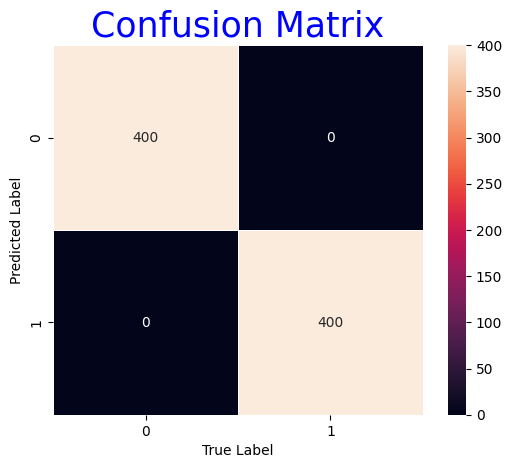

In [ ]:
# @title Train an SVM linear classifier for the non normalized data

from sklearn.svm import SVC

# Define SVM model
svm_model = SVC(kernel='linear')  # Linear kernel for linear SVM
svm_model.fit(features_train_not_normalized, labels_train_not_normalized)

# Predict
svm_predictions = svm_model.predict(features_test_not_normalized)
print(f"SVM Predictions: {(svm_predictions == labels_test_not_normalized).sum()/len(labels_test_not_normalized)}")

confusion_matrix_score(labels_test_not_normalized, svm_predictions)

SVM Predictions: 0.98625


The accuracy score is 98.6250%.

classification_report: 
              precision    recall  f1-score   support

           0       0.97      1.00      0.99       400
           1       1.00      0.97      0.99       400

    accuracy                           0.99       800
   macro avg       0.99      0.99      0.99       800
weighted avg       0.99      0.99      0.99       800




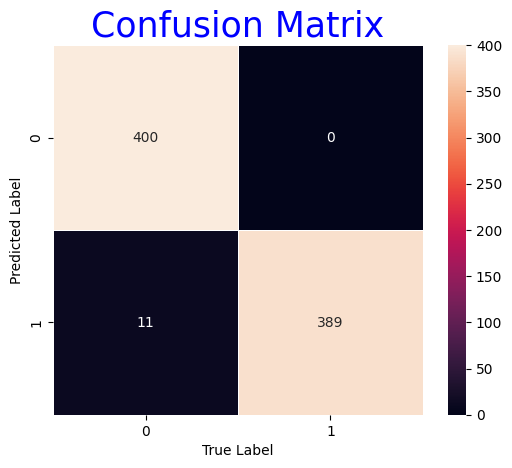

In [ ]:
# @title Train an SVM linear classifier for the normalized data

from sklearn.svm import SVC

# Define SVM model
svm_model = SVC(kernel='linear')  # Linear kernel for linear SVM
svm_model.fit(features_train_normalized, labels_train_normalized)

# Predict
svm_predictions = svm_model.predict(features_test_normalized)
print(f"SVM Predictions: {(svm_predictions == labels_test_normalized).sum()/len(labels_test_normalized)}")

confusion_matrix_score(labels_test_normalized, svm_predictions)

Logistic Regression Predictions: 1.0


The accuracy score is 100.0000%.

classification_report: 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       400
           1       1.00      1.00      1.00       400

    accuracy                           1.00       800
   macro avg       1.00      1.00      1.00       800
weighted avg       1.00      1.00      1.00       800




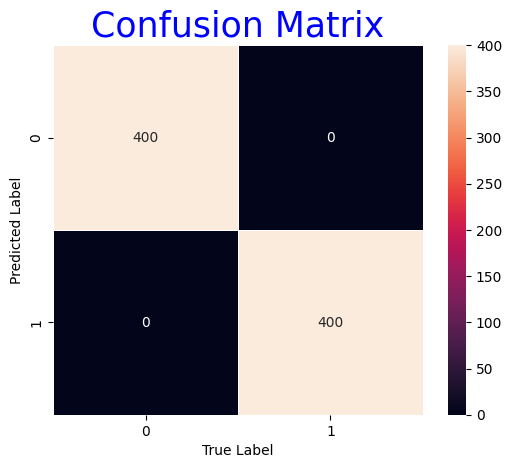

In [ ]:
# @title Train a Logistic Regression classifier with non normalized data

from sklearn.linear_model import LogisticRegression

# Define Logistic Regression model
log_reg_model = LogisticRegression()
log_reg_model.fit(features_train_not_normalized, labels_train_not_normalized)

# Predict
log_reg_predictions = log_reg_model.predict(features_test_not_normalized)

print(f"Logistic Regression Predictions: {(log_reg_predictions == labels_test_not_normalized).sum()/len(labels_test_not_normalized)}")

confusion_matrix_score(labels_test_not_normalized, log_reg_predictions)

Logistic Regression Predictions: 0.98


The accuracy score is 98.0000%.

classification_report: 
              precision    recall  f1-score   support

           0       0.96      1.00      0.98       400
           1       1.00      0.96      0.98       400

    accuracy                           0.98       800
   macro avg       0.98      0.98      0.98       800
weighted avg       0.98      0.98      0.98       800




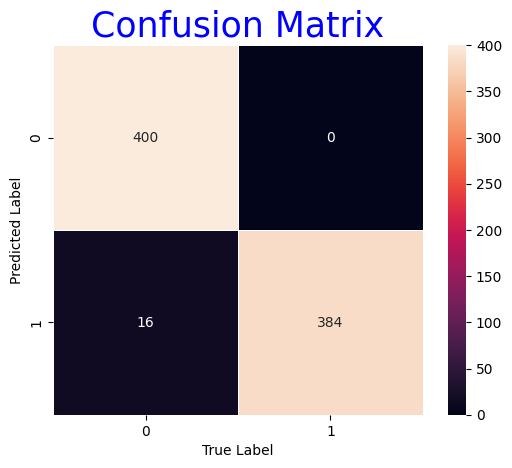

In [ ]:
# @title Train a Logistic Regression classifier with normalized data

from sklearn.linear_model import LogisticRegression

# Define Logistic Regression model
log_reg_model = LogisticRegression()
log_reg_model.fit(features_train_normalized, labels_train_normalized)

# Predict
log_reg_predictions = log_reg_model.predict(features_test_normalized)

print(f"Logistic Regression Predictions: {(log_reg_predictions == labels_test_normalized).sum()/len(labels_test_normalized)}")

confusion_matrix_score(labels_test_normalized, log_reg_predictions)

In [ ]:
# import matplotlib.pyplot as plt
# from sklearn.decomposition import PCA
# from mpl_toolkits.mplot3d import Axes3D

# pca = PCA(n_components=3, svd_solver='full')
# features_3d = pca.fit_transform(features)

# print(pca.explained_variance_ratio_)
# print(pca.singular_values_)
# print(f"Reduced Features Shape: {features_3d.shape}")

# # Create a 3D scatter plot
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')

# # Scatter plot with the first three principal components
# scatter = ax.scatter(features_3d[:, 0], features_3d[:, 1], features_3d[:, 2], c=labels, cmap='viridis')

# # Add labels and title
# ax.set_title('3D PCA Visualization')
# ax.set_xlabel('Principal Component 1')
# ax.set_ylabel('Principal Component 2')
# ax.set_zlabel('Principal Component 3')

# # Add a color bar
# colorbar = plt.colorbar(scatter, ax=ax)
# colorbar.set_label('Labels')

# # Show plot
# plt.show()


In [ ]:
# @title Apply PCA to reduce to 3 dimensions and plot the decision boundary by SVM with the data points

from sklearn.decomposition import PCA
import plotly.graph_objects as go

# Apply PCA to reduce to 3 dimensions
pca = PCA(n_components=3, svd_solver='full')
features_3d = pca.fit_transform(features_not_normalized)

print(f"Explained Variance: {pca.explained_variance_ratio_}")
print(f"Singular Values: {pca.singular_values_}")
print(f"Reduced Features Shape: {features_3d.shape}")

# Train a simple linear SVM classifier
clf = SVC(kernel='linear')
clf.fit(features_3d, labels_not_normalized)

# Create a mesh grid
x_min, x_max = features_3d[:, 0].min() - 1, features_3d[:, 0].max() + 1
y_min, y_max = features_3d[:, 1].min() - 1, features_3d[:, 1].max() + 1
z_min, z_max = features_3d[:, 2].min() - 1, features_3d[:, 2].max() + 1
xx, yy, zz = np.meshgrid(np.linspace(x_min, x_max, 50),
                         np.linspace(y_min, y_max, 50),
                         np.linspace(z_min, z_max, 50))

# Flatten the mesh grid and predict
grid = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
decision = clf.decision_function(grid)
decision = decision.reshape(xx.shape)

# Create a 3D scatter plot with Plotly
fig = go.Figure()

# Scatter plot with the first three principal components
scatter = go.Scatter3d(x=features_3d[:, 0], y=features_3d[:, 1], z=features_3d[:, 2],
                       mode='markers',
                       marker=dict(size=5, color=labels_not_normalized, colorscale='Viridis', opacity=0.8))

# Add the decision boundary as an isosurface
surface = go.Isosurface(x=xx.ravel(), y=yy.ravel(), z=zz.ravel(),
                        value=decision.ravel(),
                        isomin=-0.1, isomax=0.1,
                        surface_count=2, opacity=0.5,
                        colorscale='RdBu')

# Add scatter plot and surface to the figure
fig.add_trace(scatter)
fig.add_trace(surface)

# Set plot title and axis labels
fig.update_layout(title='3D PCA Visualization with Decision Boundary',
                  scene=dict(xaxis_title='Principal Component 1',
                             yaxis_title='Principal Component 2',
                             zaxis_title='Principal Component 3'))

# Show plot
fig.show()

Explained Variance: [0.98073398 0.01322589 0.00601761]
Singular Values: [246453.33212027  28620.12488189  19305.05072636]
Reduced Features Shape: (3999, 3)


We can see that taking the average of the dataset and using both the SVM and Logistic Regression models give us maximum accuracy of 100\% with the non normalized dataset. This is not surprising since we can see from the plot above that the dataset is linearly separable.

In [ ]:
# Let's also try the normalized data

from sklearn.decomposition import PCA
import plotly.graph_objects as go

# Apply PCA to reduce to 3 dimensions
pca = PCA(n_components=3, svd_solver='full')
features_3d = pca.fit_transform(features_normalized)

print(f"Explained Variance: {pca.explained_variance_ratio_}")
print(f"Singular Values: {pca.singular_values_}")
print(f"Reduced Features Shape: {features_3d.shape}")

# Train an SVM classifier
clf = SVC(kernel='linear')
clf.fit(features_3d, labels_normalized)

# clf = LogisticRegression()
# clf.fit(features_3d, labels_normalized)

# Create a mesh grid
x_min, x_max = features_3d[:, 0].min() - 1, features_3d[:, 0].max() + 1
y_min, y_max = features_3d[:, 1].min() - 1, features_3d[:, 1].max() + 1
z_min, z_max = features_3d[:, 2].min() - 1, features_3d[:, 2].max() + 1
xx, yy, zz = np.meshgrid(np.linspace(x_min, x_max, 50),
                         np.linspace(y_min, y_max, 50),
                         np.linspace(z_min, z_max, 50))

# Flatten the mesh grid and predict
grid = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
decision = clf.decision_function(grid)
decision = decision.reshape(xx.shape)

# Create a 3D scatter plot with Plotly
fig = go.Figure()

# Scatter plot with the first three principal components
scatter = go.Scatter3d(x=features_3d[:, 0], y=features_3d[:, 1], z=features_3d[:, 2],
                       mode='markers',
                       marker=dict(size=5, color=labels_normalized, colorscale='Viridis', opacity=0.8))

# Add the decision boundary as an isosurface
surface = go.Isosurface(x=xx.ravel(), y=yy.ravel(), z=zz.ravel(),
                        value=decision.ravel(),
                        isomin=-0.1, isomax=0.1,
                        surface_count=2, opacity=0.5,
                        colorscale='RdBu')

# Add scatter plot and surface to the figure
fig.add_trace(scatter)
fig.add_trace(surface)

# Set plot title and axis labels
fig.update_layout(title='3D PCA Visualization with Decision Boundary',
                  scene=dict(xaxis_title='Principal Component 1',
                             yaxis_title='Principal Component 2',
                             zaxis_title='Principal Component 3'))

# Show plot
fig.show()

Explained Variance: [0.98073398 0.01322589 0.00601761]
Singular Values: [6.19706319 0.71965236 0.48542504]
Reduced Features Shape: (3999, 3)


# Projective Geometric Algebra

In this section, we delve into the essential operations in $\mathbb{G}{3,0,1}$. The bivector $e_{01}$ is formed by combining the vectors $e_0$ and $e_1$ using the geometric product. This product, the primary operation between multivectors, consists of a symmetric part, known as the inner product $⟨⋅,⋅⟩$, and an antisymmetric part, the outer product ∧. The inner product measures similarity, while the outer product defines the subspace spanned by the two multivectors. For simplicity, we express the three operations as follows:

$xy = ⟨x,y⟩ + x∧y$

From this, we derive:

$⟨x,y⟩ = (xy+yx) / 2$ and $x∧y= (xy - yx) / 2$

In a simplified manner, one can view the inner product as analogous to the scalar product and the outer product as similar to the vector product. Specifically, we have:

$⟨e_i,e_j⟩ = δ_{ij}$ and $e_i ∧ e_i = 0$

which aligns with our usual understanding. In particular:

$vv = v^2 = ⟨v,v⟩ + v∧v = ⟨v,v⟩$

indicating that the square of a vector is its squared norm. In the algebra $\mathbb{G}_{3,0,1}$, the indices 3, 0, 1 signify three vectors with norm 1 and one vector with norm 0. Thus:

$e_0^2 = 0, e_1^2 = e_2^2 = e_3^2 = 1$

We observe that the geometric product is antisymmetric:

$(e_i + e_j)^2 = ⟨e_i + e_j, e_i + e_j⟩ = e_i^2 + e_j^2 + ⟨e_i, e_j⟩ + ⟨e_j, e_i⟩$

therefore:

$⟨e_i, e_j⟩ + ⟨e_j, e_i⟩ = e_ie_j + e_je_i = (e_i + e_j)^2 - e_i^2 - e_j^2 = 0$

The 16-dimensional basis vectors space summary is as follows:

* **Scalar** {1} -- Grade 0
* **Vectors** {$e_0, e_1, e_2, e_3$} -- Grade 1
* **Bivector** {$e_{01}, e_{02}, e_{03}, e_{12}, e_{13}, e_{23}$} -- Grade 2
* **Trivectors** {$e_{012}, e_{013}, e_{023}, e_{123}$} --  Grade 3
* **Pseudoscalar** {$e_{0123}$}: -- Grade 4

As can be seen when computing the geometric product or outer product of 2 multivectors, we need to compute these values for the basis vectors. The authors have provided precomputed tables containing these values. We'll use them for faster computations.

The structure of these tables is the following:

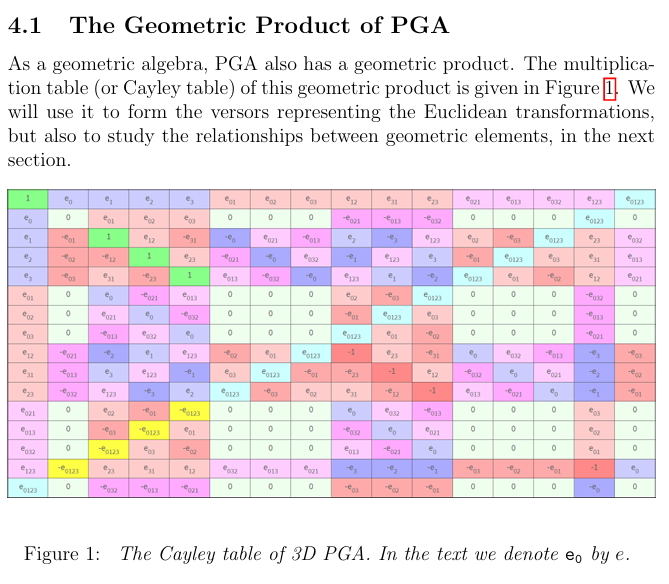


The shape of these tables is 16x16x16. The last 2 dimensions can be seen in the table above. The first dimension is there because each basis vector is a 16-dimensional multivector itself.

## Geometric Product

The two multivectors can be shown as:

$\textbf{x} = x_0 + x_1e_0 + x_2e_1 + ... x_{15}e_{0123}$

$\textbf{y} = y_0 + y_1e_0 + y_2e_1 + ... y_{15}e_{0123}$

The gemoteric product of these two multivectors is:

$\textbf{x}\textbf{y} = (x_0 + x_1e_0 + x_2e_1 + ... x_{15}e_{0123})(y_0 + y_1e_0 + y_2e_1 + ... y_{15}e_{0123})$

We can think of this as the multiplication of matrices. If we put all the coefficients of $\textbf{x}$ in a column vector and all the coefficients of $\textbf{y}$ in a row vector, we'll have:

$\textbf{x}_{\text{coeff}} = [x_0, x_1, x_2, ..., x_{15}]^T$

$\textbf{y}_{\text{coeff}} = [y_0, y_1, y_2, ..., y_{15}]$

The matrix multiplication of these vectors results in a 16x16 matrix:

$\textbf{x}_{\text{coeff}} \times \textbf{y}_{\text{coeff}} = \begin{bmatrix}x_0y_0 & x_0y_1 & x_0y_2 & ... & x_0y_{15} \\ x_1y_0 & x_1y_1 & x_1y_2 & ... & x_1y_{15} \\ x_2y_0 & x_2y_1 & x_2y_2 & ... & x_2y_{15} \\ ... & ... & ... & ... & ... \\ x_{15}y_0 & x_{15}y_1 & x_{15}y_2 & ... & x_{15}y_{15}\end{bmatrix}$

The only thing that remains is the element-wise multiplication of this matrix with the respective geometric product of the basis multivectors in the precomputed geometric product table.

The sum of the resulting matrix is the result of the geometric product of the two multivectors $\textbf{x}$ and $\textbf{y}$.

Mathematically, the operation can be written as:

$D_{...,i} = ∑_{j,k}A_{i,j,k}B_{...,j}C_{...,k}$

Where D is the resulting tensor with dimensions ($...,i$) and the "$...$" are the preceding dimensions (batch_size).

Example of computing the geometric product of two vectors a and b in 3D Euclidean space:
- Let a = a₁e₁ + a₂e₂ + a₃e₃ and b = b₁e₁ + b₂e₂ + b₃e₃, where e₁, e₂, and e₃ are the basis vectors.
- The geometric product $a \cdot b$ can be computed as:
\begin{align}
a * b &= (a₁e₁ + a₂e₂ + a₃e₃) * (b₁e₁ + b₂e₂ + b₃e₃) \\
&= (a₁b₁)(e₁ * e₁) + (a₁b₂)(e₁ * e₂) + (a₁b₃)(e₁ * e₃) + (a₂b₁)(e₂ * e₁) + (a₂b₂)(e₂ * e₂) + (a₂b₃)(e₂ * e₃) + (a₃b₁)(e₃ * e₁) + (a₃b₂)(e₃ * e₂) + (a₃b₃)(e₃ * e₃) \\
&= (a₁b₁) + (a₂b₂) + (a₃b₃) + (a₁b₂ - a₂b₁)e₂₃ + (a₁b₃ - a₃b₁)e₃₁ + (a₂b₃ - a₃b₂)e₁₂
\end{align}
Here, e₂₃, e₃₁, and e₁₂ are the bivector basis elements representing the oriented areas in the e₂-e₃, e₃-e₁, and e₁-e₂ planes, respectively.


Let's see how **Geometric Product** works with 2D points a and b below.

In [ ]:
# @title Geometric Product example with 2D
# Define two 2D vectors
a = torch.tensor([2, 3])
b = torch.tensor([1, 4])

# Compute the inner product (dot product)
inner_product = torch.dot(a, b)
print("Inner product:", inner_product.item())

# Compute the outer product (wedge product)
outer_product = torch.linalg.cross(torch.tensor([a[0], a[1], 0]), torch.tensor([b[0], b[1], 0]))
print("Outer product:", outer_product)

# Combine inner and outer products to get the geometric product
geometric_product = inner_product + outer_product[2]

print("Geometric product:", geometric_product.item())


Inner product: 14
Outer product: tensor([0, 0, 5])
Geometric product: 19


In this project, however, we will download and use the saved tensors of the basis for both the Geometric Product and the Outer Product done by the authors in .pt files. See their github repo for more details.

In [ ]:
# @title Download geometric product and outer product
!gdown $config.geo_product_link
!gdown $config.outer_product_link

Downloading...
From: https://drive.google.com/uc?id=18J-CCR6ahySuN8lEBHQGCw-_mz3FZtg-
To: /content/geometric_product.pt
100% 5.97k/5.97k [00:00<00:00, 18.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1vDKBfAzn3qvKRoRspTl1YpspbG1xRiM7
To: /content/outer_product.pt
100% 3.13k/3.13k [00:00<00:00, 11.8MB/s]


In [ ]:
# @title Geometric Product calculation

# From the authors: Loads basis elements for Pin-equivariant bilinear maps between multivectors.
config.geo_product = torch.load("geometric_product.pt", map_location=config.device).to(torch.float32)

# kernel matrix for geometric product
# Convert to dense because einsum is not defined for sparse tensors
config.geo_product = config.geo_product.to_dense()

def geometric_product(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    """This function calculates the geometric product of two multivectors x and y
    using a precomputed geometric product table as f(x,y) = x.y + x^y.

    Note that this is adapted from the author's

    Parameters
    ----------
    x : torch.Tensor with shape (..., 16)
        First input multivector. Batch dimensions must be broadcastable between x and y.
    y : torch.Tensor with shape (..., 16)
        Second input multivector. Batch dimensions must be broadcastable between x and y.

    Returns
    -------
    outputs : torch.Tensor with shape (..., 16)
        Result. Batch dimensions are result of broadcasting between x, y, and coeffs.
    """

    # Compute geometric product
    return torch.einsum("i j k, ... j, ... k -> ... i", config.geo_product, x, y)


In [ ]:
x = torch.rand((2, 3, 3, 16), device=config.device)
y = torch.rand((2, 3, 3, 16), device=config.device)

geometric_product(x, y).shape

torch.Size([2, 3, 3, 16])

## Outer Product

The same explanation as the geometric product except that we use the precomputed outer product table of the basis multivectors here.

In [ ]:
# From the authors: Loads basis elements for Pin-equivariant bilinear maps between multivectors.
config.outer_product = torch.load("outer_product.pt", map_location=config.device).to(torch.float32)

# kernel matrix for geometric product
# Convert to dense because einsum is not defined for sparse tensors
config.outer_product = config.outer_product.to_dense()

@lru_cache()
def outer_product(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    """
    Computes the outer product of two tensors using predefined tables.

    This function calculates the outer product, a key operation in
    geometric algebra, between two tensors based on a preloaded
    multiplication table.

    Parameters:
        x (torch.Tensor): The first operand tensor, represented in a specific
                          geometric algebra.
        y (torch.Tensor): The second operand tensor, similar to `x`.

    Returns:
        torch.Tensor: Result of the outer product between `x` and `y`.
    """

    # Compute geometric product
    return torch.einsum("i j k, ... j, ... k -> ... i", config.outer_product, x, y)


In [ ]:
x = torch.rand((2, 3, 3, 16), device=config.device)
y = torch.rand((2, 3, 3, 16), device=config.device)

outer_product(x, y).shape

torch.Size([2, 3, 3, 16])

## Reverse

The reverse of a multivector in geometric algebra is analogous to taking the transpose of a matrix. For a general multivector $A$, which can be expressed as a sum of blades (elements that span the vector space), the reverse is defined by reversing the order of the basis vectors in each blade.

For a k-blade $A = a_1 ∧ a_2 ∧ ... ∧ a_k$ where ∧ denotes the outer product, the reverse $\tilde{A}$ is given by:

$\tilde{A} = a_k ∧ a_{k-1} ∧ ... ∧ a_1$

This effectively changes the sign based on the number of swaps needed to reorder the basis vectors into the reverse order. Specifically:

* For a scalar (0-blade), the reverse is the same scalar.
* For a vector (1-blade), the reverse is the same vector.
* For a bivector (2-blade) $a ∧ b$, the reverse is $b ∧ a = -a ∧ b$.

In general, for an n-blade, the reverse introduces a sign change of $(-1)^{k(k−1)/2}$, where k is the grade (dimension) of the blade.

In our case that we have grades 0, 1, 2, 3, and 4, the grades 0, 1, and 4 don't need to change the sign, but the grades 2 and 3 need to change their sign.

In [ ]:
def reverse(x):
    """
    This function reverses the multivector by changing the sign of specific
    components.

    Parameters:
    x (torch.Tensor):   A tensor representing the multivector. It should have a
                        shape of (batch_size, 16).

    Returns:
    torch.Tensor:   A tensor representing the reversed multivector. It has a
                    shape of (batch_size, 16).
    """

    # Create a tensor of ones with the same shape as the multivector
    sign = torch.ones(16, device=x.device)

    # Change the sign of components 0 to 4 to -1
    sign[0:5] = -1

    # Change the sign of components 5 to 14 to -1 (Python uses 0-based indexing)
    sign[5:15] = -1

    # Element-wise multiplication of the input multivector with the sign tensor
    reverse = sign * x

    # Return the resulting reversed multivector
    return reverse

In [ ]:
x = torch.rand((2, 10, 3, 16), device=config.device)

reverse(x).shape

torch.Size([2, 10, 3, 16])

## Inner Product

The inner product in Projective Geometric Algebra (PGA) is an essential operation that generalizes the dot product from vector algebra to the context of multivectors. It is used to measure the "overlap" between elements and has various forms depending on the types of multivectors involved.

In a traditional inner product we just compute the sum of the element-wise product of the two vectors because the basis vectors have norm 1. However, here one of the basis vectors ($e_0$) has norm 0, and therefore has no effect in the calculation of the output.

Knowing this, we can just mask the vectors in a way to ignore the components having $e_0$ in them. These are:

$e_0, e_{01}, e_{02}, e_{03}, e_{012}, e_{013}, e_{023}, e_{0123}$

Mathematically, the operation can be written as:

$C_{...} = ∑_i A_{...,i}B_{...,i}$

Where C is the resulting tensor with dimensions "$...$" and the "$...$" are the preceding dimensions (batch_size).

In [ ]:
def inner_product(x, y):
    """
    This function calculates the inner product of two multivectors, x and y,
    using a specific mask to select relevant components.

    Parameters:
    x (torch.Tensor):   A tensor representing the first batch of multivectors.
                        It should have a shape of (batch_size, 16).
    y (torch.Tensor):   A tensor representing the second batch of multivectors.
                        It should have a shape of (batch_size, 16).

    Returns:
    torch.Tensor:   A tensor representing the inner product of the input
                    multivectors. It has a shape of (batch_size, 1).
    """

    # Define a mask to select specific components for the inner product
    # calculation
    mask = [True, False, True, True, True, False, False, False, True, True, True, False, False, False, True, False]

    # Apply the mask to the input tensors to select relevant components
    x_masked = x[..., mask]
    y_masked = y[..., mask]


    # Perform batch multiplication to compute the inner product
    ip = torch.einsum("... i, ... i -> ...", x_masked, y_masked)

    # Unqueeze the last dimension to get the final result
    return ip.unsqueeze(-1)

In [ ]:
x = torch.rand((2, 10, 3, 16), device=config.device)
y = torch.rand((2, 10, 3, 16), device=config.device)

inner_product(x, y).shape

torch.Size([2, 10, 3, 1])

## Norm

The norm can be computed as the square root of the inner product of the multivector with itself.

$||\textbf{x}|| = \sqrt{⟨x, x⟩}$

In [ ]:
def norm(x):
    """
    This function calculates the norm (magnitude) of a multivector using the
    inner product.

    Parameters:
    x (torch.Tensor):   A tensor representing the multivector. It should have a
                        shape of (..., 16).

    Returns:
    torch.Tensor:   A tensor representing the norm of the input multivector.  It
                    has a shape of (..., 1).
    """

    # Calculate the inner product of the multivector with itself
    inner_prod = inner_product(x, x)

    # Clamp the inner product to avoid negative values due to numerical
    # precision
    inner_prod_clamped = torch.clamp(inner_prod, 0)

    # Take the square root of the clamped inner product to get the norm
    n = torch.sqrt(inner_prod_clamped)

    # Return the norm
    return n

In [ ]:
x = torch.rand((2, 10, 3, 16), device=config.device)

norm(x).shape

torch.Size([2, 10, 3, 1])

## Dual

In Projective Geometric Algebra (PGA), the dual operator is a fundamental tool used to represent duality relationships between geometric elements. In PGA, geometric elements such as points, lines, and planes are represented by multivectors in a higher-dimensional space. The dual operator allows you to transform between these representations.

The dual space in PGA is constructed such that each geometric element corresponds to a unique dual element. For example, a point in the primal space corresponds to a plane in the dual space, a line corresponds to a point, and a plane corresponds to a point as well.

The dual operator, denoted by the symbol *, is applied to a multivector to compute its dual. For instance, if you have a multivector representing a point in the primal space, applying the dual operator to it will yield the corresponding plane in the dual space.

The dual operator essentially reflects geometric elements across the duality relationship between the primal and dual spaces. For example, if you have a line in the primal space, its dual, obtained by applying the dual operator, will be the point that represents the line in the dual space.

It acts on basis elements by swapping “empty” and “full” dimensions.

|||
|-|-|
|$1^* = e_{0123}$|$e_{0123}^* = 1$|
|$e_0^* = e_{123}$|$e_{123}^* = -e_0$|
|$e_1^* = -e_{023}$|$e_{023}^* = e_1$|
|$e_2^* = e_{013}$|$e_{013}^* = -e_2$|
|$e_3^* = -e_{012}$|$e_{012}^* = e_3$|
|$e_{01}^* = e_{23}$|$e_{23}^* = e_{01}$|
|$e_{02}^* = -e_{13}$|$e_{13}^* = -e_{02}$|
|$e_{03}^* = e_{12}$|$e_{12}^* = e_{03}$|

In [ ]:
def dual(x):
    """
    This function computes the dual of a multivector using a predefined sign
    pattern.

    Parameters:
    x (torch.Tensor):   A tensor representing the input multivector. It should
                        have a shape of (batch_size, 16).

    Returns:
    torch.Tensor:   A tensor representing the dual of the input multivector. It
                    has the same shape as the input tensor.
    """

    # Define positions for reversing the order of elements
    positions = torch.arange(15, -1, -1, device=x.device)

    # Define the sign pattern for the dual operation
    sign = torch.tensor([1, -1, 1, -1, 1, 1, -1, 1, 1, -1, 1, -1, 1, -1, 1, 1], device=x.device)

    # Reverse the order of elements in each multivector using positions and
    # apply the sign pattern
    x_star = sign * x[..., positions]

    # Return the dual of the input multivector
    return x_star

In [ ]:
x = torch.rand((2, 10, 3, 16), device=config.device)

dual(x).shape

torch.Size([2, 10, 3, 16])

## Join

The **meet** intersects planes to produce reduced elements like lines and points. We also want to construct elements by merging elements, such as permitting two points to determine a line. That operation is called the **join**. It is a union, linearized in similar fashion to how the meet linearize intersection. In fact, the two operations are dual to each other.

The **join** was designed to be dual to the **meet**. In PGA, where ∧ is an intersection, it is customary to denote the **join** by a ∨.

We should define the **join** as:

$A ∨ B = (A^* ∧ B^*)^*$

To ensure that the operation performed remains consistent regardless of whether the input undergoes even or odd transformations, we modify the operation. Specifically, we incorporate the pseudoscalar part (which captures orientation information) of a reference multivector. This reference multivector is derived as the mean of all input data points fed in. By doing so, we ensure that the operation maintains consistency across different transformations of the input data.

In [ ]:
def equivariant_join(x, y, ref):
    """
    This function computes the join of two multivectors using a reference
    multivector and an outer product table.

    Parameters:
    x (torch.Tensor):   A tensor representing the first batch of multivectors.
                        It should have a shape of (batch_size, 16).
    y (torch.Tensor):   A tensor representing the second batch of multivectors.
                        It should have a shape of (batch_size, 16).
    ref (torch.Tensor): A tensor representing the reference multivector. It
                        should have a shape of (batch_size, 16).

    Returns:
    torch.Tensor:   A tensor representing the join of the input multivectors. It
                    has a shape of (batch_size, 16).
    """

    # Compute the dual of the first input multivector
    dual_x = dual(x)

    # Compute the dual of the second input multivector
    dual_y = dual(y)

    # Compute the outer product of the dual multivectors
    outer_prod = outer_product(dual_x, dual_y)

    # Compute the dual of the outer product
    dual_outer_prod = dual(outer_prod)

    # Extract the pseudoscalar component (the 16th component) of the reference
    # multivector
    ref_pseudoscalar = ref[..., [15]]

    # Multiply the pseudoscalar component by the dual of the outer product to
    # get the join
    result = ref_pseudoscalar * dual_outer_prod

    # Return the resulting join multivector
    return result

In [ ]:
x = torch.rand((2, 10, 3, 16), device=config.device)
y = torch.rand((2, 10, 3, 16), device=config.device)
ref = torch.rand((2, 10, 3, 16), device=config.device)

equivariant_join(x, y, ref).shape

torch.Size([2, 10, 3, 16])

## Equivariance

In geometric algebra, a vector $u$ can act as an operator, reflecting other elements in the hyperplane orthogonal to $u$. Since any orthogonal transformation is equal to a sequence of reflections, this allows us to express any such transformation as a geometric product of (unit) vectors, called a (unit) versor $u = u_1 ... u_k$. Furthermore, since the product of unit versors is a unit versor, and unit vectors are their own inverse ($u^2 = 1$), these form a group called the Pin group associated with the metric. Similarly, products of an even number of reflections form the Spin group. In the projective geometric algebra $G_{3,0,1}$, these are the double cover of E(3) and SE(3), respectively. We can thus represent any rotation, translation, and mirroring—the symmetries of three- dimensional space as $G_{3,0,1}$ multivectors

#### Grade Involution

Grade involution $\hat{x}$, flips the sign of odd-grade elements such as vectors and trivectors, while leaving even-grade elements unchanged.

In [ ]:
def grade_involution(x):
    """
    This function applies the grade involution to a batch of multivectors. Grade
    involution changes the sign of multivector components based on their grade
    (even or odd).

    Parameters:
    x (torch.Tensor):   A tensor representing a batch of multivectors. It should
                        have a shape of (batch_size, 16).

    Returns:
    torch.Tensor:   A tensor representing the batch of multivectors after
                    applying the grade involution. It has the same shape as the
                    input tensor.
    """

    # Create a sign tensor initialized to ones, with the same shape as the input
    # tensor
    sign = torch.ones(16, device=x.device)

    # Set specific positions to -1 to indicate the components whose sign will be
    # flipped
    sign[[1, 2, 3, 4, 11, 12, 13, 14]] = -1

    # Apply the sign tensor to the input tensor to perform the grade involution
    involution = sign * x

    # Return the resulting tensor after grade involution
    return involution

In [ ]:
x = torch.rand((2, 10, 3, 16), device=config.device)

grade_involution(x).shape

torch.Size([2, 10, 3, 16])

In [ ]:
# Check that reverse is close to the inverse

# Generate random versor u
i = np.random.randint(5)
vector = torch.zeros(16, device=config.device)
u = torch.zeros(16, device=config.device)
u[0] = 1
for _ in range(i):
    vector[1:5] = torch.rand(4, device=config.device)
    normalization = norm(vector)
    vector = vector / normalization
    u = geometric_product(u, vector)

geometric_product(u, reverse(u))

tensor([-0.9664,  0.0000,  0.0000,  0.0000,  0.0000, -0.1797,  0.3775,  0.4404,
         0.0035, -0.1072,  0.2338,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000],
       device='cuda:0')

#### Sandwich Product

In order to apply a versor $u$ to an arbitrary element $x$, one uses the sandwich product:

$\rho_u(x) = \begin{cases}uxu^{-1} & \text{if $u$ is even} \\ u\hat{x}u^{-1} & \text{if $u$ is odd}\end{cases}$

This gives us a linear action (i.e. group representation) of the Pin and Spin groups on the 2d-dimensional space of multivectors. The sandwich product is grade-preserving, so this representation splits into a direct sum of representations on each grade.

The inverse of $u$ is given by $u^{-1} = \dfrac{\tilde{u}}{u \tilde{u}}$; but in PGA the denominator is always positive, so we can replace the inverse with the reverse.

In [ ]:
def sandwich_product(x, u, seq_len):
    """
    This function computes the sandwich product of a multivector `x` with a
    versor `u`. The result depends on whether `seq_len` is even or odd.

    Parameters:
    x (torch.Tensor):   A tensor representing the input multivector. It should
                        have a shape of (batch_size, 16).
    u (torch.Tensor):   A tensor representing the versor used for the sandwich
                        product. It should have a shape of (batch_size, 16).
    seq_len (int):  An integer representing the sequence length of `u`.
                    Determines the computation method.

    Returns:
    torch.Tensor:   A tensor representing the sandwich product of the input
                    multivector `x`. It has the same shape as the input tensor.
    """

    if seq_len % 2 == 0:
        # Compute the sandwich product for even seq_len
        sandwich_product = geometric_product(geometric_product(u, x), reverse(u))
    else:
        # Compute the sandwich product for odd seq_len
        sandwich_product = geometric_product(geometric_product(u, grade_involution(x)), reverse(u))

    return sandwich_product

#### Check Operations Equivariance

Here we test the equivariance of a given operation under geometric transformations. Equivariance, in this context, means that applying a transformation before the operation yields the same result as applying the operation and then the transformation.

We first compute the transformation on the two multivectors and then apply the operation on them.

Then, we apply the operation on the multivectors and then compute the transformation.

If the distance between these two values is near 0, we have high equivariance.

**Spin transformations** are closely related to rotations in space. They are represented by elements called spinors in geometric algebra.
* A spinor is a multivector that can be used to represent rotations in any dimension.
* Spin transformations preserve the orientation and magnitude of vectors.
* They are associated with even-grade multivectors in geometric algebra.

**Pin transformations** include both rotations and reflections and are represented by pinors.
* A pinor is a multivector that can represent both rotations and reflections.
* Pin transformations include both spin transformations (rotations) and reflections.
* They can be associated with both even and odd-grade multivectors in geometric algebra.

In [ ]:
def check_operation_equivariance(x, y, operation, reference=None, spin=False):
    """
    This function checks the equivariance of a given operation with respect to a
    random transformation.

    Parameters:
    x (torch.Tensor):   A tensor representing the first batch of multivectors.
                        It should have a shape of (batch_size, 16).
    y (torch.Tensor):   A tensor representing the second batch of multivectors.
                        It should have a shape of (batch_size, 16).
    operation (function):   A function representing the operation to be checked
                            for equivariance.
    reference (torch.Tensor, optional): A tensor representing a reference
                                        multivector used in the operation.
                                        Default is None.
    spin (bool, optional):  A boolean indicating whether to use spin
                            transformations (true) or not (false). Default is
                            False.

    Returns:
    float:  A scalar value representing the deviation between the transformed
            and directly computed results, indicating the degree of equivariance.
    """

    # Determine the number of iterations based on the spin flag
    if spin:
        i = np.random.randint(3) * 2
    else:
        i = np.random.randint(5)

    # Initialize a zero vector and a unit scalar multivector
    vector = torch.zeros(16, device=x.device)
    u = torch.zeros(16, device=x.device)
    u[0] = 1  # Set the scalar part to 1

    # Construct the transformation multivector `u` through `i` iterations
    for _ in range(i):
        vector[1:5] = torch.rand(4, device=x.device) # no need for rng
        normalization = norm(vector)
        vector = vector / normalization
        u = geometric_product(u, vector)

    # Apply the transformation to x and y, then apply the operation
    if reference is not None:
        out1 = operation(sandwich_product(x, u, i), sandwich_product(y, u, i), reference)
        out2 = sandwich_product(operation(x, y, reference), u, i)
    else:
        out1 = operation(sandwich_product(x, u, i), sandwich_product(y, u, i))
        out2 = sandwich_product(operation(x, y), u, i)

    # Compute the deviation between the two results
    deviation = torch.norm(out1 - out2)

    # Return the deviation as a scalar
    return deviation.item()

The geometric product is pin-equivariant. This can be seen by the low values of deviation below. Note that, if an operation is pin-equivariant, it's spin-equivariant as well and we don't need to check the results for that as well.

In [ ]:
# Geometric product
x = torch.rand((2, 10, 3, 16), device=config.device)
y = torch.rand((2, 10, 3, 16), device=config.device)

print("Pin Equivariance:")
for i in range(5):
    d = check_operation_equivariance(x, y, geometric_product)
    print(d)

Pin Equivariance:
67.42532348632812
137.5663604736328
83.17679595947266
25.114900588989258
89.88720703125


The outer product is also pin-equivariant.

In [ ]:
# Outer product
x = torch.rand((2, 10, 3, 16), device=config.device)
y = torch.rand((2, 10, 3, 16), device=config.device)

print("Pin Equivariance:")
for i in range(5):
    d = check_operation_equivariance(x, y, outer_product)
    print(d)

Pin Equivariance:
22.009674072265625
67.10066986083984
54.025245666503906
22.011354446411133
54.938289642333984


The inner product is not equivariant at all. It can be seen below that the deviations are large not only for pin equivariance but also for spin equivariance.

In [ ]:
# Inner product
x = torch.rand((2, 10, 3, 16), device=config.device)
y = torch.rand((2, 10, 3, 16), device=config.device)

print("Pin Equivariance:")
for i in range(5):
    d = check_operation_equivariance(x, y, inner_product)
    print(d)

print("Spin Equivariance:")
for i in range(5):
    d = check_operation_equivariance(x, y, inner_product, spin=True)
    print(d)

Pin Equivariance:
123.99042510986328
82.71419525146484
131.18580627441406
98.12620544433594
105.14469909667969
Spin Equivariance:
115.05770874023438
133.05787658691406
94.97514343261719
129.70046997070312
96.87574768066406


The join operation is spin-equivariant.

In [ ]:
# Join
x = torch.rand((2, 10, 3, 16), device=config.device)
y = torch.rand((2, 10, 3, 16), device=config.device)
ref = torch.mean(x + y, dim=0, keepdim=True)

print("Pin Equivariance:")
for i in range(5):
    d = check_operation_equivariance(x, y, equivariant_join, ref)
    print(d)

print("\nSpin Equivariance:")
for i in range(5):
    d = check_operation_equivariance(x, y, equivariant_join, ref, spin=True)
    print(d)

Pin Equivariance:
5.783989763585851e-06
8.911750793457031
7.981007099151611
83.91592407226562
4.24842028223793e-06

Spin Equivariance:
42.59150314331055
48.593929290771484
57.00264358520508
53.141910552978516
57.104496002197266


#### Check Layer Equivariance

In [ ]:
def check_layer_equivariance(mv: torch.Tensor, layer, reference=None, spin=False):
    """
    We create a random Pin-transformation u and we test the equivariance of the layer.
    """

    if spin is True:
        i = np.random.randint(3) * 2
    else:
        i = np.random.randint(5)

    vector = torch.zeros(16, device=mv.device)
    u = torch.zeros(16, device=mv.device)
    u[0] = 1

    for _ in range(i):
        vector[1:5] = torch.rand(4, device=mv.device)
        normalization = norm(vector)
        vector = vector / normalization
        u = geometric_product(u, vector)

    if reference is not None:
        out1 = layer(sandwich_product(mv, u, i), reference)[0]
        out2 = sandwich_product(layer(mv, reference)[0], u, i)
    else:
        out1 = layer(sandwich_product(mv, u, i))[0]
        out2 = sandwich_product(layer(mv)[0], u, i)

    distance = torch.norm(out1 - out2)

    return distance.item()

# Embedding into PGA

Here, we're working in the 3D PGA environment which is equal to the linear space of planes. In the linear space of planes, we have 4 basis vectors. 3 representing the 3 orthogonal planes through the origin, and a 4th representing the plane at infinity.

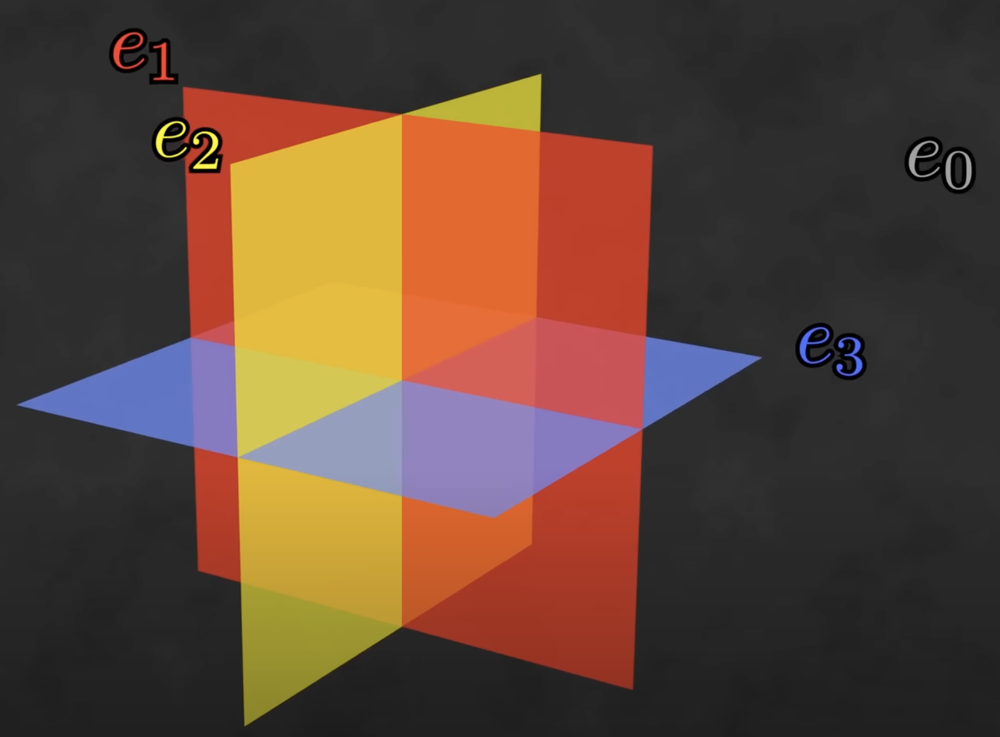

The geometric product of different basis vector anticommutes: $e_ie_j = -e_je_i (i \ne j)$

The geometric product of each basis vector with itself is its magnitude:

$e_1^2 = 1, e_2^2 = 1, e_3^2 = 1, e_0^2 = 0$

In 3D PGA we have scalars ($1$), vectors with 4 components ($e_1, e_2, e_3, e_0$) which represent planes, bivectors with 6 components ($e_{01}, e_{02}, e_{03}, e_{12}, e_{13}, e_{23}$) which represent 2-dimensional sub-spaces of planes, trivectors with 4 components ($e_{012}, e_{013}, e_{023}, e_{123}$) which represent 3-dimensional sub-spaces of planes, and pseudoscalars with 1 component ($e_{0123}$).

As said before, bivectors are 2-dimensional sub-spaces of planes. Let's consider the span of 2 planes. The span of these 2 planes is all of the planes that pass through the intersection of the 2 planes. These planes are uniquely determined by the line all of the planes pass through. Let's just say that this bivector simply is the line.

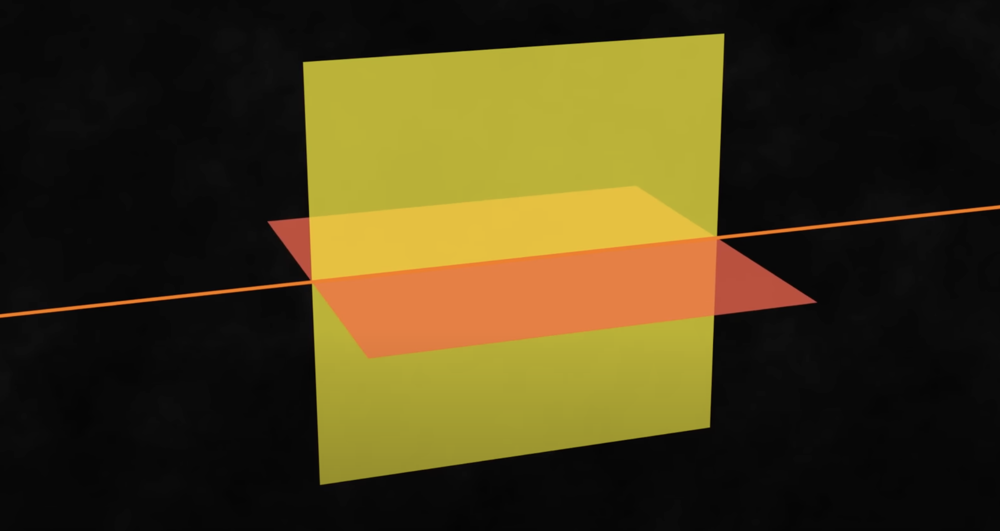

Similarly, for trivectors, we need to understand the span of 3 planes. Using the same arguments as before, we can see that the span of 3 planes is the all of the planes passing through the intersection point of the 3 planes. Again, this set of planes is uniquely determined by the point they all pass through. Let's say that the trivector is the point.

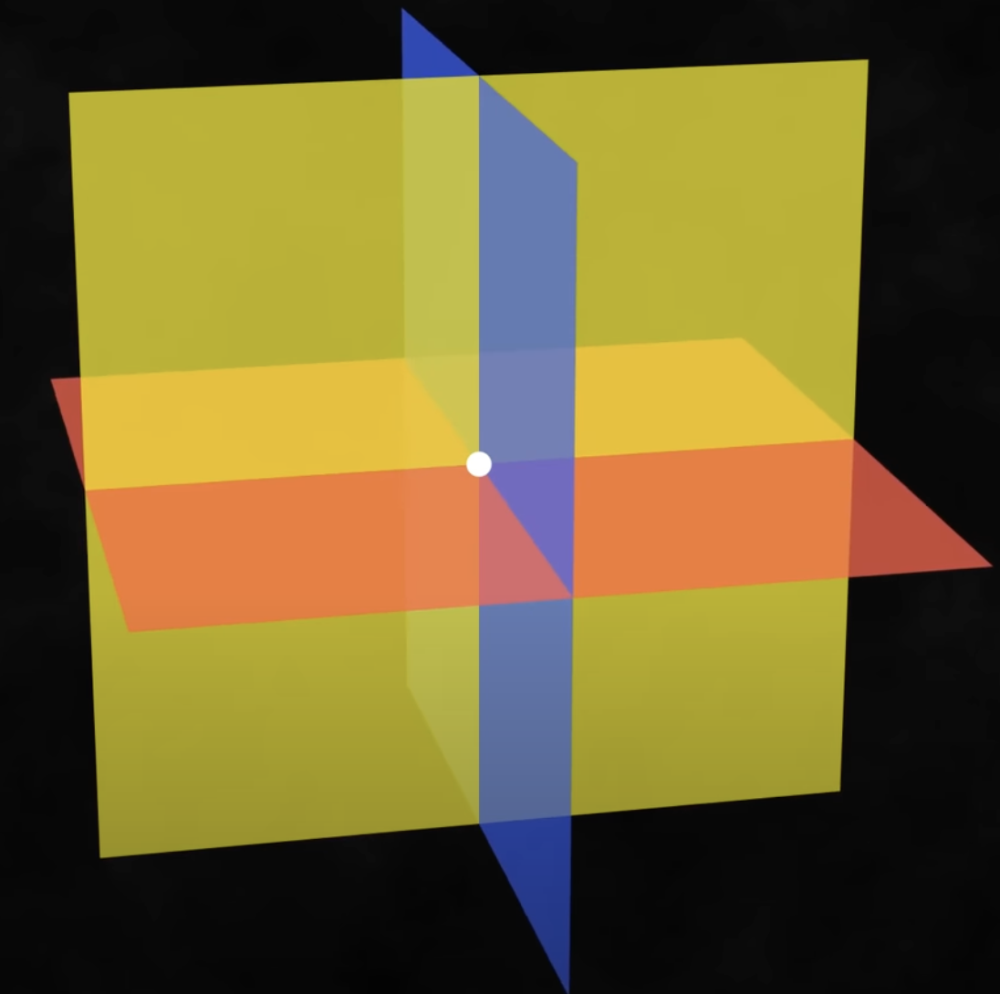

In summary, we see that in 3D PGA, vectors are planes, bivectors are lines, and trivectors are points.

An embedding in $G_{3,0,1}$ is a mapping from a lower-dimensional geometric space into a higher-dimensional space, preserving certain algebraic properties and geometric relationships. These embeddings are typically achieved through the use of multivectors, which encode both scalar and multivectorial information within a single mathematical object.

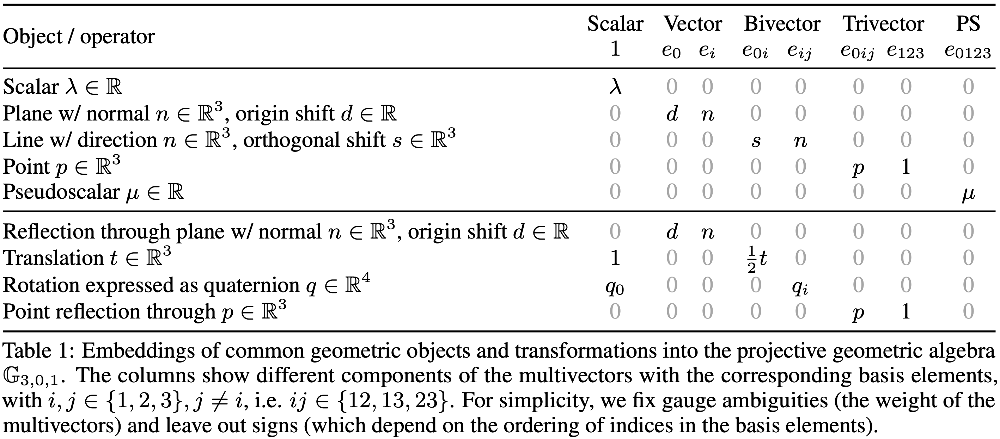

## 1. Embed Scalars

A scalar $λ ∈ R$ becomes a multivector given by $[λ, 0, ..., 0]$

In [ ]:
def embed_scalars(scalars):
    """
    This function embeds scalar values into a 16-dimensional space using
    geometric algebra.

    Parameters:
    scalars (torch.Tensor): A tensor containing scalar values. It should have a
                            shape of (batch_size,).

    Returns:
    torch.Tensor:   A tensor containing the embedded scalars represented as
                    16-dimensional multivectors. It has a shape of
                    (batch_size, 16).
    """

    # Get the batch shape of the input tensor
    batch_shape = scalars.shape[:-1]

    # Create a tensor to hold the multivectors with shape (..., 16)
    multivectors = torch.zeros((*batch_shape, 15), device=scalars.device)

    # Embedding the scalars into the multivectors
    # The scalar values are assigned to the 0th component of the multivectors

    # Assign the scalar values to the 0th component of the multivectors
    multivectors = torch.cat([scalars, multivectors], dim=-1)

    # Return the resulting multivectors
    return multivectors

In [ ]:
x = torch.rand((2, 2, 1), device=config.device)
embed_scalars(x)

tensor([[[0.4283, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.6204, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],

        [[0.4465, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
         [0.7985, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]]],
       device='cuda:0')

## 2. Embed Planes

Given a plane with unit normal vector $\textbf{n}$ at directed distance $\delta$ from the origin (measured in the direction $\textbf{n}$, so $\delta\textbf{n}$ is a location on the plane), we pick as the homogeneous representative the vector

$\textbf{n} + \delta e_0 = \delta e_0 + n_1e_1 + n_2e_2 + n_3e_3$

In our case, given a face with 3 points P, Q, R the normal is $\textbf{n} = \vec{PQ} × \vec{PR}$ and the shift is $\delta = \textbf{n} \cdot P$.

See the book for more details.

In [ ]:
def embed_planes(faces, points):
    """
    This function embeds planes defined by three points into a 16-dimensional
    space using geometric algebra.

    Parameters:
    faces (torch.Tensor):   A tensor containing indices of points defining each
                            face of the planes. It should have a shape of
                            (batch_size, 3).
    points (torch.Tensor):  A tensor containing coordinates of the points. It
                            should have a shape of (num_points, 3).

    Returns:
    torch.Tensor:   A tensor containing the embedded planes represented as
                    16-dimensional multivectors. It has a shape of
                    (batch_size, 16).
    """

    # Get the batch size from the shape of the input tensor
    batch_shape = faces.shape[0]

    # Create a tensor to hold the multivectors with shape (batch_size, 16)
    multivectors = torch.zeros((batch_shape, 16), device=faces.device)

    # Iterate over each face in the batch
    for i in range(batch_shape):
        # Get the points defining the current face
        P = points[int(faces[i, 0].item()), :]
        Q = points[int(faces[i, 1].item()), :]
        R = points[int(faces[i, 2].item()), :]

        # Calculate vectors PQ and PR
        PQ = Q - P
        PR = R - P

        # Calculate the normal vector to the plane using cross product of PQ and
        # PR
        normal = torch.linalg.cross(PQ, PR)

        # Normalize the normal vector to obtain a unit normal vector
        norm_ = torch.linalg.norm(normal, dim=-1, keepdim=True)

        # avoid division by zero. happends when the normal is parallel to the plane
        # in statisical sense, it happens when all the data points are the same - mean 0s, std 0s
        if norm_ == 0:
            unit_normal = normal
        else:
            unit_normal = normal / norm_

        # Calculate the distance from the origin to the plane along the unit
        # normal direction
        delta = torch.dot(unit_normal, P)

        # Embed the plane into the multivector
        # The 1st component of the multivector represents the distance from the
        # origin to the plane
        # The 2nd to 4th components represent the normal vector to the plane
        multivectors[i, 1] = delta
        multivectors[i, 2:5] = unit_normal

        # Found out that norm_ gives 0 for some values using the n_bin average data processing technique. See below cells for more details
        nan_mask = torch.isnan(unit_normal)
        if nan_mask.any():
            print("\nembed_planes: NaN values found in unit_normal")
            print(f"normal: {normal} \ntorch.linalg.norm(normal, dim=-1, keepdim=True): {torch.linalg.norm(normal, dim=-1, keepdim=True)}")


    return multivectors

## 3. Embed Lines

The outer product of two planes in 3D represents the line they have in common.

Since we plan to use the meet of planes $p_1 ∧ p_2$ as our line representation,
let us look at it in more detail, to confirm that it contains the relevant
characterizations of the line, in terms of direction and position.

Line in planes $p_1$ and $p_2$:

$L = p_1 ∧ p_2 = (\textbf{n}_1 + δ_1e_0) ∧ (\textbf{n}_2 + δ_2e_0) = \textbf{n}_1 ∧ \textbf{n}_2 + e_0 ∧ (δ_1\textbf{n}_2 - δ_2\textbf{n}_1) = \textbf{n}_1 ∧ \textbf{n}_2 + e_0 ∧ ((δ_1\textbf{n}_2 - δ_2\textbf{n}_1)/(\textbf{n}_1 ∧ \textbf{n}_2))(\textbf{n}_1 ∧ \textbf{n}_2) = \textbf{n}_1 ∧ \textbf{n}_2 + e_0\textbf{d}(\textbf{n}_1 ∧ \textbf{n}_2) = (1 + e_0\textbf{d})(\textbf{n}_1 ∧ \textbf{n}_2)$

with $\textbf{d} = (δ_1\textbf{n}_2 - δ_2\textbf{n}_1)/(\textbf{n}_1 ∧ \textbf{n}_2)$ the support vector of the resulting line,
pointing orthogonally to a specific point on it from the origin

The first term $\textbf{n}_1 ∧ \textbf{n}_2$ is purely Euclidean, it describes the direction of the line by specifying a Euclidean plane $\textbf{n}_1 ∧ \textbf{n}_2$ orthogonal to its vector direction

The second term $e_0\textbf{d}(\textbf{n}_1 ∧ \textbf{n}_2) = e_0(\textbf{d}⋅(\textbf{n}_1 ∧ \textbf{n}_2))$ implicitly contains the positional aspect of the line: it denotes where the line is in space. It needs to have the tangential term $\textbf{n}_1 ∧ \textbf{n}_2$ as a factor, for $L$ to be a line

We can represent the line when we have been given its direction $\textbf{u}$ and some location $\textbf{p}$ as

$\textbf{u} = \textbf{n}_1 × \textbf{n}_2 = (\textbf{n}_1 ∧ \textbf{n}_2)^⋆ = (\textbf{n}_1 ∧ \textbf{n}_2)\textbf{e}_{123}^{-1}$

A general point on the line is $\textbf{p} = \textbf{d} + λ\textbf{u}$

$L = \textbf{u}\textbf{e}_{123} + e_0(\textbf{p}\cdot(\textbf{u}\textbf{e}_{123})) = \textbf{u}\textbf{e}_{123} + e_0(\textbf{p}\wedge\textbf{u})\textbf{e}_{123} = (p_3u_2 - p_2u_3)\textbf{e}_{01} + (p_1u_3 - p_3u_1)\textbf{e}_{02} + (p_2u_1 - p_1u_2)\textbf{e}_{03} + u_3\textbf{e}_{12} - u_2\textbf{e}_{13} + u_1\textbf{e}_{23}$

In [ ]:
def embed_lines(directions, locations):
    """
    This function embeds lines defined by direction vectors and locations into a
    16-dimensional space using geometric algebra.

    Parameters:
    directions (torch.Tensor):  A tensor containing direction vectors of the
                                lines. It should have a shape of (batch_size, 3).
    locations (torch.Tensor):   A tensor containing coordinates of the locations
                                of the lines. It should have a shape of
                                (batch_size, 3).

    Returns:
    torch.Tensor:   A tensor containing the embedded lines represented as
                    16-dimensional multivectors. It has a shape of
                    (batch_size, 16).
    """

    # Get the batch size from the shape of the input tensor
    batch_shape = directions.shape[0]

    # Create a tensor to hold the multivectors with shape (batch_size, 16)
    multivectors = torch.zeros((batch_shape, 16), device=directions.device)

    # Embedding the lines into the multivectors
    # The components of the multivectors are assigned based on the direction
    # vectors and locations of the lines

    # Calculate the components of the multivectors
    multivectors[:, 5] = locations[..., 2] * directions[..., 1] - locations[..., 1] * directions[..., 2]
    multivectors[:, 6] = locations[..., 0] * directions[..., 2] - locations[..., 2] * directions[..., 0]
    multivectors[:, 7] = locations[..., 1] * directions[..., 0] - locations[..., 0] * directions[..., 1]
    multivectors[:, 8] = directions[..., 2]
    multivectors[:, 9] = -directions[..., 1]
    multivectors[:, 10] = directions[..., 0]

    # Return the resulting multivectors
    return multivectors

## 4. Embed Points

In PGA, points are trivectors. We would of course expect the Euclidean coordinates of a point to show up as the coefficients of the 3-blade that represents it. That parametrization is most easily seen when we construct a point at location $\textbf{x} = x_1\textbf{e}_1 +x_2\textbf{e}_2 +x_3\textbf{e}_3$ by intersecting three orthogonal planes $p_i$ parallel to the coordinate planes $\textbf{e}_i$ at the properly signed distances $x_i = \textbf{x}\cdot \textbf{e}_i$.

$X = p_1 ∧ p_2 ∧ p_3 = (\textbf{e}_1 + x_1e_0) ∧ (\textbf{e}_2 + x_2e_0) ∧ (\textbf{e}_3 + x_3e_0) = x_3\textbf{e}_{012} - x_2\textbf{e}_{013} + x_1\textbf{e}_{023} + \textbf{e}_{123}$

In [ ]:
def embed_points(points):
    """
    This function takes a batch of 3D points and embeds them into a
    16-dimensional space using geometric algebra.

    Args:
        points (torch.Tensor):  A tensor containing the coordinates of the 3D
                            points. It should have a shape of (batch_size, 3).

    Returns:
        torch.Tensor:   A tensor containing the embedded points represented as
                    16-dimensional multivectors. It has a shape of
                    (batch_size, 16).
    """

    # Get the batch size from the shape of the input tensor
    batch_shape = points.shape[0]

    # Create a tensor to hold the multivectors with shape (batch_size, 16)
    multivectors = torch.zeros((batch_shape, 16), device=points.device)

    # Embedding the points into the multivectors
    # The multivector components are assigned as follows:
    # - The 11th component represents the z-coordinate of the points
    # - The 12th component represents the negative of the y-coordinate of the
    #   points
    # - The 13th component represents the x-coordinate of the points
    # - The 14th component is set to 1, which represents the scalar part of the
    #   multivector

    # Assign the z-coordinate of the points to the 11th component of the
    # multivectors
    multivectors[:, 11] = points[..., 2]

    # Assign the negative of the y-coordinate of the points to the 12th
    # component of the multivectors
    multivectors[:, 12] = -points[..., 1]

    # Assign the x-coordinate of the points to the 13th component of the
    # multivectors
    multivectors[:, 13] = points[..., 0]

    # Set the 14th component of the multivectors to 1
    multivectors[:, 14] = 1

    # Return the resulting multivectors
    return multivectors

---
---
# 2/2. Datasets and Dataloaders

Now that we have gone through some of the basic properties of PGA, such as the embedding of scalars and vectors as points, planes, surfaces, etc, we can move on to the next two data processing steps. These PGA properties will be used in the two next data processing steps to embed the scalars and vectors from 3D or 1D to 16D in PGA.

The 2/3 data processing steps are:
2. Split each feature of each sample equally into N lists. Then do the same thing as in the previous said section. This means that each feature has N averaged items, instead of just one.

3. Take the first N items of each feature of each sample, and throw away the rest. In this, we just greedily take the first N items of each feature in each sample.

In [ ]:
# @title Calculate mean and std

def avg_bins(arr: np.ndarray, n_items: int):
    """Divide a 1D array into bins and average the values in each bin.

    Args:
        arr (np.ndarray): 1D or 3D array to be averaged.
        n_items (int): Number of items in each bin.

    Returns:
        torch.Tensor (n_items, 1 or 3): 1D  or 3D tensor containing the averaged values in each bin.
    """
    n_bins = len(arr) // n_items
    avg_arr = [np.mean(arr[i * n_bins:(i + 1) * n_bins], axis=0) for i in range(n_items)]
    return torch.tensor(avg_arr, dtype=torch.float, device=config.device)

def take_n(arr: np.ndarray, n_items: int):
    """Take the first N items greedily and return them as a tensor.

    Args:
      arr (np.ndarray): 1D or 3D array to take first N items from and throw away the rest.
      n_items (int): Number of items to take.

    Returns:
        torch.Tensor (n_items, 1 or 3): 1D  or 3D tensor containing the first N items.
    """
    return torch.tensor( arr[:n_items] , dtype=torch.float, device=config.device)

def embed_and_project_data_points(sample: pd.DataFrame, aggr_func: Union[avg_bins, take_n], n_items: int):
    """Embed and project data points into a 16-dimensional multivector space.

    The three 3D vectors (face, position, wss) after projection are concatenated along the in channel dimention.
    Note that the scalar is not concatenated.

    Args:
        sample (pd.DataFrame): A dataframe containing the data points to be embedded and projected.
        aggr_func (Callable): A function to aggregate the data points in each bin.
        n_items (int): Number of items in each bin.

    Returns:
        torch.Tensor: A tensor containing the embedded and projected data points.
    """

    sample = {
        'face': sample['face'].reshape((-1, 3)),
        'inlet_idcs': sample['inlet_idcs'].reshape((-1)),
        'pos': sample['pos'].reshape((-1, 3)),
        'pressure': sample['pressure'].reshape((-1)),
        'wss': sample['wss'].reshape((-1, 3))
            }

    positions = torch.tensor( sample["pos"], device=config.device ) # use in the embed_planes

    sample = {k: aggr_func(v, n_items) for k, v in sample.items()}

    # Multivector input
    input_pos = embed_points(sample["pos"]).reshape([n_items, 1, 16])
    input_wss = embed_lines(sample["wss"], sample["pos"]).reshape([n_items, 1, 16])
    input_face = embed_planes(sample["face"], positions).reshape([n_items, 1, 16])

    # Concate the multivec inputs together, not the auxiliary scalar inputs
    gatr_input_mv = torch.cat([input_pos, input_face, input_wss], -2) # shape [n_items, 3, 16]

    # Check for NaN values
    nan_mask = torch.isnan(gatr_input_mv)
    if nan_mask.any():
        print("\nNaN values found in the input tensor. Replacing NaNs with 0.")
        gatr_input_mv = torch.where(nan_mask, torch.zeros_like(gatr_input_mv), gatr_input_mv)

    return gatr_input_mv, sample["pressure"].reshape([n_items, 1])

# @lru_cache(maxsize=1)
def Calculate_mean_and_std(data: pd.DataFrame, aggr_func: Union[avg_bins, take_n], n_items: int):
    """Calculates the mean and standard deviation of the data points.

    Args:
        data (pd.DataFrame): A dataframe containing the data points to be embedded and projected.
        aggr_func (Callable): A function to aggregate the data points, either avg_bins or take_n.
        n_items (int): Number of items to take.

    Returns:
        torch.Tensor: A tensor containing the mean and standard deviation of the data points.
    """

    if data is None:
        data = X_train

    sample_mv_tensor = []
    sample_s_tensor = []

    for i in tqdm( range(data.shape[0]), desc = "Calculating mean and std" ):
        sample_mv, sample_s = embed_and_project_data_points(sample = data.iloc[i], aggr_func = aggr_func, n_items = n_items )# Shapes: [n_items, 3, 16], [n_items, 1]
        sample_mv_tensor.append(sample_mv)
        sample_s_tensor.append(sample_s)

    sample_mv_tensor = torch.stack(sample_mv_tensor) # Shape: [3999, n_items, 3, 16]
    sample_s_tensor = torch.stack(sample_s_tensor) # Shape: [3999, n_items, 1]

    # Check for NaN values
    nan_mask = torch.isnan(sample_mv_tensor)
    if nan_mask.any():
        print("\nnormalize_data: NaN values found in the input tensor. Replacing NaNs with 0.")
        sample_mv_tensor = torch.where(nan_mask, torch.zeros_like(sample_mv_tensor), sample_mv_tensor)

    # Compute the mean along dimension 0 while ignoring NaN values
    # mean_tensor = torch.nanmean(sample_mv_tensor, dim=0)

    # Calculate mean and standard deviation to be used for standardization
    mean_mv = sample_mv_tensor.mean(dim=0, keepdim=True) # Shape: [1, n_items, 3, 16]
    mean_sc = sample_s_tensor.mean(dim=0, keepdim=True) # Shape: [1, n_items, 1]
    std_mv = sample_mv_tensor.std(dim=0, keepdim=True, unbiased=False) # Shape: [1, n_items, 3, 16]
    std_sc = sample_s_tensor.std(dim=0, keepdim=True, unbiased=False) # Shape: [1, n_items, 1]

    # Avoid division by zero by setting zero stds to 1
    std_mv[std_mv == 0] = 1
    std_sc[std_sc == 0] = 1

    return mean_mv, mean_sc, std_mv, std_sc

In [ ]:
# Test the functions
print(X_train.shape)
means_stds_avg_n_bins = Calculate_mean_and_std(data=X_train, aggr_func=avg_bins, n_items=config.num_items)
print( len(means_stds_avg_n_bins) )

# check for NaN values
print( torch.isnan(means_stds_avg_n_bins[0]).any() )

means_stds_take_n = Calculate_mean_and_std(data=X_train, aggr_func=take_n, n_items=config.num_items)
print( len(means_stds_take_n) )
print( torch.isnan(means_stds_take_n[0]).any() )


(2559, 7)


Calculating mean and std:   0%|          | 0/2559 [00:00<?, ?it/s]

4
tensor(False, device='cuda:0')


Calculating mean and std:   0%|          | 0/2559 [00:00<?, ?it/s]

4
tensor(False, device='cuda:0')


In [ ]:
# @title GATr Dataset

class GATrDataset(Dataset):
    """PyTorch Dataset for GATr data.

    Parameters:
        n_items (int): The number of items is the size of each feature in each sample of the dataset.
        df (pd.DataFrame): The dataframe containing the data of shape: (n_samples, n_features).
        aggr_func (Union[avg_bins, take_n]): The aggregation function to use. Either average over n_items bins or take the first n_items.
        normalize (bool): Whether to normalize the data.
        means_stds (Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]): Mean and standard deviation of the mv and scalar data.

    Returns:
        Tuple[torch.Tensor, torch.Tensor, torch.Tensor]: Tuple containing multivectors, scalars, and label for the sample
        with shapes: [n_items, 3, 16], [n_items,1], 1
    """

    def __init__(self,
                 n_items, df: pd.DataFrame,
                 aggr_func: Union[avg_bins, take_n],
                 normalize: bool = True,
                 means_stds: Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor] = None
                 ) -> None:
        """Initializes the dataset."""

        super().__init__()

        self.n_items = n_items
        self.df = df
        self.normalize = normalize
        self.aggr_func = aggr_func

        if self.normalize:
            # This is extremely slow to calculate every time.
            # if means_stds is None:
            #     means_stds = Calculate_mean_and_std(data=X_train, aggr_func=self.aggr_func, n_items=self.n_items)

            assert means_stds is not None, "means_stds must be provided if normalize is True"
            if len(means_stds) != 4:
                raise ValueError("means_stds must be a tuple of length 4")

            self.mean_mv, self.mean_sc, self.std_mv, self.std_sc = means_stds

    def __len__(self):
        return len(self.df)

    def __getitem__(self, i):
        """Retrieves a single sample from the dataset.

        Parameters:
            i (int): The index of the sample to retrieve.

        Returns:
            Tuple[torch.Tensor, torch.Tensor, torch.Tensor]: Tuple containing multivectors, scalars, and label for the sample
            with shapes: [n_items, 3, 16], [n_items,1], 1
        """

        # return self.samples_mv[i], self.samples_s[i], self.labels[i]

        sample_i = self.df.iloc[i]
        sample_mv, sample_s = self.embed_and_project_data_points(sample_i)

        if self.normalize:
            sample_mv, sample_s = self.standardize(sample_mv, sample_s)

        label = sample_i['label']

        return sample_mv, sample_s, label

    def embed_and_project_data_points(self, sample: pd.DataFrame):
        """
        Args:
            sample (pd.DataFrame): The sample to embed and project.

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: The embedded and projected mv and auxiliary scalar sample. Shape: [n_items, 3, 16], [n_items, 1]
        """
        return embed_and_project_data_points(sample, self.aggr_func, self.n_items)

    # Step 2: Standardize each item
    def standardize(self, data_mv: torch.Tensor, data_sc: torch.Tensor):
        """Calculates the standardized version of the input data data_mv and data_sc.

        mean_mv (torch.Tensor): The mean of the data_mv. Shape: [1, n_items, 3, 16]
        mean_sc (torch.Tensor): The mean of the auxiliary data. Shape: [1, n_items, 1]
        std_mv (torch.Tensor): The standard deviation of the data_mv. Shape: [1, n_items, 3, 16]
        std_sc (torch.Tensor): The standard deviation of the auxiliary data. Shape: [1, n_items, 1]

        Args:
            data_mv (torch.Tensor): The input data to be standardized. Shape: [n_items, 3, 16]
            data_sc (torch.Tensor): The input data to be standardized. Shape: [n_items, 1]

        Returns:
            torch.Tensor: The standardized version of the input data. Shape: [n_items, 3, 16]
        """
        # print(f"Data_mv shape: {data_mv.shape}, Data_sc shape: {data_sc.shape}")
        # print(f"Mean_mv shape: {self.mean_mv.shape}, Mean_sc shape: {self.mean_sc.shape}")
        # print(f"Std_mv shape: {self.std_mv.shape}, Std_sc shape: {self.std_sc.shape}")
        stnd_data_mv = ( data_mv.unsqueeze(0) - self.mean_mv) / self.std_mv # shape: [1, n_items, 3, 16]
        stnd_data_sc = (data_sc.unsqueeze(0) - self.mean_sc) / self.std_sc  # shape: [1, n_items, 1]

        # for for nan
        stnd_data_mv[torch.isnan(stnd_data_mv)] = 0
        stnd_data_sc[torch.isnan(stnd_data_sc)] = 0

        return stnd_data_mv.squeeze(0), stnd_data_sc.squeeze(0) # shape: [n_items, 3, 16], [n_items, 1]


In [ ]:
# test the Average n_items bins dataset
dataset_normalized = GATrDataset(n_items=config.num_items, df=X_train, aggr_func=avg_bins, normalize=True, means_stds=means_stds_avg_n_bins)
mv_normalized, sc_normalized, label_1 = dataset_normalized[0]
print(f"Shapes: {mv_normalized.shape}, {sc_normalized.shape}")
print(f"mv normalized: {mv_normalized[:2]}, \nsc normalized: {sc_normalized[:2]}, \nlabel: {label_1}")

dataset_normalized = GATrDataset(n_items=config.num_items, df=X_train, aggr_func=avg_bins, normalize=False)
mv_normalized, sc_normalized, label_1 = dataset_normalized[0]
print(f"Shapes: {mv_normalized.shape}, {sc_normalized.shape}")
print(f"mv normalized: {mv_normalized[:2]}, \nsc normalized: {sc_normalized[:2]}, \nlabel: {label_1}")


Shapes: torch.Size([100, 3, 16]), torch.Size([100, 1])
mv normalized: tensor([[[ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000, -0.3356,  0.8312, -1.0806,
           0.0000,  0.0000],
         [ 0.0000,  1.6436, -1.4346,  0.0236,  0.4788,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  1.1027, -2.0866,
           1.7955, -0.7990, -1.4393,  2.0246,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000]],

        [[ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000, -0.6383,  0.7503, -1.1750,
           0.0000,  0.0000],
         [ 0.0000, -0.8507,  0.8994,  1.3754,  0.9931,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000

In [ ]:
# test the Take n_items dataset
dataset_normalized = GATrDataset(n_items=config.num_items, df=X_train, aggr_func=take_n, normalize=True, means_stds=means_stds_take_n)
mv_normalized, sc_normalized, label_1 = dataset_normalized[0]
print(f"Shapes: {mv_normalized.shape}, {sc_normalized.shape}")
print(f"mv normalized: {mv_normalized[:2]}, \nsc normalized: {sc_normalized[:2]}, \nlabel: {label_1}")

dataset_normalized = GATrDataset(n_items=config.num_items, df=X_train, aggr_func=take_n, normalize=False)
mv_normalized, sc_normalized, label_1 = dataset_normalized[0]
print(f"Shapes: {mv_normalized.shape}, {sc_normalized.shape}")
print(f"mv normalized: {mv_normalized[:2]}, \nsc normalized: {sc_normalized[:2]}, \nlabel: {label_1}")


Shapes: torch.Size([100, 3, 16]), torch.Size([100, 1])
mv normalized: tensor([[[ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000, -0.2187,  0.6018, -1.0116,
           0.0000,  0.0000],
         [ 0.0000,  1.8292, -1.3820, -0.5919,  0.2095,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.1537, -0.0740,
          -0.0467, -0.6230, -0.0258, -0.5130,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000]],

        [[ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000, -0.1492,  0.6302, -1.0207,
           0.0000,  0.0000],
         [ 0.0000,  1.8261, -1.4249, -0.6078,  0.2576,  0.0000,  0.0000,
           0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
           0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000

In [ ]:
# @title GATr PyTorch Lightning DataModule
class GATrDataModule(L.LightningDataModule):
    """GATr PyTorch Lightning DataModule.

    Args:
        train_data (pd.DataFrame): The training data.
        val_data (pd.DataFrame): The validation data.
        test_data (pd.DataFrame): The test data.
        batch_size (int): The batch size.
        n_items (int): The number of items is the size of each feature in each sample of the dataset.
        aggr_func (Union[avg_bins, take_n]): The aggregation function to use.
        normalize (bool): Whether to normalize the data.

    Attributes:
        self.means_stds (Tuple[Tensor, Tensor, Tensor, Tensor]): The means and standard deviations of the data either using the average bins or the take n.
    """

    def __init__(self,
                 train_data: pd.DataFrame=X_train,
                 val_data: pd.DataFrame=val_train,
                 test_data: pd.DataFrame=X_test,
                 batch_size: int=256,
                 num_items: int=100,
                 aggr_func: Union[avg_bins, take_n] = avg_bins,
                 normalize: bool = False,
                 ):
        super(GATrDataModule, self).__init__()

        self.train_data = train_data
        self.val_data = val_data
        self.test_data = test_data
        self.batch_size = batch_size
        self.num_items = num_items
        self.aggr_func = aggr_func
        self.normalize_data = normalize

        self.means_stds = None
        if self.normalize_data:
            try:
                self.means_stds = means_stds_avg_n_bins if self.aggr_func == avg_bins else means_stds_take_n
            except:
                self.means_stds = Calculate_mean_and_std(data=X_train, aggr_func=self.aggr_func, n_items=self.n_items) # slow

    # def prepare_data(self) -> None:
        # down the data here

    # def setup(self, stage: Optional[str] = None) -> None:
    #     """Sets up the data for the stage.

    #     Args:
    #         stage (str, optional): The stage to setup. Defaults to None.
    #     """

    #     if stage == 'fit':
    #         self.data_train = GATrDataset(
    #             n_items=self.num_items, df=self.train_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds
    #             )
    #         self.data_val = GATrDataset(
    #             n_items=self.num_items, df=self.val_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds
    #             )
    #     elif stage == 'validation':
    #         self.data_val = GATrDataset(
    #             n_items=self.num_items, df=self.val_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds
    #             )
    #     elif stage == 'test':
    #         self.data_test = GATrDataset(
    #             n_items=self.num_items, df=self.test_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds
    #             )
    #     else:
    #         self.data_predict = GATrDataset(
    #             n_items=self.num_items, df=self.test_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds
    #             )

    def train_dataloader(self):
       # Don't init the dataset here if it should be downloaded or prepocessed beforehand bec it is very slow
       # instead use the prepare_data or setup methods
        data_train = GATrDataset(n_items=self.num_items, df=self.train_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds)
        return DataLoader(data_train, shuffle=True, batch_size=self.batch_size)

    def val_dataloader(self):
        data_val = GATrDataset(n_items=self.num_items, df=self.val_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds)
        return DataLoader(data_val, shuffle=False, batch_size=self.batch_size)

    def test_dataloader(self):
        data_test = GATrDataset(n_items=self.num_items, df=self.test_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds)
        return DataLoader(data_test, shuffle=False, batch_size=self.batch_size)

    def predict_dataloader(self):
        data_predict = GATrDataset(n_items=self.num_items, df=self.test_data, aggr_func=self.aggr_func, normalize=self.normalize_data, means_stds=self.means_stds)
        return DataLoader(data_predict, shuffle=False, batch_size=self.batch_size)

In [ ]:
# test the GATrDataModule
%%time

dm = GATrDataModule(train_data=X_train,
                    val_data=val_train,
                    test_data=X_test,
                    batch_size=256,
                    num_items=100,
                    aggr_func=avg_bins,
                    normalize=False,
                    )
print(f"Average N bins Lengths (train, val, test): ({ len(dm.train_dataloader()) }, { len(dm.val_dataloader()) }, { len(dm.test_dataloader()) })")

dm = GATrDataModule(train_data=X_train,
                    val_data=val_train,
                    test_data=X_test,
                    batch_size=256,
                    num_items=100,
                    aggr_func=take_n,
                    normalize=False,
                    )
print(f"Take N Lengths (train, val, test): ({ len(dm.train_dataloader()) }, { len(dm.val_dataloader()) }, { len(dm.test_dataloader()) })")

Average N bins Lengths (train, val, test): (10, 3, 4)
Take N Lengths (train, val, test): (10, 3, 4)
CPU times: user 2.82 ms, sys: 0 ns, total: 2.82 ms
Wall time: 8.35 ms


---
# Geometric Algebra Transformer (GATr) Architecture Implementation

![GATr architecture](https://raw.githubusercontent.com/msilver22/GATr_arteries_classification/ea18ce30f67a7511cb5f67e778bf284e37fe1c3f/photos/gatr_architecture.png)

All what is needed to be done in this section is to implement the architecture as seen in the figure above.
However, instead of implementing the components or modules of the architecture sequentially, we will start with the more straightforward and simple ones, then build our way into the more complex ones.

Therefore, below is the **outline** that we are going to follow in this section to implement the GATr architecture:

1. **Equi Layer Norm**: This component performs layer normalization on the multivector inputs, ensuring equivariance by normalizing each multivector separately using the invariant inner product of $\mathbb{G}_{3,0,1}$:
\begin{equation}
    \text{LayerNorm}(x) = \frac{x}{ \sqrt{ \mathbb{E}_c\langle x, x\rangle} }
\end{equation}
For the normalization regarding the auxilary scalars, we will cover that in the normalization section.

2. **Dropout**: Even though there's no **Dropout** in the architecture design, we will experiment with it and see how it affects the performance.

3. **Gated GELU**: This component applies the gated GELU activation function to the multivector outputs, using the scalar component of the multivector to control the activation of the entire multivector:
\begin{equation}
    \text{GatedGELU}(x) = \text{GELU}(x_1) x
\end{equation}
where $x_1$ is the scalar component of the multivector $x$.  
There's no limitation to stick to only the **GELU**. We can use the same **gated nonlinearity** properties for other activations, such as **ReLU**, **Sigmoid**, and **Tanh**. They follow similar formulae. For exmple, for **ReLU**:
\begin{equation}
    \text{GatedReLU}(x) = \text{ReLU}(x_1) x
\end{equation}

4. **Equivariant Linear Transformation**: This component performs an equivariant linear transformation on multivector inputs, as described in Proposition 1 of the paper:
\begin{equation}
    \phi(x) = \sum_{k=0}^d w_k\langle x\rangle_k + \sum_{k=0}^{d+1} v_ke_0\langle x\rangle_k
\end{equation}
where $x$ is the input multivector, $\langle x\rangle_k$ is the blade projection of $x$ to grade $k$, $w_k$ and $v_k$ are learnable parameters, and $e_0$ is the homogeneous basis vector.  
Additionally, if auxilary scalars are provided, such as `pressure ` in our case, then performs another linear transformation on it, not necessarily equivariant.

5. **Geo Bilinear**: This component performs geometric bilinear operations, including the **geometric product** and the **equivariant join** operation, as defined in the paper:
\begin{equation}
    \text{Geometric}(x, y; z) = \text{Concatenate}_{\text{channels}}(xy, \text{EquiJoin}(x, y; z))
\end{equation}
where $\text{EquiJoin}(x, y; z) = z_{0123}(x^* \wedge y^*)^*$, and $z_{0123}$ is the **pseudoscalar** component of a reference multivector $z$.

6. **Geometric Attenetion**: This component represents the geometric attention mechanism, which is a crucial part of the GATr architecture and is responsible for capturing geometric relationships between multivectors.
In the implementation, though, either **Geometric Attenetion** or **Dot Product Attention** can be used. However, it must be noted that they must respect the **equivariace properties of PGA**, such as **symmetries (rotation, translation, reflection)**.

7. $\times N$: This notation indicates that the sequence of components within the dotted rectangle is repeated $N$ times, representing the number of modules or blocks in the GATr architecture.
Therefore, we will combine the dotted rectangle components as one called **GATrBlock**

##Equivariant Norm layer

In the paper, the authors introduce an $E(3)$-equivariant layer normalization operation for multivectors, defined as:
$$
\text{LayerNorm}(x) = \frac{x}{ \sqrt{ \mathbb{E}_c\langle x, x\rangle }}
$$
where the expectation $\mathbb{E}c$ is taken over the channel dimension, and $\langle \cdot, \cdot \rangle$ denotes the invariant inner product of $\mathbb{G}{3,0,1}$.

This layer normalization operation ensures equivariance by normalizing each multivector in the input tensor separately, using the invariant inner product to compute the normalization factor.

This implies $\mathbb{E}_c ||\text{inputs}||^2 = 1$.

In [ ]:

class GATrEquiLayerNorm(nn.Module):
    """Euivariant Layer normalization module for multivectors.
    This is stateless because it doesn't use the nn.LayerNorm module. Instead it uses the functional.

    This module applies layer normalization to the multivector components of the input multivector tensor by
    rescaling the multivector input such that `mean_channels |multivector inputs|^2 = 1`, where the norm is the GA norm and the
    mean goes over the channel dimensions.

    In addition, the layer performs a regular LayerNorm operation on auxiliary scalar inputs.

    Args:
        epsilon (float): Small constant added to the normalization factor for numerical stability.
    """

    def __init__(self, epsilon: float = 1e-9) -> None:
        """Initializes the GATrEquiLayerNorm module.

        Args:
            epsilon (float): Small constant added to the normalization factor for numerical stability.
        """
        super().__init__()

        self.epsilon = epsilon

    def forward(
            self,
            multivectors: torch.Tensor,
            scalars: Optional[torch.Tensor] = None
            ) -> Tuple[torch.Tensor, Union[torch.Tensor, None]]:
        """
        Normalizes each multivectors along the channel dimension.
        If scalars are provided, normalizes the auxilary scalars as well.

        Args:
            multivectors (torch.Tensor): Input tensor with shape (batch size, num_items, mv_channels, 16)
            scalars (torch.Tensor, optional): Input tensor with shape (batch size, num_items, scalar_channels)

        Returns:
            torch.Tensor: The normalized tensor with the same shape as the multivector input.
            torch.Tensor or None: The normalized tensor with the same shape as the scalar input.
        """

        normalized_mv = self.mv_layer_normalize(multivectors)
        normalised_scalar = self.scalar_layer_normalize(scalars)

        return normalized_mv, normalised_scalar

    def mv_layer_normalize(self, multivectors: torch.Tensor) -> torch.Tensor:
        """
        Normalizes each multivector in the input tensor along the channel dimension.

        Args:
            multivectors (torch.Tensor): Input tensor with shape (batch size, num_items, mv_channels, 16)

        Returns:
            torch.Tensor: The normalized tensor with the same shape as the input.
        """

        # Compute mean_channels |inputs|^2
        mv_inner_prod = inner_product(multivectors, multivectors)

        # Channel-wise mean and epsilon for stability
        mv_mean_inner_prod = torch.mean(mv_inner_prod, dim=2, keepdim=True)

        # Insure against low-norm tensors (which can arise even when `x.var(dim=-1)` is high b/c some
        # entries don't contribute to the inner product / GP norm!)
        # [source: https://github.com/Qualcomm-AI-research/geometric-algebra-transformer/blob/b101736ea293796176cc09dd7d5456773e65a95c/gatr/primitives/normalization.py]
        mv_mean_inner_prod = torch.clamp(mv_mean_inner_prod, self.epsilon)

        # Rescale inputs
        mv_normalised_inner_prod = multivectors / torch.sqrt(mv_mean_inner_prod)

        return mv_normalised_inner_prod

    def scalar_layer_normalize(self, scalars: torch.Tensor) -> torch.Tensor:
        """Normalizes the auxilary scalar in the input tensor.
        Notice that this layer norm is stateless since it is not using the nn.LayerNorm module.
        Instead it uses the functional version of torch.nn.functional.layer_norm.

        Args:
            scalars (torch.Tensor): Input tensor with shape (batch size, num_items, channels)

        Returns:
            torch.Tensor: The normalized tensor with the same shape as the input.
        """
        return torch.nn.functional.layer_norm(scalars, normalized_shape=scalars.shape[-1:] ) if scalars is not None else None



In [ ]:
mv = torch.rand((32, 100, 3, 16), device=config.device)
scalar = torch.rand((32, 100, 1), device=config.device)

layer_norm = GATrEquiLayerNorm()
mv_norm, scalar_norm = layer_norm(mv, scalar)
print(f"Shapes: \n\tMV: {mv_norm.shape}, \tScalar shape: {scalar_norm.shape}")

print(f"Norms: \n\tMV: {mv_norm[0, 10:15, 0, 0]} \n\tScalar: {scalar_norm[0, 10:15, 0]}")

# E_c|x|^2 = 1 for the multivectors
mv_mean_norm_squared = torch.mean(norm(mv_norm) ** 2, dim=2, keepdim=True)
scalar_mean_norm_squared = torch.mean(torch.norm(scalar, dim=-1) ** 2, dim=-1, keepdim=True)

print(f"Shapes after norm: \n\tMV: {mv_mean_norm_squared.shape}, \tScalar shape: {scalar_mean_norm_squared.shape}")
print(f"\nMean of multivector must be 1 $\implies  E_c|x|^2 = 1$")
print(f"Norms: \n\tMV: {mv_mean_norm_squared[0, 10:15, 0, 0]} \n\tScalar: {scalar_mean_norm_squared[0:2]}")

Shapes: 
	MV: torch.Size([32, 100, 3, 16]), 	Scalar shape: torch.Size([32, 100, 1])
Norms: 
	MV: tensor([0.0337, 0.2154, 0.2244, 0.5237, 0.3597], device='cuda:0') 
	Scalar: tensor([0., 0., 0., 0., 0.], device='cuda:0')
Shapes after norm: 
	MV: torch.Size([32, 100, 1, 1]), 	Scalar shape: torch.Size([32, 1])

Mean of multivector must be 1 $\implies  E_c|x|^2 = 1$
Norms: 
	MV: tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000], device='cuda:0') 
	Scalar: tensor([[0.3086],
        [0.3582]], device='cuda:0')


## Gated GELU/ReLU for Multivectors
In the paper, the authors proposed the use of scalar-gated GELU nonlinearities for multivectors. This nonlinearity is defined as:
$$
\text{GatedGELU}(x) = \text{GELU}(x_1) x
$$
where $x_1$ is the scalar component of the multivector $x$. This gating mechanism utilizes the scalar component of the multivector to control the activation of the entire multivector.

This way of implementing GELU is also valid for other similar activation functions, such as ReLU as thus:
$$
\text{GatedReLU}(x) = \text{ReLU}(x_1) x
$$

This cell below inplements both the two nonlinearities.

In [ ]:

class GATrGatedActivation(nn.Module):
    """Pin-equivariant gated nonlinearity, such as GELU, ReLU, Tanh, etc.

    Applies a gated activation function to multivectors.
    The gating mechanism uses the first component of the multivector to control
    the activation of the entire multivector.

    Gated-GELU(x) = GELU(x[...,0]) * x
    Gated-ReLU(x) = ReLU(x[...,0]) * x
    """

    def __init__(self, activation_fn: Optional[str] = 'gelu') -> None:
        """Pin-equivariant gated GELU/ReLU nonlinearity.

        Args:
            activation_fn (Optional[str]): Activation function to use. Defaults to 'gelu'.
        """
        super(GATrGatedActivation, self).__init__()

        if activation_fn == 'relu':
            self.gatr_gated_activataion = F.relu
        elif activation_fn == 'sigmoid':
            self.gatr_gated_activataion = F.sigmoid
        elif activation_fn == 'tanh':
            self.gatr_gated_activataion = F.tanh
        else:
            self.gatr_gated_activataion = F.gelu

    def forward(self,
                multivectors: torch.Tensor,
                scalars: Optional[torch.Tensor] = None
            ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Pin-equivariant gated GELU/ReLU nonlinearity.

        This calculates the GELU/ReLU activation on the first component of the multivector, and
        applies it to the entire multivector.

        If the Auxilary scalar is non None, it applies on it as well

        Args:
            multivectors (torch.Tensor): Multivectors in Pin(3,0,1) representation with shape (b, num_items, channels, 16).
            scalars (Optional[torch.Tensor]): Scalars with shape (b, num_items, channels). Defaults to None.

        Returns:
            Tuple[torch.Tensor, torch.Tensor]: Gated multivector and (optional) gated scalar with the same shapes.
        """
        # Get the scalar component of the multivector
        scalar_comp_mv = multivectors[..., [0]]

        # Apply the GELU/ReLU on the scalar component and multiply with the multivector
        gated_activation_mv = self.gatr_gated_activataion(scalar_comp_mv) * multivectors

        # If the scalar is not none, apply the GELU/ReLU on the scalar as well
        gated_activation_scalar = self.gatr_gated_activataion(scalars) if scalars is not None else None

        return gated_activation_mv, gated_activation_scalar



In [ ]:
mv = torch.rand((32, 100, 3, 16), device=config.device)
scalar = torch.rand((32, 100, 1), device=config.device)

layer = GATrGatedActivation('gelu')
gated_multi_vec, gated_scalar = layer(mv, scalar)
print(f"Gated multivector shape: {gated_multi_vec.shape}, \t Gated scalar shape: {gated_scalar.shape}")
print(f"Gated multivector: \n\t{gated_multi_vec[0, 56, 1, :]} \nGated scalar: {gated_scalar[0, 56, 0]}")

Gated multivector shape: torch.Size([32, 100, 3, 16]), 	 Gated scalar shape: torch.Size([32, 100, 1])
Gated multivector: 
	tensor([0.8018, 0.3714, 0.3293, 0.3818, 0.7246, 0.3356, 0.0179, 0.4815, 0.0934,
        0.4620, 0.0280, 0.6284, 0.7246, 0.2452, 0.6896, 0.6725],
       device='cuda:0') 
Gated scalar: 0.43941283226013184


## Pin Equivariant Linear Bases

This section hardcoded table 1 in the beginning of the notebook.

In [ ]:
# @title GATr Basis Elements

class PinEquiLinearBasis:
    """Computes the basis for a pin equilinear space with optional normalization.
    """

    def __init__(self):
        self.basis_elements = self.__get_pin_equilinear_basis_elements()

    def __call__(self, input: torch.Tensor, coeffs: torch.Tensor, normalize: bool=False) -> torch.Tensor:
        """Computes the basis for a pin equilinear basis and can optionally be normalized.
        This result is cached for future use.

        Args:
            input (torch.Tensor): Multivectors in Pin(3,0,1) representation with shape (b, num_items, channels, 16).
            coeffs (torch.Tensor): Coefficients with shape (b, num_items, channels).
            normalize (bool, optional): If True, the basis elements are normalized. Defaults to False.

        Returns:
            torch.Tensor: The basis elements in the pin equilinear space with shape (N, 16, 16).
        """
        return self.input_2_blade_projection(input, coeffs, normalize)

    def __len__(self) -> int:
        return len(self.basis_elements)

    @staticmethod
    def __get_pin_equilinear_basis_elements() -> List[List[int|Tuple[int, int]]]:
        """Returns basis elements of the pin equilinear space.
        This is inspired from the authors' repository.
        It hardcoded the Table 1 in their paper.

        Returns:
            List[List[int|Tuple[int, int]]]: The basis elements in the pin equilinear space with shape (N, 16, 16).
        """
        return [
            [0],  # {1}
            [1, 2, 3, 4],  # {e0,e1,e2,e3}
            [5, 6, 7, 8, 9, 10],  # {e01,e02,e03,e12,e13,e23}
            [11, 12, 13, 14],  # {e012,e013,e023,e123}
            [15],  # {e0123}
            [(1, 0)],  # {e_0 < x >_0}
            [(5, 2), (6, 3), (7, 4)],  # {e_0 < x >_1}
            [(11, 8), (12, 9), (13, 10)],  # {e_0 < x >_2}
            [(15, 14)],  # {e_0 < x >_3}
        ]

    @lru_cache()
    def _compute_pin_equilinear_basis(self) -> torch.Tensor:
        """Computes the basis for the pin equilinear space.

        Returns:
            torch.Tensor: A tensor of shape (N, 16, 16), where N is the number of basis elements,
                        and each 16x16 tensor represents a basis element in the pin equilinear space.
        """
        basis = torch.zeros(len(self.basis_elements), 16, 16, device=config.device)
        for idx, elems in enumerate( tqdm(self.basis_elements, desc="Computing basis elements") ):
            basis_16x16 = torch.zeros(16, 16, device=config.device)
            if all(isinstance(elem, int) for elem in elems):
                basis_16x16[elems, elems] = 1.0
            else:
                for elem in elems:
                    basis_16x16[elem] = 1.0
            basis[idx] = basis_16x16

        return basis

    @lru_cache()
    def _normalize_basis(self) -> torch.Tensor:
        """Normalizes the basis elements of the pin equilinear space.

        Returns:
            torch.Tensor: A tensor of shape (N, 16, 16), where N is the number of basis elements,
                        and each 16x16 tensor represents a basis element in the pin equilinear space.
        """
        basis = self._compute_pin_equilinear_basis()
        return basis / basis.norm(dim=(-2, -1), keepdim=True)

    def input_2_blade_projection(self, x: torch.Tensor, coeffs: torch.Tensor, normalize: bool=False) -> torch.Tensor:
        """Applies an equilinear function defined in a pin equilinear space to an input tensor.

        Args:
            x (torch.Tensor): The input tensor to be transformed with shape (b, num_items, channels, 16).
            coeffs (torch.Tensor): The coefficients defining the linear transformation with shape (b, num_items, channels).

        Returns:
            torch.Tensor: The transformed tensor.
        """

        if normalize:
            basis_computed = self._normalize_basis()
        else:
            basis_computed = self._compute_pin_equilinear_basis()

        return torch.einsum("o i a, a h k, ... i k -> ... o h", coeffs, basis_computed, x)

# Init the BasisElements class
pin_equi_linear_basis = PinEquiLinearBasis()
LEN_BLADE = len(pin_equi_linear_basis)
print(f"The number of basis elements is {LEN_BLADE}.")
print("\nShape of the elements in the pin equilinear basis: ", pin_equi_linear_basis._compute_pin_equilinear_basis().shape)

The number of basis elements is 9.


Computing basis elements:   0%|          | 0/9 [00:00<?, ?it/s]


Shape of the elements in the pin equilinear basis:  torch.Size([9, 16, 16])


## Equivariant Linear Layers in Geometric Transformers

Linear layers are fundamental components in Geometric Algebra Transformers (GATr), enabling transformations of multivector inputs while preserving equivariance properties.

Any linear map $\phi : G_{d,0,1} \to G_{d,0,1}$ equivariant to the Pin(d,0,1) group can be expressed as:
$$
\phi(x) = \sum^{d+1}_{k=0} w_k \langle x \rangle_k + \sum^{d}_{k=0} v_k e_0 \langle x \rangle_k
$$
where:
- x: Input multivector.
- $w_k \in R^{d+2}$, $v_k \in R^{d+1}$: Learnable parameters.
- $\langle x \rangle_k$: Blade projection of x, setting all elements except grade-k to zero.
- $e_0$: Homogeneous basis vector.

This transformation works for the Multivector part to preserve equivariance properties in Pin(d,0,1).
As for the **auxilary scalar** inputs, we need not worry about Geometric properties, and so we can apply linear operations on them like the Linear layer.
Furthermore, we have to handle interactions between the Multivector and the auxilary scalar inputs.

So, this section will delve into these 3 key concepts under EquiLinear:
- Multivectors,
- Scalars,
- And their interactions, and equivariant linear operations.


### 1. Multivectors

Multivectors are fundamental mathematical objects in geometric algebra, representing geometric entities like points, vectors, and higher-dimensional elements. In GATr, multivectors are used to encode geometric data. Their key properties include:

* **Grades:** Each multivector element has an associated grade, indicating its geometric interpretation. For example, grade-0 elements represent scalars, while grade-1 elements represent vectors.
* **Blade Projection:** The blade projection $⟨x⟩_k$ of a multivector `x` extracts the component of grade `k`. Setting all non-grade-k elements to zero results in the blade projection.

The forward pass of this layer transforms multivector inputs (x) with shape (..., in\_channels, 16) to multivector outputs (y) with shape (..., out\_channels, 16) using the following formula:

\begin{equation}
outputs[..., j, y] = \sum_{i, b, x} w_{j,i,b} B_{b,x,y} inputs[..., i, x]
\end{equation}

where:

- outputs[..., j, y]: The element at position (j, y) in the output multivector.
- i, j: Indices iterating over input and output channels, respectively.
- b, x, y: Indices for precomputed basis elements (B_{b,x,y}) that define the geometric relationships within the data and is constant and hardcoded.
- w_{j,i,b}: Learnable weights of the layer.
- inputs[..., i, x]: Element at position (i, x) in the input multivector.

Bias Term:

An optional bias term can be added to the scalar component (grade 0) of the output multivector outputs[..., :, 0]. Biases for other components would violate equivariance.

In [ ]:

class GATrMultivectorLayer(nn.Module):
    """GATr Multivector layer.

    Equivariant Multivector Linear Transformation:
        The core operation involves a weighted sum of blade projections of the input multivector x.
        The weights are learnable parameters represented by a weight tensor.

    Bias Term:
        If bias is True, a learnable bias vector is added to the scalar component (grade 0) of the output multivector.
        This accounts for potential shifts in the output.

    Parameters:
        in_channels (int): Number of input channels for multivectors.
        out_channels (int): Number of output channels for multivectors.
        LEN_BLADE (int, optional): Number of basis elements. Defaults to 9.
        bias (bool, optional): Whether to add a bias to the scalar component of the multivector output. Defaults to True.
        normalize (bool, optional): Whether to normalize the basis elements. Defaults to False.

    Attributes:
        weight (nn.Parameter): The weight parameters for the Equivariance linear transformation.
        bias (nn.Parameter): The bias parameters for the Equivariance linear transformation.

    Returns:
        torch.Tensor: The output multivector with an optional bias added to the scalar component of the mv.
    """

    def __init__(self,
                 in_channels: int,
                 out_channels: int,
                 bias: bool = True,
                 normalize: bool = False
                 ) -> None:
        super().__init__()

        self.normalize = normalize

        # Multivector to Multivector
        # with learnable weights w_k in R^5 and v_k in R^4 for each combination of input channel and output channel.
        self.weight = nn.Parameter(
            torch.randn((out_channels, in_channels, LEN_BLADE)) # LEN_BLADE = 9
        )

        # We only need a separate bias here if that isn't already covered by the linear map from scalar inputs
        self.bias = nn.Parameter(torch.zeros((out_channels, 1))) if bias else None

    def forward(self, mv: torch.Tensor) -> torch.Tensor:
        """Apply linear map to input multivector using learnable weights w_k and v_k as thus:
        outputs[..., j, y] = sum_{i, b, x} weights[j, i, b] basis_map[b, x, y] inputs[..., i, x]

        plus an optional bias term for outputs[..., :, 0] (biases in other multivector components would break equivariance).

        Args:
            mv (torch.Tensor): Input multivector with shape (..., in_mv_channels, 16).
        """

        out_mv = pin_equi_linear_basis(mv, self.weight, normalize=self.normalize)  # (..., out_channels, 16)

        if self.bias is not None:
            out_mv += embed_scalars(self.bias)

        return out_mv


### 2. Auxilary Scalars

Auxilary scalars are values that represent real numbers and are often used for additional information alongside the geometric data encoded in higher-grade elements. As it turns out, in our dataset, we have scalar values, such as the `pressure`.

They do not have to follow the properties of PGA, such as being equivariant with respect to symmetries. Therefore, they can be implemented as simple Pytorch Linear Layers.

In [ ]:

class GATrScalarLayer(nn.Linear):
    """A layer that transforms input scalars using a common linear map.

    Inherits from torch.nn.Linear and no need to call forward method here.

    We can add a learnable optional bias here if that isn't already added in the Multivector layer.
    """

    def __init__(self,
                 in_channels: int,
                 out_channels: int,
                 bias: bool = False
                 ) -> None:
        super(GATrScalarLayer, self).__init__(in_channels, out_channels, bias=bias)



### 3. Interaction between Multivectors and Scalars

In the context of Projective Geometric Algebra (PGA), the interaction between multivectors and scalars (when they are non None) becomes particularly relevant. In PGA, multivectors represent geometric objects and transformations, while scalars can represent auxiliary information or external inputs. The ability to combine multivectors and scalars is crucial for constructing complex geometric operations and processing additional data. Since the interaction is between scalar components, we can utilize the Linear Layers in PyTorch for these interactions without worrying about equivariance properties.

This part explains three types of interactions between multivectors and scalars:

1. **Scalar to Multivector Transformation**:
   This transformation enables the incorporation of auxiliary scalar inputs into the scalar component of the multivector output (grade 0) by mapping input scalars to the scalar component of the output multivectors.

   ```python
   scalar_2_multi_vec = nn.Linear(scalar_in, multi_vec_out)
   ```

   The resulting scalar values are then added to the scalar component of the multivector output:

   ```python
   multivectors[..., 0] += scalar_2_multi_vec(scalars)
   ```

   This operation allows for the incorporation of external information or auxiliary data into the geometric representation encoded by the multivectors.

2. **Multivector Scalar to Scalar Transformation**:
   Conversely, this transformation allows for the extraction of scalar information from the scalar component of the input multivectors by mapping the scalar component of the input multivectors to output scalars.

   ```python
   multi_vec_2_scalar = nn.Linear(multi_vec_out, scalar_out)
   ```

   This operation allows for the extraction of relevant scalar information from the geometric representation encoded by the multivectors, which can be useful for downstream tasks.

3. **Scalar to Scalar Transformation**:
   This transformation allows for the processing of auxiliary scalar inputs by mapping input scalars to output scalars. That is, it combines the scalar-to-scalar transformation (if present) to produce the final scalar outputs:

   ```python
   scalar_2_scalar = nn.Linear(scalar_in, scalar_out)
   ```

   Point 2 and 3 combined gives:
   ```python
   if multi_vec_2_scalar is not None:
       linear_s = multi_vec_2_scalar(multivectors[..., 0])
       if scalar_2_scalar is not None and scalars is not None:
           linear_s += scalar_2_scalar(scalars)
   ```

In the context of PGA, these interactions between multivectors and scalars enable the construction of more sophisticated geometric operations and the integration of auxiliary data into the geometric representations while maintaining equivariance properties.

In [ ]:

class GATrEquiLinear(nn.Module):
    """Pin-equivariant linear layers in PGA

    Transform multivector inputs of shape `(..., in_channels, 16)` to
    multivector outputs of shape `(..., out_channels, 16)` via the equivariant linear map:
    ```
    outputs[..., j, y] = sum_{i, b, x} weights[j, i, b] basis_map[b, x, y] inputs[..., i, x]
    ```
    where `weights` are learnable parameters, and `basis_map` is a precomputed tensor.

    An optional bias term is added to the scalar component `outputs[..., :, 0]`.

    If auxiliary scalar inputs are provided, they are transformed and mixed with the scalar components of the multivector data through
    separate linear layers, enabling the interaction between multivectors and scalars.

    Args:
        multi_vec_in (int): Number of input channels for multivectors.
        multi_vec_out (int): Number of output channels for multivectors.
        scalar_in (Optional[int], optional): Number of input channels for scalars. Defaults to None.
        scalar_out (Optional[int], optional): Number of output channels for scalars. Defaults to None.
        normalize (bool, optional): Whether to normalize the basis map. Defaults to False.

    Attributes:
        multi_vec_2_multi_vec (GATrMultivectorLayer): The multivector to multivector equilinear layer with optional normalization.
        multi_vec_2_scalar (GATrMultivectorLayer): The multivector to scalar layer with optional bias.
        scalar_2_multi_vec (GATrScalarLayer): The scalar to multivector layer.
        scalar_2_scalar (GATrScalarLayer): The scalar to scalar layer with optional bias.

    Returns: Tuple(torch.Tensor, torch.Tensor|None)
        torch.Tensor: The output multivector with interaction with the auxiliary scalar.
        torch.Tensor or None: The output scalar with interaction with the scalar component of the mv.
        At most one of them can have the bias term to make it equivalent (read the paper).
    """

    def __init__(self,
                multi_vec_in: int,
                multi_vec_out: int,
                scalar_in: Optional[int] = None,
                scalar_out: Optional[int] = None,
                normalize: bool = False,
                bias: bool = True
            ) -> None:

        super().__init__()

        self.normalize = normalize
        self.bias = bias

        # Map multivectors to multivectors
        self.multi_vec_2_multi_vec = GATrMultivectorLayer(multi_vec_in,
                                                          multi_vec_out,
                                                          bias=bias,
                                                          normalize=normalize
                                                        )

        # Map scalars to  multivector scalars
        self.scalar_2_multi_vec = GATrScalarLayer(scalar_in, multi_vec_out) if scalar_in else None


        # Map scalar componenet of multivector to scalar
        self.multi_vec_2_scalar = GATrScalarLayer(multi_vec_out, scalar_out) if scalar_out else None

        # Map scalars to scalars
        self.scalar_2_scalar = GATrScalarLayer(scalar_in, scalar_out) if scalar_in and scalar_out else None

    def forward(self,
                multivectors: torch.Tensor,
                scalars: Optional[torch.Tensor] = None
            ) -> Tuple[torch.Tensor, Union[torch.Tensor, None]]:

        # Apply the Equivariance linear map to the multivectors
        out_mv = self.multi_vec_2_multi_vec(multivectors)

        # Apply the interaction between multivectors and scalars
        out_mv, out_scalar = self.multi_vec_and_scalar_interactions(out_mv, scalars)

        return out_mv, out_scalar

    def multi_vec_and_scalar_interactions(self,
                                          out_mv: torch.Tensor,
                                          scalars: Optional[torch.Tensor] = None
                                          ) -> Tuple[torch.Tensor, Union[torch.Tensor, None]]:
        """This method performs the interaction between multivectors and scalars.

        Args:
            out_mv (torch.Tensor): The output multivector with an optional bias added to the scalar component of the mv.
            scalars (Optional[torch.Tensor], optional): The auxiliary scalar inputs. Defaults to None.

        Returns:
            Tuple[torch.Tensor, Union[torch.Tensor, None]]:
                torch.Tensor: The output multivector with interaction with the auxiliary scalar.
                torch.Tensor or None: The output scalar with interaction with the scalar component of the mv.
                At most one of them can have the bias term to make it equivalent (read the paper).
        """

        # scalar outputs
        if self.scalar_2_multi_vec is not None and scalars is not None:
            out_mv[..., 0] += self.scalar_2_multi_vec(scalars)

        out_scalar: Optional[torch.Tensor] = None
        if self.multi_vec_2_scalar is not None:
            out_scalar = self.multi_vec_2_scalar(out_mv[..., 0])
            if self.scalar_2_scalar is not None and scalars is not None:
                out_scalar += self.scalar_2_scalar(scalars)

        return out_mv, out_scalar



In [ ]:
mult_vec = torch.rand((32, 100, 3, 16), device=config.device)
scalar = torch.rand((32, 100, 2), device=config.device)

gatr_layer = GATrEquiLinear(multi_vec_in=3,
                            multi_vec_out=6,
                            scalar_in=2,
                            scalar_out=6,
                            normalize=True,
                            bias=True
                            )

gatr_layer.to(device=config.device)

multi_vec_out, scalar_out = gatr_layer(mult_vec, scalar)
print(multi_vec_out.shape, scalar_out.shape)
print(f"multi_vec_out: \n\t{multi_vec_out[0, 97, 2, :]} \nscalar_out: \n\t{scalar_out[0, 97, :]}")

torch.Size([32, 100, 6, 16]) torch.Size([32, 100, 6])
multi_vec_out: 
	tensor([-0.2303,  1.0006,  0.6782,  0.1442,  0.7182, -0.3141, -0.1411, -0.5906,
        -0.3022, -0.1926, -0.4562,  1.0854,  0.6559,  1.2681,  0.1822, -0.4792],
       device='cuda:0', grad_fn=<SliceBackward0>) 
scalar_out: 
	tensor([ 0.5722, -0.4044, -0.1054, -0.3598,  0.1552,  0.0305], device='cuda:0',
       grad_fn=<SliceBackward0>)


## Equivariant Geometric Bilinears

In the context of GATr and PGA, equivariant linear maps alone are not sufficient to build expressive networks. To enable the construction of new geometric features from existing ones and to enhance the representational power of the network, two additional geometric primitives are introduced: the **geometric product** and the **join operation**.

**Geometric Product**

The geometric product, denoted by $x, y \rightarrow xy$, is the fundamental bilinear operation in geometric algebra. It allows for substantial mixing between grades, enabling the network to combine geometric entities in a meaningful way. For instance, the geometric product of vectors consists of scalar and bivector components, capturing essential geometric information.

The geometric product is equivariant, as shown in Appendix A of the paper. Its inclusion in the network architecture is crucial for expressivity and the ability to represent complex geometric relationships.

**Join Operation:**

The second geometric primitive used in GATr is derived from the join operation, denoted by $x, y \rightarrow (x^* \wedge y^*)^*$. While the notation may appear complicated, the join operation plays a simple role in the architecture: it provides an equivariant map that involves the dual operation, $x \rightarrow x^*$.

Including the dual operation is essential for expressivity in the $\mathbb{G}_{3,0,1}$ algebra (the algebra of 3D Euclidean space). **Without dualization, it is impossible to represent even simple functions like the Euclidean distance between two points**, as shown in Appendix A of the paper.

However, the dual operation itself is not $\text{Pin}(3,0,1)$-equivariant (with respect to the $\rho$ representation).

To make the $\text{EquiJoin}$ operation equivariant to mirror transformations as well, the authors multiply its output with a pseudoscalar derived from the network inputs, resulting in the following expression:
$$
x, y, z \rightarrow \text{EquiJoin}(x, y; z) = z_{0123} (x^* \wedge y^*)^*
$$
Here, $z_{0123} \in \mathbb{R}$ is the pseudoscalar component of a reference multivector $z$ (see Appendix B for details). This operation ensures equivariance to even (non-mirror) transformations.

**Geometric Bilinear Layer:**

The geometric product and the $\text{EquiJoin}$ operation are combined in a geometric bilinear layer, denoted by $\text{Geometric}(x, y; z)$, which is defined as:

$$
\text{Geometric}(x, y; z) = \text{Concatenate}_{\text{channels}}(xy, \text{EquiJoin}(x, y; z))
$$

This layer concatenates the results of the geometric product and the $\text{EquiJoin}$ operation along the channel dimension, providing a rich representation of geometric features and relationships.

By incorporating the geometric product and the $\text{EquiJoin}$ operation, the GATr architecture gains the ability to construct new geometric features from existing ones, capture complex geometric relationships, and achieve a higher level of expressivity in representing and processing geometric data. These geometric bilinears form a crucial component of the GATr framework, enabling it to leverage the powerful formalism of Projective Geometric Algebra (PGA) for equivariant geometric deep learning tasks.

The actual implemenetation of this is rather straightforward:
- We run the x and y through Equivariance Linear Layers
- Do Geometric product with them in one hand, and in the other hand, do Equivariance Join with them
- Then concatenate them together along the channel dimension
- Note that `z` is used as the reference multivector for the Equivariance Join, which they implemented as the mean of all inputs to the network.
```python
geo_prod = GeometricProduct(x, y)
equiv_join = EquivarianceJoin(x, y, reference=z)
concat = torch.cat([geo_prod, equiv_join], dim=1)
```
That is all! Simple!

In [ ]:
class GATrGeometricBilinear(nn.Module):
    """Equivariant Geometric Bilinear layer for GATr.

    Performs geometric bilinear operations on multivectors and optional scalar inputs,
    as used in GATr with PGA.

    This module implements the core geometric bilinear layer within the GATr architecture.
    It combines the geometric product and the equivariant join to enable expressive
    representation of geometric relationships between input multivectors.

    Args:
        input_mv_channels (int): Number of channels in the input multivectors.
        output_mv_channels (int): Number of channels in the output multivectors.
        input_scalar_channels (Optional[int]): Number of channels in the input scalars.
        output_scalar_channels (Optional[int]): Number of channels in the output scalars.
    """

    def __init__(
        self,
        input_mv_channels: int,
        output_mv_channels: int,
        input_scalar_channels: Optional[int] = None,
        output_scalar_channels: Optional[int] = None,
        use_scalar_hidden: Optional[bool] = False,
        normalize: bool = True,
        bias: bool = True
    ) -> None:

        super().__init__()

        self.use_scalar_hidden = use_scalar_hidden and output_scalar_channels is not None

        output_mv_channels_each = max(1, output_mv_channels // 2)

        # Geometric product between x and y -> x * y
        self.geo_prod_linear_x = GATrEquiLinear(
            input_mv_channels,
            output_mv_channels_each,
            input_scalar_channels,
            scalar_out = output_scalar_channels if self.use_scalar_hidden else None,
            normalize=normalize,
            bias=bias
        )
        self.geo_prod_linear_y = copy.deepcopy(self.geo_prod_linear_x)

        # Equivariant join between x and y
        self.equi_join_linear_x = copy.deepcopy(self.geo_prod_linear_x)
        self.equi_join_linear_y = copy.deepcopy(self.geo_prod_linear_x)

        # Output linear projection
        self.projection = GATrEquiLinear(
            multi_vec_in=output_mv_channels_each * 2, # x2 because of concat(gp, join)
            multi_vec_out=output_mv_channels,
            scalar_in=output_scalar_channels * 2 if self.use_scalar_hidden else None,
            scalar_out=output_scalar_channels if self.use_scalar_hidden else None,
            normalize=normalize,
            bias=bias
        )

        # Do similar join and gp operation for scalars too
        if self.use_scalar_hidden:
            self.scalar_geo_prod_equivalent = nn.Linear(output_scalar_channels*2, output_scalar_channels)
            self.scalar_equi_join_equivalent = nn.Linear(output_scalar_channels*2, output_scalar_channels)
            # self.last_scalar_projection = nn.Linear(output_scalar_channels*2, output_scalar_channels)

    def forward(
        self,
        multivectors: torch.Tensor,
        reference_mv: torch.Tensor,
        scalars: Optional[torch.Tensor] = None,
    ) -> Tuple[torch.Tensor, torch.Tensor]:
        """Runs the forward pass of the GATr geometric bilinear layer.

        Parameters
            multivectors : torch.Tensor with shape (batch size, num items, input_mv_channels, 16)
            scalars : torch.Tensor with shape (batch size, num items, input_scalar_channels)
            reference_mv : torch.Tensor with shape (batch size, num items, 16) is the mean of all inputs to the network.

        Returns
            outputs_mv : torch.Tensor with shape (batch size, num items, output_mv_channels, 16)
            output_s : None or torch.Tensor with shape (batch size, num items, output_scalar_channels)
        """

        # Geometric product between x and y
        geo_prod_mv, geo_prod_s = self._compute_geo_prod(multivectors, scalars)

        # Equivariant join between x and y
        equi_join_mv, equi_join_s = self._compute_equi_join(multivectors, scalars, reference_mv)

        # Join outputs and project them
        concatenated_mv = torch.cat((geo_prod_mv, equi_join_mv), dim=-2)

        # TODO: Concatenate the scalars
        concatenated_scalar = scalars if (not self.use_scalar_hidden or scalar is None) else torch.cat((geo_prod_s, equi_join_s), dim=-1)

        projected_mv_out, projected_scalar_out = self.projection(concatenated_mv, concatenated_scalar)

        return projected_mv_out, projected_scalar_out

    def _compute_geo_prod(
            self, multivectors: torch.Tensor, scalars: torch.Tensor
            ) -> Tuple[torch.Tensor, Union[None, torch.Tensor] ]:

        # Shapes: MV_x and MV_y: (batch_size, num_items, 3, 16), S_x and S_y: (batch_size, num_items, output_scalar_channels)
        geo_prod_x_mv, geo_prod_x_s = self.geo_prod_linear_x(multivectors, scalars)
        geo_prod_y_mv, geo_prod_y_s = self.geo_prod_linear_y(multivectors, scalars)

        # Compute geometric product between x and y multivectors
        geo_prod_mv = geometric_product(geo_prod_x_mv, geo_prod_y_mv)

        # TODO: Experiment wiht similar equivalent operations also for the scalars -> geo prod
        geo_prod_s = None
        if self.use_scalar_hidden and scalar is not None:
            concatenated_s = torch.cat((geo_prod_x_s, geo_prod_y_s), dim=-1)
            geo_prod_s = self.scalar_geo_prod_equivalent(concatenated_s)

        return geo_prod_mv, geo_prod_s

    def _compute_equi_join(
            self, multivectors: torch.Tensor, scalars: torch.Tensor, ref: torch.Tensor
            ) -> Tuple[torch.Tensor, Union[None, torch.Tensor] ]:

        equi_join_x_mv, equi_join_x_s = self.equi_join_linear_x(multivectors, scalars)
        equi_join_y_mv, equi_join_y_s = self.equi_join_linear_y(multivectors, scalars)

        # Compute equivariant join between x and y multivectors
        equi_join_mv = equivariant_join(equi_join_x_mv, equi_join_y_mv, ref)

        # TODO: Experiment wiht similar equivalent operations also for the scalars -> equi join
        equi_join_s = None
        if self.use_scalar_hidden and scalar is not None:
            concatenated_s = torch.cat((equi_join_x_s, equi_join_y_s), dim=-1)
            equi_join_s = self.scalar_equi_join_equivalent(concatenated_s)

        return equi_join_mv, equi_join_s



In [ ]:
mv_sample = torch.rand((32, 100, 3, 16)).to(config.device)
scalar_sample = torch.rand((32, 100, 1)).to(config.device)

ref = torch.rand((32, 1, 1, 16)).to(config.device)

layer = GATrGeometricBilinear(
    input_mv_channels=3,
    output_mv_channels=3,
    input_scalar_channels=1,
    output_scalar_channels=1,
    use_scalar_hidden=True,
    normalize=True,
    bias=True)

# inplace operation for the network
layer.to(config.device)

mv, scalar = layer(mv_sample, ref, scalar_sample)
print(f"Shapes: \nMV: {mv.shape} \tS: {scalar.shape if scalar is not None else 'None'}")
print(f"mv: \n\t{mv[0, 56, 1, :]} \nScalar: \n\t{scalar[0, 56, :] if scalar is not None else 'None'}")

Shapes: 
MV: torch.Size([32, 100, 3, 16]) 	S: torch.Size([32, 100, 1])
mv: 
	tensor([ 0.0109, -3.8374, -0.4722,  0.4758, -0.1930,  0.4839,  1.1176, -0.0592,
         0.2942,  0.0102, -0.0081, -0.4625, -0.6773, -1.0050,  0.1039, -0.2022],
       device='cuda:0', grad_fn=<SliceBackward0>) 
Scalar: 
	tensor([0.0935], device='cuda:0', grad_fn=<SliceBackward0>)


##Geometric Attention layer

In this geometric attention framework, a multi-head, multi-query strategy is employed to effectively manage high-dimensional data. Unlike the traditional attention layer, the Q, K, and V components are generated through equilinear layers to preserve equivariance properties.

To implement this, distinct equilinear layers are used to calculate queries (Q), keys (K), and values (V). Before these components are fed into the attention mechanism, they undergo processing with an inner product mask. This mask utilizes the inner product from $ \mathbb{G}_{3,0,1} $, which functions like a standard dot product but omits the dimensions involving $e_0$. In the [N,16,16] basis matrix, the relevant parts are the [0, 2, 3, 4, 8, 9, 10, 14], excluding all the rest.

This method allows us to uphold the geometric characteristics of the input data while enhancing computational efficiency.

**Note that this part is adapted from the authors repo!** There is no point of repeating this same implementation, as it is just a simple modification of the original 'Attention is all you need' paper. Thus, we adapted!

In [ ]:
relevant_mv_components = [0, 2, 3, 4, 8, 9, 10, 14]

class GATrGeometricAttention(nn.Module):
    """
    Implements a multi-query self-attention mechanism for both multivectors and scalars.

    This is adapted from the implementation of the authors! check there repo!

    Parameters:
    -----------
    input_mv_channels (int): Number of input channels for multivectors.
    hidden_mv_dim (int): Dimension of hidden multivector space.
    output_mv_channels (int): Number of output channels for multivectors.
    num_query (int): Number of queries per input.
    input_scalar_channels (Optional[int]): Number of input channels for scalars.
    hidden_s_dim (Optional[int]): Dimension of hidden scalar space.
    output_scalar_channels (Optional[int]): Number of output channels for scalars.

    The forward pass returns the attention outputs for both multivectors and scalars.
    """

    def __init__(
        self,
        input_mv_channels: int,
        output_mv_channels: int,
        num_query: int,
        input_scalar_channels: Optional[int] = None,
        output_scalar_channels: Optional[int] = None,
    ):
        super().__init__()

        self.in_mv_dim = input_mv_channels
        self.out_mv_dim = output_mv_channels
        self.in_s_dim = input_scalar_channels
        self.out_s_dim = output_scalar_channels
        self.n_query = num_query

        self.Q = GATrEquiLinear(
            multi_vec_in=self.in_mv_dim,
            multi_vec_out=self.out_mv_dim * self.n_query,
            scalar_in=self.in_s_dim,
            scalar_out = None if self.out_s_dim is None else self.out_s_dim * self.n_query,
        )

        self.K = GATrEquiLinear(
            multi_vec_in=self.in_mv_dim,
            multi_vec_out=self.out_mv_dim,
            scalar_in=self.in_s_dim,
            scalar_out=self.out_s_dim,
        )

        self.V = GATrEquiLinear(
            multi_vec_in=self.in_mv_dim,
            multi_vec_out=self.out_mv_dim ,
            scalar_in=self.in_s_dim,
            scalar_out=self.out_s_dim,
        )

        self.out = GATrEquiLinear(
            multi_vec_in=self.out_mv_dim * self.n_query,
            multi_vec_out=self.out_mv_dim,
            scalar_in= None if self.out_s_dim is None else self.out_s_dim * self.n_query,
            scalar_out=self.out_s_dim,
        )

    def forward(
        self, multivectors: torch.Tensor, scalars: Optional[torch.Tensor] = None
    ) -> torch.Tensor:
        """
        Parameters
        ----------
        multivectors : torch.Tensor with shape (..., items, input_mv_channels, 16)

        scalars : None or torch.Tensor with shape (..., items, input_scalar_channels)

        Outputs
        -------
        attention_mv : torch.Tensor with shape (..., items, output_mv_channels, 16)

        attention_scalars : None or torch.Tensor with shape (..., items, output_scalar_channels)
        """

        k_mv, k_s = self.K(
            multivectors, scalars
        )  # (..., items, hid_mv_dim, 16) & (...,items, hid_s_dim)
        v_mv, v_s = self.V(multivectors, scalars)
        q_mv, q_s = self.Q(
            multivectors, scalars
        )  # (..., items, hid_mv_dim * n_query, 16) & (...,items, hid_s_dim * n_query)

        # Rearrange to (..., n_query, items, hid_mv_dim, 16)
        q_mv = rearrange(
            q_mv,
            "... a (b c) x -> ... c a b x",
            c=self.n_query,
            b=self.out_mv_dim,
        )
        k_mv = rearrange(k_mv, "... a b x -> ... 1 a b x")
        v_mv = rearrange(v_mv, "... a b x -> ... 1 a b x")

        # Rearrange to (..., n_query, items, hid_s_dim)
        if q_s is not None:
            q_s = rearrange(
                q_s,
                "... a (b c) -> ... c a b",
                c=self.n_query,
                b=self.out_s_dim,
            )
            k_s = rearrange(k_s, "... a b -> ... 1 a b")
            v_s = rearrange(v_s, "... a b -> ... 1 a b")
        else:
            q_s, k_s, v_s = None, None, None

        if q_s is not None:
            k = torch.cat(
                [
                    rearrange(
                        k_mv[..., relevant_mv_components], "... c x -> ... (c x)"
                    ),
                    k_s,
                ],
                -1,
            )
            q = torch.cat(
                [
                    rearrange(
                        q_mv[..., relevant_mv_components], "... c x -> ... (c x)"
                    ),
                    q_s,
                ],
                -1,
            )
            v = torch.cat([rearrange(v_mv, "... c x -> ... (c x)"), v_s], -1)
        else:
            k = rearrange(k_mv[..., relevant_mv_components], "... c x -> ... (c x)")
            q = rearrange(q_mv[..., relevant_mv_components], "... c x -> ... (c x)")
            v = rearrange(v_mv, "... c x -> ... (c x)")

        h_out = sdpa(q, k, v)

        if q_s is not None:
            h_out_mv = rearrange(
                h_out[..., : self.out_mv_dim * 16], "... (c x) -> ...  c x", x=16
            )
            h_out_s = h_out[..., self.out_mv_dim * 16 :]

            h_mv = rearrange(h_out_mv, "... h a b x -> ... a (h b) x")
            h_s = rearrange(h_out_s, "... h a b -> ... a (h b)")
            attention_mv, attention_s = self.out(h_mv, h_s)

        else:
            h_out_mv = rearrange(h_out, "... (c x) -> ...  c x", x=16)
            h_mv = rearrange(h_out_mv, "... h a b x -> ... a (h b) x")
            attention_mv, attention_s = self.out(h_mv)

        return attention_mv, attention_s

In [ ]:
sample = torch.rand((32, 100, 3, 16)).to(config.device)

layer = GATrGeometricAttention(input_mv_channels=3,
                                output_mv_channels=3,
                                num_query=4,
                                input_scalar_channels=1,
                                output_scalar_channels=1,
                               )

# inplace operation
layer.to(config.device)

x, _ = layer(sample)
print(x.shape)
print(x[0, 56, 1, :])


torch.Size([32, 100, 3, 16])
tensor([ -0.0454, -11.9765,  -2.5803,  -2.6761,  -2.6165,  -0.1434,   0.2363,
          0.3913,   8.6441,   8.3962,   8.2708,   6.9109,   6.2575,   6.5362,
         -1.6063,  -7.8673], device='cuda:0', grad_fn=<SliceBackward0>)


## GATrBlock -- combine components $\times N$

All what we have to do in this part is to combine all the modules in the dotted block together in this order:

1. **Equivariant Layer Normalization**
2. **Equivariant Linear Transformation Layer**
3. **Geometric Attention**
4. **Equivariant Linear Transformation Layer 2**
5. **Residual Connection**
6. **Equivariant Layer Normalization 2**
7. **Equivariant Linear Transformation Layer 3**
8. **Geometric Equivariant Bilinear Layer**
9. **Gated Activation Function: GELU/ReLU/Sigmoid/Tanh**
10. **Equivariant Linear Transformation Layer 4**
11. **Residual Connection**

We can also experiment with **Dropout**

\(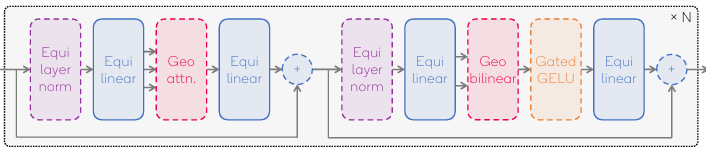)

In [ ]:
class GATrBlock(nn.Module):
    """
    A GATr transformer block that processes geometric data.

    This module integrates normalization, multi-query self-attention, and
    geometric MLP (GeoMLP) layers.
    Parameters:
    -----------
    mv_channels (int): Number of channels in the input and output multivectors.
    num_query (int, optional): Number of query vectors used in the attention mechanism.
    scalar_channels (Optional[int], optional): Number of channels in the optional
                                               scalar inputs and outputs.
    """

    def __init__(
        self,
        mv_chan_in: int,
        mv_chan_out: int,
        scalar_chan_in: Optional[int]=None,
        scalar_chan_out: Optional[int]=None,
        use_scalar_hidden: bool = False,
        num_query: int = 4,
        normalize: bool = False, # specific to GATrEquiLayerNorm
        bias: bool = True, # specific to GATrEquiLayerNorm
        activation_fn: str = "gelu", # specific to GATrEquiLinear

    ):

        super().__init__()

        mv_chan_hid = mv_chan_out
        scalar_chan_hid = scalar_chan_out

        # 1. & 6.Sateless layer. So, we can use it twice.
        self.equi_layernorm_1_6 = GATrEquiLayerNorm()

        # 2. Equivariant Linear layer
        self.equi_linear_layer_2 = GATrEquiLinear(
            multi_vec_in=mv_chan_in,
            multi_vec_out=mv_chan_out,
            scalar_in=scalar_chan_in,
            scalar_out=scalar_chan_out,
            normalize=normalize,
            bias=bias
        )

        # 3. Geometric Attention
        self.equi_geometric_attention_3 = GATrGeometricAttention(
            input_mv_channels=mv_chan_out,
            output_mv_channels=mv_chan_out,
            num_query=num_query,
            input_scalar_channels=scalar_chan_out,
            output_scalar_channels=scalar_chan_out,
        )

        # 4. Equivariant Linear layer 2
        self.equi_linear_layer_4 = GATrEquiLinear(
            multi_vec_in=mv_chan_out,
            multi_vec_out=mv_chan_out,
            scalar_in=scalar_chan_out,
            scalar_out=scalar_chan_out,
            normalize=normalize,
            bias=bias
        )

        # 5. Residual Connection
        # 6. Equivariant Layer Normalization 2 -> same as 1 above bec stateless

        # 7. Equivariant Linear layer 3
        self.equi_linear_layer_7 = copy.deepcopy(self.equi_linear_layer_4)

        # 8. Geometric Equivariant Bilinear layer
        self.equi_geometric_bilinear_layer_8 = GATrGeometricBilinear(
            input_mv_channels=mv_chan_out,
            output_mv_channels=mv_chan_out,
            input_scalar_channels=scalar_chan_out,
            output_scalar_channels=scalar_chan_out,
            use_scalar_hidden=use_scalar_hidden,
            normalize=normalize,
            bias=bias
            )

        # 9. Gated Activation Function (GELU/ReLU/Sigmoid/Tanh)
        self.gated_activation_fn_9 = GATrGatedActivation(activation_fn)

        # 10. Equivariant Linear layer 4
        self.equi_linear_layer_10 = copy.deepcopy(self.equi_linear_layer_4)

        # 11. Residual Connection

    def forward(
        self,
        multivectors: torch.Tensor,
        reference_mv: torch.Tensor,
        scalars: Optional[torch.Tensor] = None,
    ) -> Tuple[torch.Tensor, torch.Tensor]:

        # 1. Equivariant Layer Normalization
        h_mv, h_s = self.equi_layernorm_1_6(multivectors, scalars)

        # 2. Equivariant Linear layer
        h_mv, h_s = self.equi_linear_layer_2(h_mv, h_s)

        # 3. Geometric Attention
        h_mv, h_s = self.equi_geometric_attention_3(h_mv, h_s)

        # 4. Equivariant Linear layer
        h_mv, h_s = self.equi_linear_layer_4(h_mv, h_s)

        # 5. Residual Connection
        h_mv_res = multivectors + h_mv
        h_s_res = scalars + h_s if scalars is not None else h_s

        # 6. Equivariant Layer Normalization
        h_mv, h_s = self.equi_layernorm_1_6(h_mv_res, h_s_res)

        # 7. Equivariant Linear layer
        h_mv, h_s = self.equi_linear_layer_7(h_mv, h_s)

        # 8. Geometric Equivariant Bilinear layer
        h_mv, h_s = self.equi_geometric_bilinear_layer_8(h_mv, reference_mv, h_s)

        # 9. Gated Activation Function
        h_mv, h_s = self.gated_activation_fn_9(h_mv, h_s)

        # 10. Equivariant Linear layer
        h_mv, h_s = self.equi_linear_layer_10(h_mv, h_s)

        # 11. Residual Connection
        h_mv_res_2 = h_mv_res + h_mv
        h_s_res_2 = h_s_res + h_s if scalars is not None else h_s

        return h_mv_res_2, h_s_res_2

    def num_params(self) -> int:
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

In [ ]:
sample = torch.rand((32, 100, 3, 16)).to(config.device)
s = torch.rand((32, 100, 1)).to(config.device)
ref = torch.rand((32, 1, 1, 16)).to(config.device)

layer = GATrBlock(
        mv_chan_in=3,
        mv_chan_out=3,
        scalar_chan_in=1,
        scalar_chan_out=1,
        use_scalar_hidden=True,
        num_query = 4,
        normalize = True, # specific to GATrEquiLayerNorm
        bias = True, # specific to GATrEquiLayerNorm
        activation_fn = "gelu"
        )

# inplace
layer.to(device=config.device)

mv, scalars = layer(sample, ref, s)
print(f"shapes: mv: {mv.shape}, scalars: {scalars.shape if scalars is not None else None}")
print(f"\nmv: \t{mv[10, 87, 0, :]} \nscalars: \t{scalars[10, 87] if scalars is not None else None}")

print("Number of parameters: ", layer.num_params())

shapes: mv: torch.Size([32, 100, 3, 16]), scalars: torch.Size([32, 100, 1])

mv: 	tensor([65.6951, 97.1702,  1.8005,  2.4538,  1.4951, -2.0478, -2.6419, -2.3814,
         0.2184,  0.2530,  0.3282, -2.6056, -2.6057, -1.9598,  0.4383, -0.8617],
       device='cuda:0', grad_fn=<SliceBackward0>) 
scalars: 	tensor([14.3535], device='cuda:0', grad_fn=<SelectBackward0>)
Number of parameters:  1490


## GATr -- Entire Architecture

![GATr entire architecure](https://raw.githubusercontent.com/msilver22/GATr_arteries_classification/ea18ce30f67a7511cb5f67e778bf284e37fe1c3f/photos/gatr_architecture.png)

Just like we combined the modules relevant to the GATrBlock, here too, we combine all the modules of the entire Architecture. This is simply the combination of:
- Equivariant Linear Layer
- GATrBlock $\times N$
- Equivariant Linear Layer

In [ ]:
# @title Model Architecture
# Read the Lightning docs to know what can be included here
# Link: https://lightning.ai/docs/pytorch/stable/common/lightning_module.html

# define the LightningModule
class GATr(L.LightningModule):
    """GATr model implemented as a PyTorch Lightning Module for binary classification.

    It defines a geometric algebra transformer-based model that uses
    geometric algebra operations to process multivector and scalar inputs for
    binary classification tasks.

    Parameters:
    - input_mv_channels (Optional[int], optional): Number of input multivector channels.
    - hidden_mv_channels (Optional[int], optional): Number of hidden multivector channels.
    - output_mv_channels (Optional[int], optional): Number of output multivector channels.
    - input_s_channels (Optional[int], optional): Number of input scalar channels.
    - hidden_s_channels (Optional[int], optional): Number of hidden scalar channels.
    - output_s_channels (Optional[int], optional): Number of output scalar channels.
    - use_scalar_hidden (Optional[bool], optional): Whether to use a scalar hidden layer.
    - num_items (Optional[int], optional): Number of items in each input.
    - num_classes (Optional[int], optional): Number of classes in the classification task.
    - num_query (Optional[int], optional): Number of queries in the multi-query attention.
    - times_n (Optional[int], optional): Number of times to apply the block.
    - normalize (Optional[bool], optional): Whether to use layer normalization.
    - bias (Optional[bool], optional): Whether to use bias in the linear layers.
    - activation_fn (Optional[str], optional): Activation function to use in the linear layers.
    - lr (Optional[float], optional): Learning rate.
    - scheduler_patience (Optional[int], optional): Patience for the learning rate scheduler.
    - scheduler_factor (Optional[float], optional): Factor for the learning rate scheduler.
    - monitor (Optional[str], optional): Metric to monitor for the learning rate scheduler.
    """

    def __init__(
        self,
        input_mv_channels: Optional[int]=config.input_mv_channels,
        hidden_mv_channels: Optional[int]=16,
        output_mv_channels: Optional[int]=1,
        input_s_channels: Optional[int] = None,
        hidden_s_channels: Optional[int] = None,
        output_s_channels: Optional[int] = None,
        use_scalar_hidden: Optional[bool] = False,
        num_items: Optional[int] = config.num_items,
        num_classes: Optional[int] = 1,  # binary classification with 2 labels
        num_query: int = 4,
        times_n: int = 1,
        normalize: Optional[bool] = False,
        bias: Optional[bool] = True,
        activation_fn: Optional[str] = "gelu",
        lr: Optional[float]=config.lr,
        scheduler_patience: Optional[int] = config.scheduler_patience,
        scheduler_factor: Optional[float] = config.scheduler_factor,
        monitor: Optional[str] = config.monitor,
        optimizer_fn: Optional[torch.optim.Optimizer] = torch.optim.AdamW,
        lr_sched: Literal['plateau', 'cosine']= "plateau",
        loss_fn = torch.nn.BCEWithLogitsLoss,
    ):
        super(GATr, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.lr = lr
        self.scheduler_patience = scheduler_patience
        self.scheduler_factor = scheduler_factor
        self.monitor = monitor
        self.times_n = times_n

        #-----------------------------------------------------------------------
        # Define layers
        self.equi_linear_1 = GATrEquiLinear(
            multi_vec_in=input_mv_channels,
            multi_vec_out=hidden_mv_channels,
            scalar_in=input_s_channels,
            scalar_out=hidden_s_channels,
            normalize=normalize,
            bias=bias
        )

        self.gatr_blocks = nn.ModuleList([
            GATrBlock(mv_chan_in=hidden_mv_channels,
                    mv_chan_out=hidden_mv_channels,
                    scalar_chan_in=hidden_s_channels,
                    scalar_chan_out=hidden_s_channels,
                    use_scalar_hidden=use_scalar_hidden,
                    num_query = num_query,
                    normalize = normalize, # specific to GATrEquiLayerNorm
                    bias = bias, # specific to GATrEquiLayerNorm
                    activation_fn = activation_fn
                    )
            for i in range(times_n)
        ])

        self.equi_linear_2 = GATrEquiLinear(
            multi_vec_in=hidden_mv_channels,
            multi_vec_out=output_mv_channels,
            scalar_in=hidden_s_channels,
            scalar_out=output_s_channels if hidden_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        self.last_classifier = nn.Linear(in_features=num_items * 4, out_features=num_classes)

        try:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr, weight_decay=1e-3)
        except:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr)

        self.lr_scheduler_fn = torch.optim.lr_scheduler.CosineAnnealingLR if lr_sched == "cosine" else torch.optim.lr_scheduler.ReduceLROnPlateau
        self.loss_fn = loss_fn()

        self.apply(self._init_weights)

    def forward(self, multivectors, scalars):

        mv_in, s_in = self.equi_linear_1(multivectors, scalars)

        # Reference multivector
        ref = torch.mean(multivectors, keepdim=True, dim=(1,2))
        for gatr_block in self.gatr_blocks:
            mv_in, s_in = gatr_block(mv_in, ref, s_in)

        # TODO: don't throw away the scalars
        mv_2, s_2 = self.equi_linear_2(mv_in, s_in)

        # shape: (batch_size, num_items, in_mv_channels, out_mv_channels) -> (batch_size, (num_items * 4))
        mv_out = mv_2[:, :, 0, [1, 2, 3, 4]].squeeze()
        mv_out = rearrange(mv_out, "a b c -> a (b c)")

        logits = self.last_classifier(mv_out)

        return logits.flatten()

    @staticmethod
    def _init_weights(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.kaiming_normal_(m.weight)
            if m.bias is not None:
                torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            torch.nn.init.constant_(m.weight, 1)
            torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Embedding):
            torch.nn.init.normal_(m.weight, mean=0, std=0.01)
        elif isinstance(m, nn.Parameter):
            torch.nn.init.uniform_(m, a=-0.1, b=0.1)
        # Add more initializations as needed

    def training_step(self, batch, batch_idx):
        """training_step defines the train loop.

        `training_step` must return a Tensor, a dict, or None.
        """
        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="train")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def validation_step(self, batch, batch_idx):
        """When the validation_step() is called, the model has been put in eval mode and
        PyTorch gradients have been disabled. At the end of validation, the model goes back to
        training mode and gradients are enabled
        """

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="val")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def test_step(self, batch, batch_idx):
        """test_step defines the test loop."""

        # loss, acc_mean, f1_score, outputs, labels = self.get_loss_outputs_labels(batch, stage="test")
        # return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score, 'outputs': outputs, 'labels': labels}

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="test")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def on_test_start(self):
        # Track predictions and targets. Will be populated at the end of the test
        self.preds = []
        self.targets = []

    def on_test_end(self):
        confusion_matrix_score(self.targets, self.preds)
        self.preds.clear()
        self.targets.clear()

    def get_loss_outputs_labels(self,
                                batch,
                                stage: Literal['train', 'val', 'test'] = 'train'
                                ) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
        """Get loss, outputs, and labels from a batch

        Args:
            batch (torch.Tensor): Batch of data from the dataloader
            stage (str): 'train', 'val', or 'test'

        Returns:
            tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]: Loss, outputs, and labels
        """

        x_mv, x_s, y = batch
        x_mv = x_mv.to(self.device) # Shape: [batch_size, num_items, 3, 16] -> [256, 100, 3, 16]
        x_s = x_s.to(self.device)   # Shape:[batch_size, num_items, 1] -> [256, 100, 1]
        y = y.to(self.device)       # Shape: [batch_size] -> [256]

        logits = self.forward(x_mv, x_s) #.softmax(dim=1) Shape: [batch_size] -> [256]

        loss = self.loss_fn(logits, y.float()) # BCEWithLogitsLoss takes flaot
        # self.log(f"{stage}_loss", loss, on_step=True, prog_bar=True, logger=True)

        # calculate acc using sigmoid
        labels_hat = torch.round(torch.sigmoid(logits)) # Shape: [batch_size] -> [256]
        # labels_hat = torch.argmax(logits, dim=-1) # Shape: [batch_size] -> [256]

        # calculate acc
        # acc = torch.sum(y == labels_hat).item() / (len(y) * 1.0)
        acc_mean = (y==labels_hat).cpu().numpy().mean() # float

        if stage == 'test':
            self.preds.extend(labels_hat.cpu().tolist())
            self.targets.extend(y.cpu().tolist())

        # F1 score
        f1_score_fn = F1Score(task="binary", num_classes=2).to(device=y.device)
        f1_score = f1_score_fn(labels_hat, y) # takes ints, not floats

        # class_roc_auc = auroc(x_hat, y, task='multiclass', num_classes=num_classes)
        # for i in range(num_classes):
        #     class_roc_auc = auroc(x_hat, y)
        #     self.log(f"{i}-auroc", class_roc_auc, on_step=True, prog_bar=True, logger=True)

        # log the outputs!
        self.log_dict({f'{stage}_loss': loss, f'{stage}_acc': acc_mean, f'{stage}_f1_score': f1_score}, prog_bar=True, logger=True) # on_step=True, on_epoch=True)

        return loss, acc_mean, f1_score
        # return loss, acc_mean, f1_score, logits, y

    # def predict_step(self, batch, batch_idx):
    #     x, y = batch
    #     x = x.reshape(x.size(0), -1)
    #     scores = self.forward(x)
    #     preds = torch.argmax(scores, dim=1)
    #     return preds

    # def train_dataloader(self):
    #     return train_loader

    # def test_dataloader(self):
    #     return test_loader

    def configure_optimizers(self):
        return {
            "optimizer": self.optimizer_fn,
            "lr_scheduler": {
                "scheduler": self.lr_scheduler_fn(self.optimizer_fn, patience=self.scheduler_patience, factor=self.scheduler_factor),
                "monitor": self.monitor, #"val_loss",
            },
        }

    def num_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

    # Aumatically done by Lightning
    # def load_weights(self, model_path):
    #     self.load_state_dict(torch.load(model_path, map_location=device))

    # def save_weights(self, model_path):
    #     torch.save(self.state_dict(), model_path)


###Equivariance check

In [ ]:
def check_layer_equivariance(mv: torch.Tensor, layer, reference=None, spin=False):
    """
    We create a random Pin-transformation u and we test the equivariance of the layer.
    """

    if spin is True:
        i = np.random.randint(3) * 2
    else:
        i = np.random.randint(5)

    vector = torch.zeros(16, device=mv.device)
    u = torch.zeros(16, device=mv.device)
    u[0] = 1

    for _ in range(i):
        vector[1:5] = torch.rand(4, device=mv.device)
        normalization = norm(vector)
        vector = vector / normalization
        u = geometric_product(u, vector)

    if reference is not None:
        out1 = layer(sandwich_product(mv, u, i), reference)[0]
        out2 = sandwich_product(layer(mv, reference)[0], u, i)
    else:
        out1 = layer(sandwich_product(mv, u, i))[0]
        out2 = sandwich_product(layer(mv)[0], u, i)

    distance = torch.norm(out1 - out2)

    return distance.item()

In [ ]:
# Linear layer -> Pin-equivariant
x = torch.rand((32, 100, 3, 16)).to(config.device)
linear = GATrEquiLinear(3, 5, None, None)

linear.to(config.device)

for i in range(5):
    d = check_layer_equivariance(x, linear, spin=False)
    print(d)

0.0
711.9271850585938
6.0338861658237875e-05
370.8649597167969
2178.6708984375


In [ ]:
# Norm layer -> Pin-equivariant
x = torch.rand((32, 100, 3, 16)).to(config.device)
layer_norm = GATrEquiLayerNorm()
layer_norm.to(config.device)

for i in range(5):
    d = check_layer_equivariance(x, layer_norm, spin=False)
    print(d)

0.0
0.0
0.0
0.0
2.8698495952994563e-05


In [ ]:
# Attention layer -> Pin-equivariant
x = torch.rand((32, 100, 3, 16)).to(config.device)

attention = GATrGeometricAttention(input_mv_channels=3,
                                output_mv_channels=3,
                                num_query=4,
                                input_scalar_channels=1,
                                output_scalar_channels=1,
                               )
attention.to(config.device)

for i in range(5):
    d = check_layer_equivariance(x, attention, spin=False)
    print(d)

744.6339721679688
377.6805725097656
0.0
0.0
0.0


In [ ]:
# GATr block -> Spin-equivariant
x = torch.rand((32, 100, 3, 16)).to(config.device)
ref = torch.rand(32, 1, 1, 16).to(config.device)

block = GATrBlock(
        mv_chan_in=3,
        mv_chan_out=3,
        scalar_chan_in=1,
        scalar_chan_out=1,
        use_scalar_hidden=False,
        num_query = 4,
        normalize = False, # specific to GATrEquiLayerNorm
        bias = True, # specific to GATrEquiLayerNorm
        activation_fn = "gelu"
        )
block.to(config.device)

print("Pin reflections \n ")
for i in range(5):
    d = check_layer_equivariance(x, block, ref, spin=False)
    print(d)

print("\nSpin reflections \n")
for i in range(5):
    d = check_layer_equivariance(x, block, ref, spin=True)
    print(d)

Pin reflections 
 
690222.1875
322975.9375
389012.28125
376153.8125
690222.1875

Spin reflections 

547314.0
613996.5
544815.375
343005.375
690222.1875


This analysis shows that the model is not perfectly Pin-equivariant, although it is Spin-equivariant. \\
But what is the real difference between the two groups of transformations?
The Spin group includes  

*   translations
*   linear reflections
*   rotations about a line
*   screw motions(i.e. rotation about a line and a translation along the same line)

While the Pin group includes also

*   planar reflections
*   rotoreflections
*   point reflections





### Model configs

In [ ]:
# @title ModelCheckpoint: Checkpointing that saves the best model (based on 'monitor')

def get_checkpoint_callback(monitor: Literal["val_loss", "val_acc", "val_f1_score"] = config.monitor,
                            mode: Literal["min", "max"] = config.monitor_mode,
                            ) -> ModelCheckpoint:
    """"__Summary__:
    This function returns a ModelCheckpoint callback that saves the best model based on the 'monitor' and 'mode' parameters

    Args:
        monitor (str, optional): The metric to monitor. Defaults to "val_loss".
        mode (str, optional): min or max. Defaults to "min".

    Returns:
        ModelCheckpoint

    Example:
        >>> checkpoint_callback = get_checkpoint_callback(monitor="val_loss", mode="min")
    """

    return ModelCheckpoint(
                        dirpath="checkpoints",
                        filename="best-checkpoint",
                        save_top_k=1,
                        verbose=True,
                        monitor= monitor, #"val_loss",
                        mode=mode
    )

checkpoint_callback = get_checkpoint_callback(monitor=config.monitor, mode=config.monitor_mode)


In [ ]:
# @title EarlyStopping:
# If there's no improvement in 'patience' epochs, stop training
def get_early_stopping_callback(monitor: Literal["val_loss", "val_acc", "val_f1_score"] = config.monitor,
                                mode: Literal["min", "max"] = config.monitor_mode,
                                patience: int = config.patience
                                ) -> EarlyStopping:
    """"__Summary__:
    This function returns an EarlyStopping callback that stops training if there's no improvement in 'patience' epochs

    Args:
        monitor (str, optional): The metric to monitor. Defaults to "val_loss".
        mode (str, optional): min or max. Defaults to "min".
        patience (int, optional): Number of epochs to wait for improvement. Defaults to 10.

    Returns:
        EarlyStopping

    Example:
        >>> early_stopping_callback = get_early_stopping_callback(monitor="val_loss", mode="min", patience=10)
    """

    return EarlyStopping(monitor=monitor, patience=patience, mode=mode)

early_stop = get_early_stopping_callback(monitor=config.monitor, patience=config.patience, mode=config.monitor_mode)

In [ ]:
# @title Log the progress in TensorBoard:

tb_logger = loggers.TensorBoardLogger("lightning_logs", name="GATr")

In [ ]:
# @title Filter Params

import inspect

def filter_params(func, params):
    """
    Filters the params dictionary to include only those keys that match the function's parameters.
    """
    sig = inspect.signature(func)
    filtered_params = {k: v for k, v in params.items() if k in sig.parameters}
    return filtered_params

In [ ]:
# test filter params
arr = np.array([1, 2, 3, 4, 5, 6])
p = {"arr": arr, 'n_items': 3, 'axis': 0, 'out': None} # filter out the 'axis': 0, 'out': None
filter_params(take_n, p)

{'arr': array([1, 2, 3, 4, 5, 6]), 'n_items': 3}

In [ ]:
# @title Construct Model and Data

def construct_data(
        datamodule: GATrDataModule = GATrDataModule,
        X_train: pd.DataFrame = X_train,
        val_train: pd.DataFrame = val_train,
        X_test: pd.DataFrame = X_test,
        batch_size: int = config.batch_size,
        num_items: int = config.num_items,
        aggr_func: Union[avg_bins, take_n] = avg_bins,
        normalize_data: bool = True,
    ):

    gatr_datamodule = GATrDataModule(train_data=X_train,
                                      val_data=val_train,
                                      test_data=X_test,
                                      batch_size=batch_size,
                                      num_items=num_items,
                                      aggr_func=aggr_func,
                                      normalize=normalize_data,
                                      )
    return gatr_datamodule

def construct_model(
        model: Callable = GATr,
        input_mv_channels: int = config.input_mv_channels,
        hidden_mv_channels: int = 8,
        output_mv_channels: int = 16,
        input_s_channels: int = 1,
        hidden_s_channels: int = 8,
        output_s_channels: int = 4,
        use_scalar_hidden: bool = True,
        num_items: int = config.num_items,
        num_classes: int = 1,
        num_query: int = 4,
        times_n: int = 2,
        normalize: bool = True, # normalize basis elements
        bias: bool = True,      # bias in linear layer or the weights w and v
        activation_fn: Union['gelu', 'relu'] = 'gelu',
        lr: float = 3e-4,
        lr_sched: Union['plateau', 'cosine'] = 'plateau',
        scheduler_patience: int = config.scheduler_patience,
        scheduler_factor: float = config.scheduler_factor,
        monitor: Literal['val_loss', 'val_acc'] = config.monitor,
        optimizer_fn: Union[torch.optim.AdamW, torch.optim.SGD] = torch.optim.AdamW,
        loss_fn: torch.nn.BCEWithLogitsLoss = torch.nn.BCEWithLogitsLoss,
    ):

    # a dict of the function params
    params = {
        'input_mv_channels': input_mv_channels,
        'hidden_mv_channels': hidden_mv_channels,
        'output_mv_channels': output_mv_channels,
        'input_s_channels': input_s_channels,
        'hidden_s_channels': hidden_s_channels,
        'output_s_channels': output_s_channels,
        'use_scalar_hidden': use_scalar_hidden,
        'num_items': num_items,
        'num_classes': num_classes,
        'num_query': num_query,
        'times_n': times_n,
        'normalize': normalize,
        'bias': bias,
        'activation_fn': activation_fn,
        'lr': lr,
        'lr_sched': lr_sched,
        'scheduler_patience': scheduler_patience,
        'scheduler_factor': scheduler_factor,
        'monitor': monitor,
        'optimizer_fn': optimizer_fn,
        'loss_fn': loss_fn,
    }

    return GATr(**params)

gatr_data = construct_data()
print(f"Data Module training data len: { len(gatr_data.train_data) }", end="\t")

gatr_model = construct_model()
print(f"Num params: {gatr_model.num_parameters()}")
print(f"\nModel Construction: \n{gatr_model}")

Data Module training data len: 2559	Num params: 30641

Model Construction: 
GATr(
  (equi_linear_1): GATrEquiLinear(
    (multi_vec_2_multi_vec): GATrMultivectorLayer()
    (scalar_2_multi_vec): GATrScalarLayer(in_features=1, out_features=8, bias=False)
    (multi_vec_2_scalar): GATrScalarLayer(in_features=8, out_features=8, bias=False)
    (scalar_2_scalar): GATrScalarLayer(in_features=1, out_features=8, bias=False)
  )
  (gatr_blocks): ModuleList(
    (0-1): 2 x GATrBlock(
      (equi_layernorm_1_6): GATrEquiLayerNorm()
      (equi_linear_layer_2): GATrEquiLinear(
        (multi_vec_2_multi_vec): GATrMultivectorLayer()
        (scalar_2_multi_vec): GATrScalarLayer(in_features=8, out_features=8, bias=False)
        (multi_vec_2_scalar): GATrScalarLayer(in_features=8, out_features=8, bias=False)
        (scalar_2_scalar): GATrScalarLayer(in_features=8, out_features=8, bias=False)
      )
      (equi_geometric_attention_3): GATrGeometricAttention(
        (Q): GATrEquiLinear(
          

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO:lightning.pytorch.utilities.rank_zero:Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name            | Type              | Params
------------------------

Training: |          | 0/? [00:00<?, ?it/s]

Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.4375, loss: 6267690.5
f1 score: 0.5909090638160706
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.4375, loss: 4648588.0
f1 score: 0.6086956262588501
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.5625, loss: 3619577.0
f1 score: 0.7083333134651184
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.40625, loss: 5198757.0
f1 score: 0.5365853905677795
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.46875, loss: 3101889.75
f1 score: 0.604651153087616


Validation: |          | 0/? [00:00<?, ?it/s]

Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.65625, loss: 1741792.75
f1 score: 0.7027027010917664
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.5625, loss: 2561389.0
f1 score: 0.695652186870575
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.53125, loss: 2105004.0
f1 score: 0.6666666865348816
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.5625, loss: 2867455.25
f1 score: 0.7083333134651184


INFO: `Trainer.fit` stopped: `max_steps=5` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.5625, loss: 2337023.75
f1 score: 0.6499999761581421


Testing: |          | 0/? [00:00<?, ?it/s]

Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.53125, loss: 2538560.75
f1 score: 0.6511628031730652
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.5625, loss: 1904408.0
f1 score: 0.7200000286102295
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.71875, loss: 1629685.75
f1 score: 0.7804877758026123
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.59375, loss: 1829732.75
f1 score: 0.7234042286872864
Shapes: logits: torch.Size([32]), y: torch.Size([32]), labels_hat: torch.Size([32]), acc_mean: 0.59375, loss: 2445745.0
f1 score: 0.7111111283302307


The accuracy score is 60.0000%.

classification_report: 
              precision    recall  f1-score   support

           0       0.94      0.19      0.32        78
           1       0.56      0.99      0.72        82

    accuracy                  

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.6000000238418579     │
│       test_f1_score       │    0.7172331809997559     │
│         test_loss         │        2069626.625        │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 2069626.625,
  'test_acc': 0.6000000238418579,
  'test_f1_score': 0.7172331809997559}]

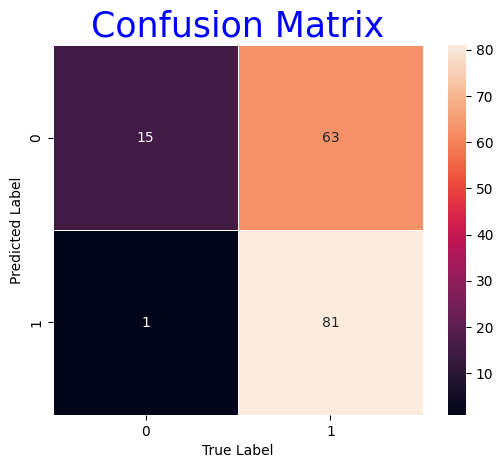

In [ ]:
# @title Fast Dev: run a small batch to see that everything works fine
# initialize the trainer

trainer = L.Trainer(fast_dev_run=5,   # 5 batches
                    accelerator="auto",
                    gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )
                    )
trainer.fit(model=gatr_model, datamodule=gatr_data)
# trainer.validate(model=gatr_model, datamodule=gatr_data)
trainer.test(model=gatr_model, datamodule=gatr_data)


In [ ]:
# @title Auto Learning Rate Finding
# Link: https://lightning.ai/releases/2.0.0/#:~:text=The%20Tuner%20and%20Trainer%20broke%20up%20(%2316462)

def find_lr_pl(model: GATr,
               dataloader: GATrDataModule,
               trainer: L.Trainer):
    """__Summary__:
    This function finds the optimal learning rate for the model using the tuner and the trainer and returns the results.

    Args:
        - car_racing (CarRacing): The model to be trained and tuned
        - car_racing_data (CarRacingDataModule): The datamodule to be used for training and tuning the model
        - trainer (Trainer): The trainer to be used for training and tuning the model and finding the optimal learning rate for the model

    Returns:
        - lr_find_results (LrFind) : The results of the learning rate finder
        - lr_suggestion (float) : The suggested learning rate

    Example:
        >>> lr_find_results, lr_suggestion = find_lr_pl(car_racing, car_racing_data, trainer)

    You can use 'car_racing.hparams.lr = lr_suggestion' to set the suggested learning rate
    """
    tuner = L.pytorch.tuner.Tuner(trainer)

    # Note: most of these are default values already. But you have to give the model and any dataloaders or datamodule
    lr_find_results = tuner.lr_find(
        model=model,
        datamodule=dataloader,
        method='fit',               # 'fit', 'validate', 'test', 'predict'
        min_lr=1e-08,
        max_lr=1.0,
        num_training=50,
        mode='exponential',         # or linear -> increase the lr linearly or exply
        early_stop_threshold=4.0,   # default 4.0. If you don't want it, set it to None
        update_attr=True,
        # attr_name='my_lr'              # If you have any other name different from lr or learning_rate, then set it explicitly
        )

    print(f"\nlr_find_results.results['lr']: {lr_find_results.results['lr']}")
    print(f"lr_find_results.results['loss']: {lr_find_results.results['loss']}")
    print(f"Len lr_find_results.results['lr']: {len( lr_find_results.results['lr'] )}")
    #print(f"\nlr_find_results.results: {lr_find_results.results}")

    lr_suggestion = lr_find_results.suggestion()
    print("\nlr_suggestion: ", lr_suggestion)

    # It sets the hparams.lr or hparams.learning_rate to the best suggested one (not the min or the max one, but... see the doc)
    # Does it automatically if update_attr=True, default
    model.hparams.lr = lr_suggestion
    print(f"\ncar_racing.hparams.lr: {model.hparams.lr}")

    fig = lr_find_results.plot(suggest=True)

    return lr_find_results, lr_suggestion

# lr_find_results, lr_suggestion = find_lr_pl(gatr_model, gatr_data, trainer)


In [ ]:
# @title Fit

# trainer = L.Trainer(
#     logger=tb_logger,
#     callbacks=[early_stop, checkpoint_callback],   # we use both checkpoints
#     max_epochs=100,
#     accelerator="auto",
#     devices="auto",
#     enable_checkpointing=True,
#     deterministic=True,
# )

# Delete the tensorboard logs dir if it already exists to not accumulate logs from multiple runs
# !rm -rf lightning_logs/

# gatr_model.hparams.lr = lr_suggestion
# trainer.fit(model=gatr_model, datamodule=gatr_data)


In [ ]:
# # @title Tensorboard Logging
# %reload_ext tensorboard
# %tensorboard --logdir /content/lightning_logs

In [ ]:
# @title Test
# trainer.test(model=gatr_model, datamodule=gatr_data, ckpt_path="best" )
# ckpt_path="best" means use the best model weights, not necessarily the last one

# Hyperparameters' Optimization

In [ ]:
# @title Base Hyperparameter Class

from abc import ABC, abstractmethod

class BaseHPTuner(ABC):
    """Base Hyperparameter Tuner Class, subclass must implement the 'objective_function' and 'tune' methods.

    Args:
        model_class (nn.Module): The model to be used for training
        num_epochs (int, optional): The number of epochs to be used for training. Defaults to config.num_epochs.
        num_trials (int, optional): The number of trials to be used for hyperparameter tuning. Defaults to 10.
        study_name (str, optional): The name of the study to be used for hyperparameter tuning. Defaults to 'optuna'.

    Methods:
        objective_function(self, params: Union[optuna.Trial, Dict]) -> float
        tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None) -> None
        train(self, num_epochs:Optional[int]=None) -> None
        test(self) -> None
        predict(self) -> NotImplemented
        _create_datamodule(self, param: Union[optuna.Trial, Dict]) -> LightningDataModule
        _create_model(self, param: Union[optuna.Trial, Dict]) -> LightningModule
        _create_trainer(self, param: Union[optuna.Trial, Dict]) -> Trainer

    Example:
        >>> tuner = BaseHPTuner(model_class, num_epochs, num_trials, study_name)
    """
    def __init__(self, model_class, num_epochs:int=config.num_epochs, num_trials:int=10, study_name:str='optuna'):
        self.model_class = model_class
        self.study_name = study_name
        self.num_epochs = num_epochs
        self.num_trials = num_trials
        self.best_params = None

    @abstractmethod
    def objective_function(self, params: Union[optuna.Trial, Dict]):
        """
        Objective function to be used for hyperparameter tuning.
        """
        pass

    @abstractmethod
    def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):
        """Function to be used for hyperparameter tuning. Calls the 'objective_function' to tune the hyperparameters.
        """
        pass

    def train(self, num_epochs:Optional[int]=None):
        """
        Train the model using the best hyperparameters found by the tuner.
        """

        assert self.best_params is not None, "Best parameters not found. Run the tuner first."

        num_epochs = num_epochs if num_epochs is not None else self.num_epochs

        self.datamodule = self._create_datamodule(param=self.best_params)
        self.model = self._create_model(self.best_params)

        chck_clb = ModelCheckpoint(dirpath="checkpoints", filename=self.study_name, save_top_k=1, monitor=config.monitor, mode=config.monitor_mode)
        early_stop_clb = EarlyStopping(monitor=config.monitor, patience=config.patience, verbose=True, mode=config.monitor_mode)
        callback = [chck_clb, early_stop_clb]

        self.trainer = self._create_trainer(max_epochs=num_epochs, name=self.study_name, callback=callback)
        self.trainer.fit(self.model, self.datamodule)

    def test(self):
        """
        Test the model using the best parameters found during training.
        """
        assert self.model is not None and self.datamodule is not None, "Model and datamodule not found. Run the train first."
        self.trainer.test(model=self.model, datamodule=self.datamodule, ckpt_path="best" )

    def predict(self, predict_data):
        """Implement the predict step in the Lightning Trainer first."""
        # assert self.model is not None, "Model and datamodule not found. Run the train first."
        # predictions = self.trainer.predict(model=self.model, datamodule=predict_data, ckpt_path="best" )
        # return predictions

        raise NotImplementedError("Please implement the predict step in the Lightning Trainer first.")

    def _create_datamodule(self,
                           train_data: pd.DataFrame=X_train,
                           val_data: pd.DataFrame=val_train,
                           test_data: pd.DataFrame=X_test,
                           param: dict = {}
                           ) -> L.LightningDataModule:
        """
        Create the datamodule for the model.
        """
        # Filter the datamodule params
        filer_datamodule = filter_params(func=construct_data, params=param)
        return construct_data(GATrDataModule, train_data, val_data, test_data, **filer_datamodule)

    def _create_model(self, param:dict={}):
        """Create the model for the model."""

        # Filter the datamodule params
        filer_model = filter_params(func=construct_model, params=param)
        return construct_model(self.model_class, **filer_model)
        # return self.model_class(**filer_model)

    def _create_trainer(self, max_epochs:int=10, name:str="optuna", callback:list=None, enable_checkpointing=True):
        """Create the trainer for the model."""
        return L.Trainer(
            logger=loggers.TensorBoardLogger("lightning_logs", name=name),
            callbacks=callback,
            accelerator="auto",
            devices="auto",
            enable_checkpointing=enable_checkpointing,
            deterministic=True,
            max_epochs=max_epochs,
            gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly
        )



## Optuna

In [ ]:

# Latest
# {'batch_size': 32, 'lr': 0.007257827795260546, 'bias': False, 'normalize_basis_elements': False, 'num_query': 4, 'use_scalar_hidden': False, 'times_n': 2, 'lr_sched': 'cosine', 'which_net': 'not gatr', 'aggr_func': <function take_n at 0x7e91589d8f70>, 'normalize_data': True}. Best is trial 2 with value: 0.00203418405726552.

# {'batch_size': 32, 'lr': 0.008324680552888737, 'num_query': 8, 'use_scalar_hidden': True, 'times_n': 2, 'lr_sched': 'linear', 'which_net': 'gatr'}. Best is trial 3 with value: 0.0.

# {'batch_size': 64, 'lr': 0.006565387751309639, 'num_query': 4, 'use_scalar_hidden': True, 'activation_fn': 'gelu', 'times_n': 1, 'lr_sched': 'linear', 'which_net': 'not gatr'}. Best is trial 0 with value: 0.0.

In [ ]:
# @title Optuna Hyperparameter Tuning

import optuna
from optuna.integration import PyTorchLightningPruningCallback # Earling Stopping from unpromising results
import logging

logging.basicConfig(level=logging.INFO)

# Delete the tensorboard logs dir if it already exists to not accumulate logs from multiple runs
# !rm -rf lightning_logs/

class OptunaHPTuner(BaseHPTuner):
    """Optuna tuner for hyperparameter tuning. Subclass of BaseHPTuner."""
    def __init__(self,
                 model_class:Callable=GATr,
                 study_name:str="optuna_study",
                 num_epochs:int=config.num_epochs,
                 num_trials:int=10,
                 direction:str="maximize" if config.monitor_mode == "max" else "minimize"
                 ):
        super().__init__(model_class, num_epochs=num_epochs, num_trials=num_trials, study_name=study_name)
        self.direction = direction
        self.study: optuna.study.Study = optuna.create_study(study_name=study_name, direction=direction, pruner=optuna.pruners.MedianPruner())

    def objective_function(self, trial):
        # Define the hyperparameters to be optimized

        # Create your datamodule
        datamodule = GATrDataModule(train_data=X_train,
                                    val_data=val_train,
                                    test_data=X_test,
                                    batch_size = trial.suggest_int("batch_size", 32, 64, step=32), # 24, 40, step=8,
                                    num_items=config.num_items,
                                    aggr_func = trial.suggest_categorical("aggr_func", [avg_bins, take_n]),
                                    normalize = trial.suggest_categorical("normalize_data", [True, False]),
                                    )

        # Create your model and configure it with the suggested hyperparameters
        model = self.model_class(
                input_mv_channels = config.input_mv_channels,
                hidden_mv_channels = 4, #trial.suggest_int("hidden_mv_channels", 4, 8, step=4)
                output_mv_channels = 16,
                input_s_channels = 1,
                hidden_s_channels = 4, #trial.suggest_int("hidden_s_channels", 4, 8, step=4),
                output_s_channels = 1, #trial.suggest_int("output_s_channels", 4, 8, step=4),
                use_scalar_hidden = trial.suggest_categorical("use_scalar_hidden", [True, False]),
                num_items = config.num_items,
                num_classes = 1,
                num_query = trial.suggest_int("num_query", 4, 8, step=4),
                times_n = trial.suggest_int("times_n", 1, 2, step=1),
                normalize = True, #trial.suggest_categorical("normalize_basis_elements", [False, True]), # normalize basis elements
                bias = trial.suggest_categorical("bias", [False, True]), # bias in linear layer or the weights w and v
                activation_fn = trial.suggest_categorical("activation_fn", ["gelu", "relu"]),
                lr = trial.suggest_float("lr", 1e-7, 3e-4, log=True),
                lr_sched = 'plateau', #trial.suggest_categorical("lr_sched", ["cosine", "plateau"]),
                scheduler_patience = config.scheduler_patience,
                scheduler_factor = config.scheduler_factor,
                monitor = config.monitor,
                optimizer_fn = torch.optim.AdamW,
                loss_fn = torch.nn.BCEWithLogitsLoss,
            )

        # Configure your PyTorch Lightning Trainer
        # callbacks = [PyTorchLightningPruningCallback(trial, monitor="val_f1_score")]
        # trainer = L.Trainer(max_epochs=1, callbacks=callbacks, logger=True)
        trainer = L.Trainer(
                logger=False, #loggers.TensorBoardLogger("lightning_logs", name=self.study_name+"_tuner_"+str(trial.number)),
                callbacks=[PyTorchLightningPruningCallback(trial, monitor=config.monitor)],
                accelerator="auto",             # 'cpu', 'gpu', tpu', etc
                devices="auto",                 # num devices: 1, 2, 3, 4, ... or specify which one(s) [0], [2], [3, 5, 6], etc
                enable_checkpointing=False,
                deterministic=True,
                max_epochs=1,
                gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

            )

        # Train and validate your model
        trainer.fit(model, datamodule)

        # Retrieve the metric you want to optimize
        metric = trainer.callback_metrics[config.monitor].item()

        return metric

    def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):

        self.num_epochs = num_epochs if num_epochs is not None else self.num_epochs
        self.num_trials = num_trials if num_trials is not None else self.num_trials

        self.study.optimize(self.objective_function, n_trials=self.num_trials, show_progress_bar=True)
        self.best_trial = self.study.best_trial

        print(f"Best trial: {self.best_trial.values}")
        print(f"Best value: {self.best_trial.value}")

        # No need to return bec it is accessible after tuning.
        self.best_params = self.best_trial.params
        print("\nBest Params: ")
        for key, value in self.best_params.items():
            print(f"\t{key}: {value}")


# Demo
optuna_tuner = OptunaHPTuner(GATr)
optuna_tuner.tune()
# optuna_tuner.tune(num_epochs=1, num_trials=1)

[I 2024-05-27 02:27:43,383] A new study created in memory with name: optuna_study


  0%|          | 0/1 [00:00<?, ?it/s]

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name            | Type              | Params
------------------------------------------------------
0 | equi_linear_1   | GATrEquiLinear    | 136   
1 | gatr_blocks     | ModuleList        | 11.6 K
2 | equi_linear_2   | GATrEquiLinear    | 676   
3 | last_classifier | Linear            | 401   
4 | loss_fn         | BCEWithLogitsLoss | 0     
-------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


[I 2024-05-27 02:30:59,621] Trial 0 finished with value: 978.3659057617188 and parameters: {'batch_size': 32, 'aggr_func': <function avg_bins at 0x7b82809e1870>, 'normalize_data': True, 'use_scalar_hidden': True, 'num_query': 8, 'times_n': 2, 'bias': True, 'activation_fn': 'gelu', 'lr': 5.731141019254154e-06}. Best is trial 0 with value: 978.3659057617188.
Best trial: [978.3659057617188]
Best value: 978.3659057617188

Best Params: 
	batch_size: 32
	aggr_func: <function avg_bins at 0x7b82809e1870>
	normalize_data: True
	use_scalar_hidden: True
	num_query: 8
	times_n: 2
	bias: True
	activation_fn: gelu
	lr: 5.731141019254154e-06


In [ ]:
optuna_tuner.best_params

# test f1 score = 100%, val = 99.8%, train = 100%
# {'batch_size': 32,
#  'aggr_func': <function __main__.take_n(arr: numpy.ndarray, n_items: int)>,
#  'normalize_data': True,
#  'use_scalar_hidden': True,
#  'num_query': 4,
#  'times_n': 2,
#  'normalize_basis_elements': True,
#  'bias': True,
#  'lr': 0.05908705664394881,
#  'lr_sched': 'linear'}

{'batch_size': 32,
 'aggr_func': <function __main__.avg_bins(arr: numpy.ndarray, n_items: int)>,
 'normalize_data': True,
 'use_scalar_hidden': True,
 'num_query': 8,
 'times_n': 2,
 'bias': True,
 'activation_fn': 'gelu',
 'lr': 5.731141019254154e-06}

In [ ]:
# @title Train Optuna Model with tuned hyperparameters
optuna_tuner.train(num_epochs=config.num_epochs)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name            | Type              | Params
------------------------------------------------------
0 | equi_linear_1   | GATrEquiLinear    | 304   
1 | gatr_blocks     | ModuleList        | 46.0 K
2 | equi_linear_2   | GATrEquiLinear    | 1.4 K 
3 | last_classifier | Linear            | 401   
4 | loss_fn         | BCEWithLogitsLoss | 0     
-------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved. New best score: 2367781.000
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 2367781.000
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


INFO: Restoring states from the checkpoint path at /content/checkpoints/optuna_study.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/checkpoints/optuna_study.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/checkpoints/optuna_study.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/checkpoints/optuna_study.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 15.5000%.

classification_report: 
              precision    recall  f1-score   support

           0       0.08      0.07      0.08       400
           1       0.21      0.24      0.22       400

    accuracy                           0.15       800
   macro avg       0.14      0.15      0.15       800
weighted avg       0.14      0.15      0.15       800




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.1550000011920929     │
│       test_f1_score       │    0.2159101516008377     │
│         test_loss         │        2195454.75         │
└───────────────────────────┴───────────────────────────┘

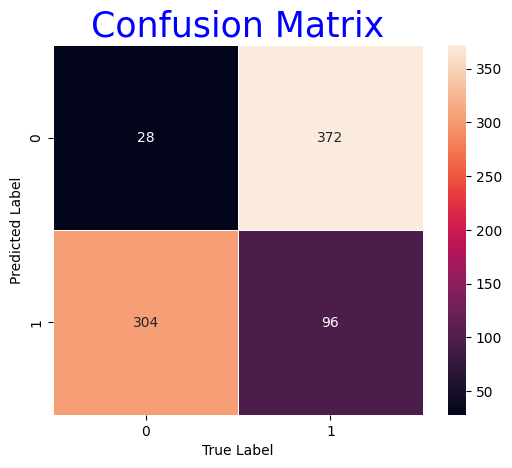

In [ ]:
# @title Test Optuna Model
optuna_tuner.test()

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir /content/lightning_logs

<IPython.core.display.Javascript object>

## AX

In [ ]:
# !pip install -q ax-platform

In [ ]:
# import ax
# from ax.service.managed_loop import optimize

# class AxHPTuner(BaseHPTuner):
#     def __init__(self, model_class:Callable, num_epochs:int=config.num_epochs, num_trials:int=10, study_name:str="AX"):
#         super().__init__(model_class, num_epochs=num_epochs, num_trials=num_trials, study_name=study_name)
#         self.num_trial_count = 0

#     def objective_function(self, params:Dict):
#         datamodule = self._create_datamodule(param=params)
#         model = self._create_model(param=params)

#         trainer = L.Trainer(
#             logger=L.loggers.TensorBoardLogger("lightning_logs", name=self.study_name+"_tuner_"+str(self.num_trial_count)),
#             accelerator="auto",
#             devices="auto",
#             enable_checkpointing=False,
#             deterministic=True,
#             max_epochs=params["num_epochs"],
#             gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

#         )
#         self.num_trial_count += 1

#         trainer.fit(model, datamodule)
#         metric = trainer.callback_metrics[params["monitor"]]
#         return metric

#     def training_function(self, parameters):
#         # Create your datamodule
#         datamodule = GATrDataModule(train_data=X_train,
#                                     val_data=val_train,
#                                     test_data=X_test,
#                                     batch_size=parameters["batch_size"],
#                                     num_items=config.num_items,
#                                     aggr_func=parameters["aggr_func"],
#                                     normalize=parameters["normalize_data"])

#         # Create your model and configure it with the provided hyperparameters
#         model = self.model_class(
#             input_mv_channels=config.input_mv_channels,
#             hidden_mv_channels=parameters["hidden_mv_channels"],
#             output_mv_channels=config.output_mv_channels,
#             input_s_channels=config.input_s_channels,
#             hidden_s_channels=parameters["hidden_s_channels"],
#             output_s_channels=parameters["output_s_channels"],
#             use_scalar_hidden=parameters["use_scalar_hidden"],
#             num_items=config.num_items,
#             num_classes=config.num_classes,
#             num_query=parameters["num_query"],
#             times_n=parameters["times_n"],
#             normalize=parameters["normalize_basis_elements"],
#             bias=parameters["bias"],
#             activation_fn=parameters["activation_fn"],
#             lr=parameters["lr"],
#             lr_sched=parameters["lr_sched"],
#             scheduler_patience=config.scheduler_patience,
#             scheduler_factor=config.scheduler_factor,
#             monitor=config.monitor,
#             optimizer_fn=parameters["optimizer_fn"],
#             loss_fn=parameters["loss_fn"],
#         )

#         # Configure your PyTorch Lightning Trainer
#         trainer = L.Trainer(
#             logger=L.loggers.TensorBoardLogger("lightning_logs", name="ax"),
#             accelerator="auto",
#             devices="auto",
#             enable_checkpointing=False,
#             deterministic=True,
#             max_epochs=self.max_epochs,
#             gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

#         )

#         # Train and validate your model
#         trainer.fit(model, datamodule)

#         # Retrieve the metric you want to optimize
#         metric = trainer.callback_metrics[config.monitor]

#         return metric

#     def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):

#         self.num_epochs = num_epochs if num_epochs is not None else self.num_epochs
#         self.num_trials = num_trials if num_trials is not None else self.num_trials

#         # Define the search space
#         search_space = [
#             ax.RangeParameter(name="batch_size", lower=32, upper=64, parameter_type=ax.ParameterType.INT),
#             ax.ChoiceParameter(name="aggr_func", values=["avg_bins", "take_n"], parameter_type=ax.ParameterType.STRING, is_ordered=False, sort_values=False),
#             ax.ChoiceParameter(name="normalize_data", values=[True, False], parameter_type=ax.ParameterType.BOOL, is_ordered=True, sort_values=True),
#             ax.RangeParameter(name="hidden_mv_channels", lower=4, upper=8, parameter_type=ax.ParameterType.INT),
#             ax.RangeParameter(name="hidden_s_channels", lower=4, upper=8, parameter_type=ax.ParameterType.INT),
#             ax.RangeParameter(name="output_s_channels", lower=4, upper=8, parameter_type=ax.ParameterType.INT),
#             ax.ChoiceParameter(name="use_scalar_hidden", values=[True, False], parameter_type=ax.ParameterType.BOOL, is_ordered=True, sort_values=True),
#             ax.RangeParameter(name="num_query", lower=4, upper=8, parameter_type=ax.ParameterType.INT),
#             ax.RangeParameter(name="times_n", lower=1, upper=2, parameter_type=ax.ParameterType.INT),
#             ax.ChoiceParameter(name="normalize_basis_elements", values=[False, True], parameter_type=ax.ParameterType.BOOL, is_ordered=True, sort_values=True),
#             ax.ChoiceParameter(name="bias", values=[False, True], parameter_type=ax.ParameterType.BOOL, is_ordered=True, sort_values=True),
#             ax.ChoiceParameter(name="activation_fn", values=["gelu", "relu"], parameter_type=ax.ParameterType.STRING, is_ordered=False, sort_values=False),
#             ax.RangeParameter(name="lr", lower=1e-5, upper=1e-1, parameter_type=ax.ParameterType.FLOAT, log_scale=True),
#             ax.ChoiceParameter(name="lr_sched", values=["cosine", "linear"], parameter_type=ax.ParameterType.STRING, is_ordered=False, sort_values=False),
#             # ax.ChoiceParameter(name="optimizer_fn", values=[torch.optim.Adam, torch.optim.SGD], parameter_type=ax.ParameterType.STRING, is_ordered=False, sort_values=False),
#             # ax.ChoiceParameter(name="loss_fn", values=[torch.nn.CrossEntropyLoss, torch.nn.BCELoss], parameter_type=ax.ParameterType.STRING, is_ordered=False, sort_values=False),
#         ]

#         # Optimize
#         best_params, values, experiment, model = optimize(
#             parameters=search_space,
#             evaluation_function=self.objective_function,
#             objective_name=config.monitor,
#             minimize=False if config.monitor_mode == "max" else True,
#             total_trials=self.num_trials,
#         )

#         self.best_params = best_params
#         self.best_metric = max(values) if config.monitor_mode == "max" else min(values)

#         print(f"Best parameters: {self.best_params}")
#         print(f"Best metric: {self.best_metric}")

# ax_tuner = AxHPTuner(GATr)
# ax_tuner.tune()
# ax_tuner.tune(num_epochs=1, num_trials=1)

In [ ]:
# ax_tuner.best_params

In [ ]:
# @title Train AX Model with tuned hyperparameters
# ax_tuner.train(num_epochs=config.num_epochs)

In [ ]:
# @title Test AX Model
# ax_tuner.test()


In [ ]:
# %reload_ext tensorboard
# %tensorboard --logdir /content/lightning_logs

## Ray Tune Hyperparameter Optimization

In [ ]:
# !pip install -q ray[tune]

In [ ]:

# import ray
# from ray import tune
# from ray.tune.schedulers import ASHAScheduler

# # Initialize Ray
# ray.init(num_cpus=1, log_to_driver=False, ignore_reinit_error=True)

In [ ]:
# # Ray Tune Hyperparameter Tuner

# class RayTuneHPTuner(BaseHPTuner):
#     def __init__(self, model_class:Callable, num_epochs:int=config.num_epochs, num_trials:int=10, study_name:str="ray_tune"):
#         super().__init__(model_class, num_epochs=num_epochs, num_trials=num_trials, study_name=study_name)
#         self.num_trial_count = 0

#     def objective_function(self, params:Dict):
#         datamodule = self._create_datamodule(param=params)
#         model = self._create_model(param=params)

#         trainer = L.Trainer(
#             logger=L.loggers.TensorBoardLogger("lightning_logs", name=self.study_name+"_tuner_"+str(self.num_trial_count)),
#             accelerator="auto",
#             devices="auto",
#             enable_checkpointing=False,
#             deterministic=True,
#             max_epochs=params["num_epochs"],
#             gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

#         )
#         self.num_trial_count += 1

#         trainer.fit(model, datamodule)
#         metric = trainer.callback_metrics[params["monitor"]]
#         tune.report(metric=metric)

#     def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):

#         self.num_epochs = num_epochs if num_epochs is not None else self.num_epochs
#         self.num_trials = num_trials if num_trials is not None else self.num_trials

#         params = {
#             "batch_size": tune.choice([32, 64]),
#             "aggr_func": tune.choice([avg_bins, take_n]),
#             "normalize_data": tune.choice([True, False]),
#             "input_mv_channels": config.input_mv_channels,
#             "hidden_mv_channels": tune.choice([4, 8]),
#             "output_mv_channels": 16,
#             "input_s_channels": config.input_s_channels,
#             "hidden_s_channels": tune.choice([4, 8]),
#             "output_s_channels": tune.choice([4, 8]),
#             "use_scalar_hidden": tune.choice([True, False]),
#             "num_items": config.num_items,
#             "num_classes": 2,
#             "num_query": tune.choice([4, 8]),
#             "times_n": tune.choice([1, 2]),
#             "normalize_basis_elements": tune.choice([False, True]),
#             "bias": tune.choice([False, True]),
#             "activation_fn": tune.choice(["gelu", "relu"]),
#             "lr": tune.loguniform(1e-5, 1e-1),
#             "lr_sched": tune.choice(["cosine", "linear"]),
#             "scheduler_patience": config.scheduler_patience,
#             "scheduler_factor": config.scheduler_factor,
#             "monitor": config.monitor,
#             "optimizer_fn": torch.optim.Adam, #tune.choice([torch.optim.Adam, torch.optim.SGD]),
#             "loss_fn": torch.nn.CrossEntropyLoss, #tune.choice([torch.nn.CrossEntropyLoss, torch.nn.BCELoss]),
#             "num_epochs": self.num_epochs,
#         }

#         scheduler = ASHAScheduler(
#             max_t=self.num_epochs,
#             grace_period=1,
#             reduction_factor=2)

#         analysis = tune.run(
#             self.objective_function,
#             resources_per_trial={"cpu": 1, "gpu": 1 if torch.cuda.is_available() else 0},
#             config=params,
#             metric=config.monitor,
#             mode=config.monitor_mode,
#             num_samples=self.num_trials,
#             scheduler=scheduler,
#             log_to_file=False)

#         self.best_params = analysis.get_best_config(metric=config.monitor, mode=config.monitor_mode)
#         print(f"\nBest config: {self.best_params}\n")

# ray_tuner = RayTuneHPTuner(GATr)
# ray_tuner.tune()
# ray_tuner.tune(num_epochs=1, num_trials=1)


In [ ]:
# ray_tuner.best_params

In [ ]:
# @title Training with best ray tune hyperparameters
# ray_tuner.train(num_epochs=1)

In [ ]:
# @title Test
# ray_tuner.test()


In [ ]:
# %reload_ext tensorboard
# %tensorboard --logdir /content/lightning_logs

# Simple Equivalent Linear Model

In [ ]:
mult_vec = torch.rand((32, 100, 3, 16), device=config.device)
scalar = torch.rand((32, 100, 2), device=config.device)

gatr_layer = GATrEquiLinear(multi_vec_in=3,
                            multi_vec_out=6,
                            scalar_in=2,
                            scalar_out=6,
                            normalize=True,
                            bias=True
                            )
gatr_layer.to(config.device)

multi_vec_out, scalar_out = gatr_layer(mult_vec, scalar)
print(multi_vec_out.shape, scalar_out.shape)
print(f"multi_vec_out: \n\t{multi_vec_out[0, 97, 2, :]} \nscalar_out: \n\t{scalar_out[0, 97, :]}")

torch.Size([32, 100, 6, 16]) torch.Size([32, 100, 6])
multi_vec_out: 
	tensor([-2.8974e+00,  1.0196e+00,  2.3834e-03, -1.3451e-01, -2.6473e-01,
        -2.5962e-01, -9.8583e-01, -7.1744e-01, -3.5079e-01, -5.0642e-01,
        -4.8688e-01, -2.9935e-01, -5.6480e-01, -9.2110e-01, -2.7901e-01,
         3.0445e+00], device='cuda:0', grad_fn=<SliceBackward0>) 
scalar_out: 
	tensor([-0.7457, -0.7375,  1.3625,  0.1933, -1.5113, -0.8480], device='cuda:0',
       grad_fn=<SliceBackward0>)


In [ ]:
# @title SImple model
# Read the Lightning docs to know what can be included here
# Link: https://lightning.ai/docs/pytorch/stable/common/lightning_module.html

# define the LightningModule
class SimpleGATr(L.LightningModule):

    def __init__(
        self,
        input_mv_channels: Optional[int]=config.input_mv_channels,
        hidden_mv_channels: Optional[int]=16,
        output_mv_channels: Optional[int]=1,
        input_s_channels: Optional[int] = None,
        hidden_s_channels: Optional[int] = None,
        output_s_channels: Optional[int] = None,
        use_scalar_hidden: Optional[bool] = False,
        num_items: Optional[int] = config.num_items,
        num_classes: Optional[int] = 1,  # binary classification with 2 labels
        times_n: int = 1,
        normalize: Optional[bool] = False,
        bias: Optional[bool] = True,
        activation_fn: Optional[str] = "gelu",
        lr: Optional[float]=config.lr,
        scheduler_patience: Optional[int] = config.scheduler_patience,
        scheduler_factor: Optional[float] = config.scheduler_factor,
        monitor: Optional[str] = config.monitor,
        optimizer_fn: Optional[torch.optim.Optimizer] = torch.optim.AdamW,
        lr_sched = "plateau",
        loss_fn = torch.nn.BCEWithLogitsLoss,
    ):
        super(SimpleGATr, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.lr = lr
        self.scheduler_patience = scheduler_patience
        self.scheduler_factor = scheduler_factor
        self.monitor = monitor
        self.times_n = times_n

        #-----------------------------------------------------------------------
        # Define layers
        self.equi_linear_blocks = nn.ModuleList([
            GATrEquiLinear(
                multi_vec_in = input_mv_channels if i == 0 else hidden_mv_channels,
                multi_vec_out = hidden_mv_channels if i != times_n-1 else output_mv_channels,
                scalar_in=input_s_channels if i == 0 else hidden_s_channels,
                scalar_out=hidden_s_channels if i != times_n-1 else output_s_channels,
                normalize=normalize,
                bias=bias
            )
            for i in range(times_n)
        ])

        self.last_classifier = nn.Linear(in_features=num_items * 4, out_features=num_classes)

        try:
          self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr, weight_decay=0.01)
        except:
          self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr)

        self.lr_scheduler_fn = torch.optim.lr_scheduler.CosineAnnealingLR if lr_sched == "cosine" else torch.optim.lr_scheduler.ReduceLROnPlateau
        self.loss_fn = loss_fn()

        self.apply(self._init_weights)

    def forward(self, multivectors, scalars, flatten=False):

        mv_in, s_in = multivectors, scalars

        for i in range(self.times_n):
            # mv_in, s_in = self.equi_linear_blocks(multivectors, scalars)
            mv_in, s_in = self.equi_linear_blocks[i](mv_in, s_in)

        # shape: (batch_size, num_items, in_mv_channels, out_mv_channels) -> (batch_size, (num_items * 4))
        if flatten:
            mv_out = mv_in.view(mv_in.shape[0], -1)
        else:
            mv_out = mv_in[:, :, 0, [1, 2, 3, 4]].squeeze()
            mv_out = rearrange(mv_out, "a b c -> a (b c)")

        logits = self.last_classifier(mv_out)

        return logits.flatten()

    @staticmethod
    def _init_weights(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.kaiming_normal_(m.weight)
            if m.bias is not None:
                torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            torch.nn.init.constant_(m.weight, 1)
            torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Embedding):
            torch.nn.init.normal_(m.weight, mean=0, std=0.01)
        elif isinstance(m, nn.Parameter):
            torch.nn.init.uniform_(m, a=-0.1, b=0.1)
        # Add more initializations as needed

    def training_step(self, batch, batch_idx):
        """training_step defines the train loop.

        `training_step` must return a Tensor, a dict, or None.
        """
        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="train")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def validation_step(self, batch, batch_idx):
        """When the validation_step() is called, the model has been put in eval mode and
        PyTorch gradients have been disabled. At the end of validation, the model goes back to
        training mode and gradients are enabled
        """

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="val")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def test_step(self, batch, batch_idx):
        """test_step defines the test loop."""

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="test")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def on_test_start(self):
        # Track predictions and targets. Will be populated at the end of the test
        self.preds = []
        self.targets = []

    def on_test_end(self):
        confusion_matrix_score(self.targets, self.preds)
        self.preds.clear()
        self.targets.clear()

    def get_loss_outputs_labels(self,
                                batch,
                                stage: Literal['train', 'val', 'test'] = 'train'
                                ) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
        """Get loss, outputs, and labels from a batch

        Args:
            batch (torch.Tensor): Batch of data from the dataloader
            stage (str): 'train', 'val', or 'test'

        Returns:
            tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]: Loss, outputs, and labels
        """

        x_mv, x_s, y = batch
        x_mv = x_mv.to(self.device) # Shape: [batch_size, num_items, 3, 16] -> [256, 100, 3, 16]
        x_s = x_s.to(self.device)   # Shape:[batch_size, num_items, 1] -> [256, 100, 1]
        y = y.to(self.device)       # Shape: [batch_size] -> [256]

        logits = self.forward(x_mv, x_s) #.softmax(dim=1) Shape: [batch_size, num_classes] -> [256, 2]

        loss = self.loss_fn(logits, y.float())
        # self.log(f"{stage}_loss", loss, on_step=True, prog_bar=True, logger=True)

        # calculate acc
        labels_hat = torch.round(torch.sigmoid(logits)) # Shape: [batch_size] -> [256]
        # acc = torch.sum(y == labels_hat).item() / (len(y) * 1.0)
        acc_mean = (y==labels_hat).cpu().numpy().mean() # float

        if stage == 'test':
            self.preds.extend(labels_hat.cpu().tolist())
            self.targets.extend(y.cpu().tolist())

        # F1 score
        f1_score_fn = F1Score(task="binary", num_classes=2).to(y.device)
        f1_score = f1_score_fn(labels_hat, y) # takes ints, not floats

        # class_roc_auc = auroc(x_hat, y, task='multiclass', num_classes=num_classes)
        # for i in range(num_classes):
        #     class_roc_auc = auroc(x_hat, y)
        #     self.log(f"{i}-auroc", class_roc_auc, on_step=True, prog_bar=True, logger=True)

        # log the outputs!
        self.log_dict({f'{stage}_loss': loss, f'{stage}_acc': acc_mean, f'{stage}_f1_score': f1_score}, prog_bar=True, logger=True) # on_step=True, on_epoch=True)

        return loss, acc_mean, f1_score

    def configure_optimizers(self):
        return {
            "optimizer": self.optimizer_fn,
            "lr_scheduler": {
                "scheduler": self.lr_scheduler_fn(
                    self.optimizer_fn, patience=self.scheduler_patience, factor=self.scheduler_factor
                ),
                "monitor": self.monitor, #"val_loss",
            },
        }

    def num_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)



In [ ]:
# @title Construct Model and Data

def construct_data(
        datamodule: GATrDataModule = GATrDataModule,
        X_train: pd.DataFrame = X_train,
        val_train: pd.DataFrame = val_train,
        X_test: pd.DataFrame = X_test,
        batch_size: int = config.batch_size,
        num_items: int = config.num_items,
        aggr_func: Union[avg_bins, take_n] = avg_bins,
        normalize_data: bool = True,
    ):

    gatr_datamodule = GATrDataModule(train_data=X_train,
                                      val_data=val_train,
                                      test_data=X_test,
                                      batch_size=batch_size,
                                      num_items=num_items,
                                      aggr_func=aggr_func,
                                      normalize=normalize_data,
                                      )
    return gatr_datamodule

def construct_model(
        model: Callable = GATr,
        input_mv_channels: int = config.input_mv_channels,
        hidden_mv_channels: int = 8,
        output_mv_channels: int = 16,
        input_s_channels: int = 1,
        hidden_s_channels: int = 8,
        output_s_channels: int = 4,
        use_scalar_hidden: bool = True,
        num_items: int = config.num_items,
        num_classes: int = 1,
        times_n: int = 2,
        normalize: bool = True, # normalize basis elements
        bias: bool = True,      # bias in linear layer or the weights w and v
        activation_fn: Union['relu', 'gelu'] = 'gelu',
        lr: float = 3e-4,
        lr_sched: Literal['plateau', 'step'] = 'plateau',
        scheduler_patience: int = config.scheduler_patience,
        scheduler_factor: float = config.scheduler_factor,
        monitor: Literal['val_loss', 'val_acc'] = config.monitor,
        optimizer_fn: Union[torch.optim.Adam, torch.optim.SGD] = torch.optim.Adam,
        loss_fn = torch.nn.BCEWithLogitsLoss,
    ):

    # a dict of the function params
    params = {
        'input_mv_channels': input_mv_channels,
        'hidden_mv_channels': hidden_mv_channels,
        'output_mv_channels': output_mv_channels,
        'input_s_channels': input_s_channels,
        'hidden_s_channels': hidden_s_channels,
        'output_s_channels': output_s_channels,
        'use_scalar_hidden': use_scalar_hidden,
        'num_items': num_items,
        'num_classes': num_classes,
        'times_n': times_n,
        'normalize': normalize,
        'bias': bias,
        'activation_fn': activation_fn,
        'lr': lr,
        'lr_sched': lr_sched,
        'scheduler_patience': scheduler_patience,
        'scheduler_factor': scheduler_factor,
        'monitor': monitor,
        'optimizer_fn': optimizer_fn,
        'loss_fn': loss_fn,
    }

    return model(**params)

sg_data = construct_data()
print(f"Data Module training data len: { len(sg_data.train_data) }", end="\t")

sg_model = construct_model(SimpleGATr)
print(f"Num params: {sg_model.num_parameters()}")
print(f"\nModel Construction: \n{sg_model}")

Data Module training data len: 2559	Num params: 2097

Model Construction: 
SimpleGATr(
  (equi_linear_blocks): ModuleList(
    (0): GATrEquiLinear(
      (multi_vec_2_multi_vec): GATrMultivectorLayer()
      (scalar_2_multi_vec): GATrScalarLayer(in_features=1, out_features=8, bias=False)
      (multi_vec_2_scalar): GATrScalarLayer(in_features=8, out_features=8, bias=False)
      (scalar_2_scalar): GATrScalarLayer(in_features=1, out_features=8, bias=False)
    )
    (1): GATrEquiLinear(
      (multi_vec_2_multi_vec): GATrMultivectorLayer()
      (scalar_2_multi_vec): GATrScalarLayer(in_features=8, out_features=16, bias=False)
      (multi_vec_2_scalar): GATrScalarLayer(in_features=16, out_features=4, bias=False)
      (scalar_2_scalar): GATrScalarLayer(in_features=8, out_features=4, bias=False)
    )
  )
  (last_classifier): Linear(in_features=400, out_features=1, bias=True)
  (loss_fn): BCEWithLogitsLoss()
)


INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO:lightning.pytorch.utilities.rank_zero:Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name               | Type              | Params
---------------------

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_steps=5` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 61.8750%.

classification_report: 
              precision    recall  f1-score   support

           0       0.60      0.63      0.62        78
           1       0.63      0.61      0.62        82

    accuracy                           0.62       160
   macro avg       0.62      0.62      0.62       160
weighted avg       0.62      0.62      0.62       160




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.6187499761581421     │
│       test_f1_score       │    0.6158333420753479     │
│         test_loss         │    1.0044046640396118     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 1.0044046640396118,
  'test_acc': 0.6187499761581421,
  'test_f1_score': 0.6158333420753479}]

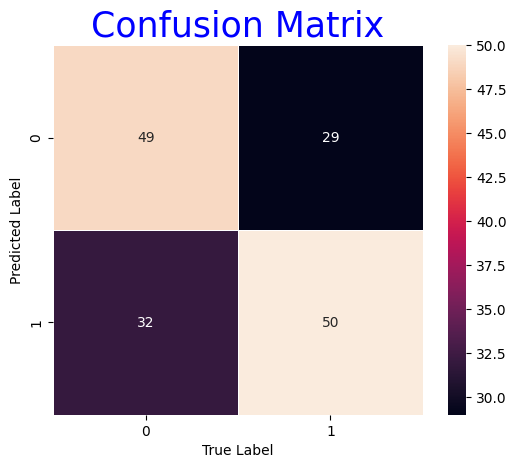

In [ ]:
# @title Fast Dev: run a small batch to see that everything works fine
# initialize the trainer

trainer = L.Trainer(fast_dev_run=5,   # 5 batches
                    accelerator="auto",
                    gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

                    )
trainer.fit(model=sg_model, datamodule=sg_data)
# trainer.validate(model=gatr_model, datamodule=gatr_data)
trainer.test(model=sg_model, datamodule=sg_data)


In [ ]:
# @title Optuna Hyperparameter Tuning

# Delete the tensorboard logs dir if it already exists to not accumulate logs from multiple runs
!rm -rf lightning_logs/

class OptunaHPTuner(BaseHPTuner):
    def __init__(self,
                 model_class:Callable=SimpleGATr,
                 study_name:str="optuna_study",
                 num_epochs:int=config.num_epochs,
                 num_trials:int=10,
                 direction:str="maximize" if config.monitor_mode == "max" else "minimize"
                 ):
        super().__init__(model_class, num_epochs=num_epochs, num_trials=num_trials, study_name=study_name)
        self.direction = direction
        self.study: optuna.study.Study = optuna.create_study(study_name=study_name, direction=direction, pruner=optuna.pruners.MedianPruner())

    def objective_function(self, trial):
        # Define the hyperparameters to be optimized

        # Create your datamodule
        datamodule = GATrDataModule(train_data=X_train,
                                    val_data=val_train,
                                    test_data=X_test,
                                    batch_size = trial.suggest_int("batch_size", 32, 64, step=32), # 24, 40, step=8,
                                    num_items=config.num_items,
                                    aggr_func = trial.suggest_categorical("aggr_func", [avg_bins, take_n]),
                                    normalize = trial.suggest_categorical("normalize_data", [True, False]),
                                    )

        # Create your model and configure it with the suggested hyperparameters
        model = self.model_class(
                input_mv_channels = config.input_mv_channels,
                hidden_mv_channels = 4, #trial.suggest_int("hidden_mv_channels", 4, 8, step=4)
                output_mv_channels = 16,
                input_s_channels = 1,
                hidden_s_channels = 4, #trial.suggest_int("hidden_s_channels", 4, 8, step=4),
                output_s_channels = 1, #trial.suggest_int("output_s_channels", 4, 8, step=4),
                use_scalar_hidden = trial.suggest_categorical("use_scalar_hidden", [True, False]),
                num_items = config.num_items,
                num_classes = 1,
                times_n = trial.suggest_int("times_n", 1, 2, step=1),
                normalize = trial.suggest_categorical("normalize_basis_elements", [False, True]), # normalize basis elements
                bias = trial.suggest_categorical("bias", [False, True]), # bias in linear layer or the weights w and v
                activation_fn = "gelu", #trial.suggest_categorical("activation_fn", ["gelu", "relu"]),
                lr = trial.suggest_float("lr", 1e-7, 3e-4, log=True),
                lr_sched = trial.suggest_categorical("lr_sched", ["cosine", "plateau"]),
                scheduler_patience = config.scheduler_patience,
                scheduler_factor = config.scheduler_factor,
                monitor = config.monitor,
                optimizer_fn = torch.optim.AdamW,
                loss_fn = torch.nn.BCEWithLogitsLoss,
            )

        # Configure your PyTorch Lightning Trainer
        # callbacks = [PyTorchLightningPruningCallback(trial, monitor="val_f1_score")]
        # trainer = L.Trainer(max_epochs=1, callbacks=callbacks, logger=True)
        trainer = L.Trainer(
                logger=False, #loggers.TensorBoardLogger("lightning_logs", name=self.study_name+"_tuner_"+str(trial.number)),
                callbacks=[PyTorchLightningPruningCallback(trial, monitor=config.monitor)],
                accelerator="auto",             # 'cpu', 'gpu', tpu', etc
                devices="auto",                 # num devices: 1, 2, 3, 4, ... or specify which one(s) [0], [2], [3, 5, 6], etc
                enable_checkpointing=False,
                deterministic=True,
                max_epochs=1,
                gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

            )

        # Train and validate your model
        trainer.fit(model, datamodule)

        # Retrieve the metric you want to optimize
        metric = trainer.callback_metrics[config.monitor].item()

        return metric

    def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):

        self.num_epochs = num_epochs if num_epochs is not None else self.num_epochs
        self.num_trials = num_trials if num_trials is not None else self.num_trials

        self.study.optimize(self.objective_function, n_trials=self.num_trials, show_progress_bar=True)
        self.best_trial = self.study.best_trial

        print(f"Best trial: {self.best_trial.values}")
        print(f"Best value: {self.best_trial.value}")

        # No need to return bec it is accessible after tuning.
        self.best_params = self.best_trial.params
        print("\nBest Params: ")
        for key, value in self.best_params.items():
            print(f"\t{key}: {value}")


# Demo
optuna_tuner = OptunaHPTuner(SimpleGATr)
optuna_tuner.tune()
# optuna_tuner.tune(num_epochs=1, num_trials=1)

[I 2024-05-27 02:50:45,100] A new study created in memory with name: optuna_study


  0%|          | 0/1 [00:00<?, ?it/s]

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name               | Type              | Params
---------------------------------------------------------
0 | equi_linear_blocks | ModuleList        | 465   
1 | last_classifier    | Linear            | 401   
2 | loss_fn            | BCEWithLogitsLoss | 0     
---------------------------------------------------------
866       Trainable params
0         N

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


[I 2024-05-27 02:54:10,088] Trial 0 finished with value: 0.695754885673523 and parameters: {'batch_size': 64, 'aggr_func': <function avg_bins at 0x7b82809e1870>, 'normalize_data': False, 'use_scalar_hidden': False, 'times_n': 1, 'normalize_basis_elements': True, 'bias': False, 'lr': 0.00015994919171339917, 'lr_sched': 'plateau'}. Best is trial 0 with value: 0.695754885673523.
Best trial: [0.695754885673523]
Best value: 0.695754885673523

Best Params: 
	batch_size: 64
	aggr_func: <function avg_bins at 0x7b82809e1870>
	normalize_data: False
	use_scalar_hidden: False
	times_n: 1
	normalize_basis_elements: True
	bias: False
	lr: 0.00015994919171339917
	lr_sched: plateau


In [ ]:
optuna_tuner.best_params

{'batch_size': 64,
 'aggr_func': <function __main__.avg_bins(arr: numpy.ndarray, n_items: int)>,
 'normalize_data': False,
 'use_scalar_hidden': False,
 'times_n': 1,
 'normalize_basis_elements': True,
 'bias': False,
 'lr': 0.00015994919171339917,
 'lr_sched': 'plateau'}

In [ ]:
# @title Train Optuna Model with tuned hyperparameters
optuna_tuner.train(num_epochs=config.num_epochs)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name               | Type              | Params
---------------------------------------------------------
0 | equi_linear_blocks | ModuleList        | 516   
1 | last_classifier    | Linear            | 401   
2 | loss_fn            | BCEWithLogitsLoss | 0     
---------------------------------------------------------
917       Trainable params
0         N

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved. New best score: 0.704
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 0.704


Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved by 0.006 >= min_delta = 0.0. New best score: 0.698
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 0.006 >= min_delta = 0.0. New best score: 0.698
INFO: `Trainer.fit` stopped: `max_epochs=2` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=2` reached.


INFO: Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v1.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v1.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v1.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v1.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 54.1250%.

classification_report: 
              precision    recall  f1-score   support

           0       0.54      0.55      0.55       400
           1       0.54      0.53      0.54       400

    accuracy                           0.54       800
   macro avg       0.54      0.54      0.54       800
weighted avg       0.54      0.54      0.54       800




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.5412499904632568     │
│       test_f1_score       │    0.5340128540992737     │
│         test_loss         │    0.6943359971046448     │
└───────────────────────────┴───────────────────────────┘

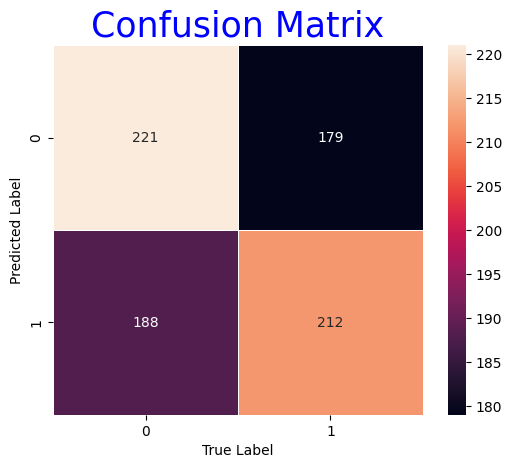

In [ ]:
# @title Test Optuna Model
optuna_tuner.test()

In [ ]:
# @title Tensorboard
%load_ext tensorboard
%tensorboard --logdir lightning_logs

# Geometric Bilinear *Model*

In [ ]:
mv_sample = torch.rand((32, 100, 3, 16)).to(config.device)
scalar_sample = torch.rand((32, 100, 1)).to(config.device)

ref = torch.rand((32, 1, 1, 16)).to(config.device)

layer = GATrGeometricBilinear(
    input_mv_channels=3,
    output_mv_channels=3,
    input_scalar_channels=1,
    output_scalar_channels=1,
    use_scalar_hidden=True,
    normalize=True,
    bias=True)
layer.to(config.device)

mv, scalar = layer(mv_sample, ref, scalar_sample)
print(f"Shapes: \nMV: {mv.shape} \tS: {scalar.shape if scalar is not None else 'None'}")
print(f"mv: \n\t{mv[0, 56, 1, :]} \nScalar: \n\t{scalar[0, 56, :] if scalar is not None else 'None'}")

Shapes: 
MV: torch.Size([32, 100, 3, 16]) 	S: torch.Size([32, 100, 1])
mv: 
	tensor([ 0.9015,  2.9419, -0.5131, -0.0554,  0.0155, -0.9584,  0.1597,  0.6799,
        -0.0827,  0.1017, -0.1596, -0.0549,  0.1417, -0.1501,  0.0215, -0.5368],
       device='cuda:0', grad_fn=<SliceBackward0>) 
Scalar: 
	tensor([-0.8062], device='cuda:0', grad_fn=<SliceBackward0>)


In [ ]:
# @title SImple model
# Read the Lightning docs to know what can be included here
# Link: https://lightning.ai/docs/pytorch/stable/common/lightning_module.html

# define the LightningModule
class SimpleBilinear(L.LightningModule):

    def __init__(
        self,
        input_mv_channels: Optional[int]=config.input_mv_channels,
        hidden_mv_channels: Optional[int]=16,
        output_mv_channels: Optional[int]=1,
        input_s_channels: Optional[int] = None,
        hidden_s_channels: Optional[int] = None,
        output_s_channels: Optional[int] = None,
        use_scalar_hidden: Optional[bool] = False,
        num_items: Optional[int] = config.num_items,
        num_classes: Optional[int] = 1,  # binary classification with 2 labels
        times_n: int = 1,
        normalize: Optional[bool] = False,
        bias: Optional[bool] = True,
        activation_fn: Optional[str] = "gelu",
        lr: Optional[float]=config.lr,
        scheduler_patience: Optional[int] = config.scheduler_patience,
        scheduler_factor: Optional[float] = config.scheduler_factor,
        monitor: Optional[str] = config.monitor,
        optimizer_fn: Optional[torch.optim.Optimizer] = torch.optim.AdamW,
        lr_sched = "plateau",
        loss_fn = torch.nn.BCEWithLogitsLoss
    ):
        super(SimpleBilinear, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.lr = lr
        self.scheduler_patience = scheduler_patience
        self.scheduler_factor = scheduler_factor
        self.monitor = monitor
        self.times_n = times_n

        #-----------------------------------------------------------------------
        # Define layers
        # Equivariant Linear layer
        self.equi_linear_layer_1 = GATrEquiLinear(
            multi_vec_in=input_mv_channels,
            multi_vec_out=output_mv_channels,
            scalar_in=input_s_channels,
            scalar_out=output_s_channels if input_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        # Equivariant bilinear layer
        self.equi_bilinear_blocks = nn.ModuleList([
            GATrGeometricBilinear(
                input_mv_channels = output_mv_channels, #input_mv_channels if i == 0 else hidden_mv_channels,
                output_mv_channels = output_mv_channels, #hidden_mv_channels if i != times_n-1 else output_mv_channels,
                input_scalar_channels = output_s_channels, #input_s_channels if i == 0 else hidden_s_channels,
                output_scalar_channels = output_s_channels, #hidden_s_channels if i != times_n-1 else output_s_channels,
                use_scalar_hidden=True,
                normalize=normalize,
                bias=bias
            )
            for i in range(times_n)
        ])

        self.equi_linear_2 = GATrEquiLinear(
            multi_vec_in=output_mv_channels,
            multi_vec_out=output_mv_channels,
            scalar_in=output_s_channels,
            scalar_out=output_s_channels if hidden_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        self.last_classifier = nn.Linear(in_features=num_items * 4, out_features=num_classes)
        #-----------------------------------------------------------------------

        try:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr, weight_decay=1e-2)
        except:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr)

        self.lr_scheduler_fn = torch.optim.lr_scheduler.CosineAnnealingLR if lr_sched == "consine" else torch.optim.lr_scheduler.ReduceLROnPlateau
        self.loss_fn = loss_fn()

        self.apply(self._init_weights)

    def forward(self, multivectors, scalars, flatten=False):

        mv_in, s_in = self.equi_linear_layer_1(multivectors, scalars)

        # Reference multivector
        ref = torch.mean(mv_in, keepdim=True, dim=(1,2))
        for i in range(self.times_n):
            # mv_in, s_in = self.equi_linear_blocks(multivectors, scalars)
            mv_in, s_in = self.equi_bilinear_blocks[i](mv_in, ref, s_in)

        # TODO: don't throw away the scalars
        mv_2, s_2 = self.equi_linear_2(mv_in, s_in)

        # shape: (batch_size, num_items, in_mv_channels, out_mv_channels) -> (batch_size, (num_items * 4))
        if flatten:
            mv_out = mv_in.view(mv_2.shape[0], -1)
        else:
            mv_out = mv_2[:, :, 0, [1, 2, 3, 4]].squeeze()
            mv_out = rearrange(mv_out, "a b c -> a (b c)")

        logits = self.last_classifier(mv_out)

        return logits.flatten()

    @staticmethod
    def _init_weights(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.kaiming_normal_(m.weight)
            if m.bias is not None:
                torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            torch.nn.init.constant_(m.weight, 1)
            torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Embedding):
            torch.nn.init.normal_(m.weight, mean=0, std=0.01)
        elif isinstance(m, nn.Parameter):
            torch.nn.init.uniform_(m, a=-0.1, b=0.1)
        # Add more initializations as needed

    def training_step(self, batch, batch_idx):
        """training_step defines the train loop.

        `training_step` must return a Tensor, a dict, or None.
        """
        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="train")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def validation_step(self, batch, batch_idx):
        """When the validation_step() is called, the model has been put in eval mode and
        PyTorch gradients have been disabled. At the end of validation, the model goes back to
        training mode and gradients are enabled
        """

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="val")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def test_step(self, batch, batch_idx):
        """test_step defines the test loop."""

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="test")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def on_test_start(self):
        # Track predictions and targets. Will be populated at the end of the test
        self.preds = []
        self.targets = []

    def on_test_end(self):
        confusion_matrix_score(self.targets, self.preds)
        self.preds.clear()
        self.targets.clear()

    def get_loss_outputs_labels(self,
                                batch,
                                stage: Literal['train', 'val', 'test'] = 'train'
                                ) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
        """Get loss, outputs, and labels from a batch

        Args:
            batch (torch.Tensor): Batch of data from the dataloader
            stage (str): 'train', 'val', or 'test'

        Returns:
            tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]: Loss, outputs, and labels
        """

        x_mv, x_s, y = batch
        x_mv = x_mv.to(self.device) # Shape: [batch_size, num_items, 3, 16] -> [256, 100, 3, 16]
        x_s = x_s.to(self.device)   # Shape:[batch_size, num_items, 1] -> [256, 100, 1]
        y = y.to(self.device)       # Shape: [batch_size] -> [256]

        logits = self.forward(x_mv, x_s) #.softmax(dim=1) Shape: [batch_size, num_classes] -> [256, 2]

        loss = self.loss_fn(logits, y.float())
        # self.log(f"{stage}_loss", loss, on_step=True, prog_bar=True, logger=True)

        # calculate acc
        labels_hat = torch.round(torch.sigmoid(logits)) # Shape: [batch_size] -> [256]
        # acc = torch.sum(y == labels_hat).item() / (len(y) * 1.0)
        acc_mean = (y==labels_hat).cpu().numpy().mean() # float

        if stage == 'test':
            self.preds.extend(labels_hat.cpu().tolist())
            self.targets.extend(y.cpu().tolist())

        # F1 score
        f1_score_fn = F1Score(task="binary", num_classes=2).to(y.device)
        f1_score = f1_score_fn(labels_hat, y) # takes ints, not floats

        # class_roc_auc = auroc(x_hat, y, task='multiclass', num_classes=num_classes)
        # for i in range(num_classes):
        #     class_roc_auc = auroc(x_hat, y)
        #     self.log(f"{i}-auroc", class_roc_auc, on_step=True, prog_bar=True, logger=True)

        # log the outputs!
        self.log_dict({f'{stage}_loss': loss, f'{stage}_acc': acc_mean, f'{stage}_f1_score': f1_score}, prog_bar=True, logger=True) # on_step=True, on_epoch=True)

        return loss, acc_mean, f1_score

    def configure_optimizers(self):
        return {
            "optimizer": self.optimizer_fn,
            "lr_scheduler": {
                "scheduler": torch.optim.lr_scheduler.ReduceLROnPlateau(
                    self.optimizer_fn, patience=self.scheduler_patience, factor=self.scheduler_factor, verbose=True
                ),
                "monitor": self.monitor, #"val_loss",
            },
        }

    def num_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)


In [ ]:
# @title Construct Model and Data

bi_data = construct_data()
print(f"Data Module training data len: { len(bi_data.train_data) }", end="\t")

bi_model = construct_model(SimpleBilinear)
print(f"Num params: {bi_model.num_parameters()}")
print(f"\nModel Construction: \n{bi_model}")

Data Module training data len: 2559	Num params: 18549

Model Construction: 
SimpleBilinear(
  (equi_linear_layer_1): GATrEquiLinear(
    (multi_vec_2_multi_vec): GATrMultivectorLayer()
    (scalar_2_multi_vec): GATrScalarLayer(in_features=1, out_features=16, bias=False)
    (multi_vec_2_scalar): GATrScalarLayer(in_features=16, out_features=4, bias=False)
    (scalar_2_scalar): GATrScalarLayer(in_features=1, out_features=4, bias=False)
  )
  (equi_bilinear_blocks): ModuleList(
    (0-1): 2 x GATrGeometricBilinear(
      (geo_prod_linear_x): GATrEquiLinear(
        (multi_vec_2_multi_vec): GATrMultivectorLayer()
        (scalar_2_multi_vec): GATrScalarLayer(in_features=4, out_features=8, bias=False)
        (multi_vec_2_scalar): GATrScalarLayer(in_features=8, out_features=4, bias=False)
        (scalar_2_scalar): GATrScalarLayer(in_features=4, out_features=4, bias=False)
      )
      (geo_prod_linear_y): GATrEquiLinear(
        (multi_vec_2_multi_vec): GATrMultivectorLayer()
        (sc

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO:lightning.pytorch.utilities.rank_zero:Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name                 | Type              | Params
-------------------

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_steps=5` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 33.7500%.

classification_report: 
              precision    recall  f1-score   support

           0       0.39      0.64      0.49        78
           1       0.12      0.05      0.07        82

    accuracy                           0.34       160
   macro avg       0.26      0.34      0.28       160
weighted avg       0.25      0.34      0.27       160




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.3375000059604645     │
│       test_f1_score       │    0.06482720375061035    │
│         test_loss         │         1509525.5         │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 1509525.5,
  'test_acc': 0.3375000059604645,
  'test_f1_score': 0.06482720375061035}]

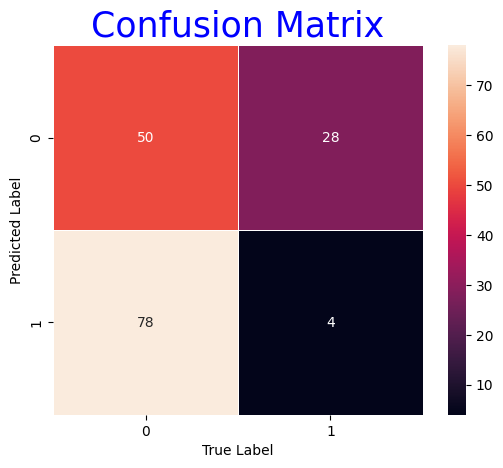

In [ ]:
# @title Fast Dev: run a small batch to see that everything works fine
# initialize the trainer

trainer = L.Trainer(fast_dev_run=5,   # 5 batches
                    accelerator="auto",
                    gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

                    )
trainer.fit(model=bi_model, datamodule=bi_data)
# trainer.validate(model=gatr_model, datamodule=gatr_data)
trainer.test(model=bi_model, datamodule=bi_data)


In [ ]:
# @title Optuna Hyperparameter Tuning for Bilinear Model

optuna_tuner = OptunaHPTuner(SimpleBilinear)
optuna_tuner.tune()
# optuna_tuner.tune(num_epochs=1, num_trials=1)

[I 2024-05-27 03:16:03,745] A new study created in memory with name: optuna_study


  0%|          | 0/1 [00:00<?, ?it/s]

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name                 | Type              | Params
-----------------------------------------------------------
0 | equi_linear_layer_1  | GATrEquiLinear    | 481   
1 | equi_bilinear_blocks | ModuleList        | 7.1 K 
2 | equi_linear_2        | GATrEquiLinear    | 2.4 K 
3 | last_classifier      | Linear            | 401   
4 | loss_fn              | BCEWi

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


[I 2024-05-27 03:20:52,095] Trial 0 finished with value: 702.1034545898438 and parameters: {'batch_size': 64, 'aggr_func': <function avg_bins at 0x7b82809e1870>, 'normalize_data': True, 'use_scalar_hidden': True, 'times_n': 1, 'normalize_basis_elements': False, 'bias': True, 'lr': 1.076365711508903e-06, 'lr_sched': 'plateau'}. Best is trial 0 with value: 702.1034545898438.
Best trial: [702.1034545898438]
Best value: 702.1034545898438

Best Params: 
	batch_size: 64
	aggr_func: <function avg_bins at 0x7b82809e1870>
	normalize_data: True
	use_scalar_hidden: True
	times_n: 1
	normalize_basis_elements: False
	bias: True
	lr: 1.076365711508903e-06
	lr_sched: plateau


In [ ]:
optuna_tuner.best_params

{'batch_size': 64,
 'aggr_func': <function __main__.avg_bins(arr: numpy.ndarray, n_items: int)>,
 'normalize_data': False,
 'use_scalar_hidden': False,
 'times_n': 2,
 'normalize_basis_elements': False,
 'bias': True,
 'lr': 9.783128512634017e-06,
 'lr_sched': 'plateau'}

In [ ]:
# @title Train Optuna Model with tuned hyperparameters
optuna_tuner.train(num_epochs=config.num_epochs)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name                 | Type              | Params
-----------------------------------------------------------
0 | equi_linear_layer_1  | GATrEquiLinear    | 532   
1 | equi_bilinear_blocks | ModuleList        | 7.6 K 
2 | equi_linear_2        | GATrEquiLinear    | 2.5 K 
3 | last_classifier      | Linear            | 401   
4 | loss_fn              | BCEWi

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved. New best score: 121.697
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 121.697


Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved by 0.284 >= min_delta = 0.0. New best score: 121.413
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 0.284 >= min_delta = 0.0. New best score: 121.413
INFO: `Trainer.fit` stopped: `max_epochs=2` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=2` reached.


INFO: Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v2.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v2.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v2.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v2.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 33.8750%.

classification_report: 
              precision    recall  f1-score   support

           0       0.40      0.65      0.49       400
           1       0.08      0.03      0.05       400

    accuracy                           0.34       800
   macro avg       0.24      0.34      0.27       800
weighted avg       0.24      0.34      0.27       800




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.3387500047683716     │
│       test_f1_score       │    0.04775571823120117    │
│         test_loss         │     140.7139434814453     │
└───────────────────────────┴───────────────────────────┘

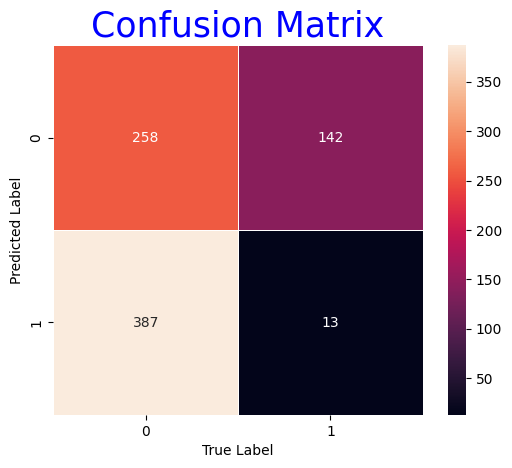

In [ ]:
# @title Test Optuna Model
optuna_tuner.test()

In [ ]:
# @title Tensorboard
%load_ext tensorboard
%tensorboard --logdir lightning_logs

# Equivariant LSTM Linear Model

In [ ]:
mv = torch.rand((32, 100, 3, 16)).to(config.device)
scalar = torch.rand((32, 100, 1)).to(config.device)

layer = GATrGatedActivation('sigmoid')
layer.to(config.device)

gated_multi_vec, gated_scalar = layer(mv, scalar)
print(f"Gated multivector shape: {gated_multi_vec.shape}, \t Gated scalar shape: {gated_scalar.shape}")
print(f"Gated multivector: \n\t{gated_multi_vec[0, 56, 1, :]} \nGated scalar: {gated_scalar[0, 56, 0]}")

Gated multivector shape: torch.Size([32, 100, 3, 16]), 	 Gated scalar shape: torch.Size([32, 100, 1])
Gated multivector: 
	tensor([0.7007, 0.2245, 0.2619, 0.5683, 0.4603, 0.3296, 0.5663, 0.1514, 0.0644,
        0.2892, 0.1559, 0.0385, 0.4047, 0.6974, 0.5527, 0.6994],
       device='cuda:0') 
Gated scalar: 0.6104132533073425


In [ ]:
# @title EquiLinear LSTM Cell

class GATrEquiLinearLSTMCell(nn.Module):
    """
    GATrEquiLinearLSTMCell is a single LSTM cell that respects the equivariant properties in Pin(3,0,1).
    It uses the GATrEquiLinear layer to compute the input gate, forget gate, cell gate, and output gate.

    Args:
        input_mv_channels (int): Number of input multivector channels.
        input_s_channels (int): Number of input scalar channels.
        hidden_mv_channels (int): Number of hidden multivector channels.
        hidden_s_channels (int): Number of hidden scalar channels.
        normalize (bool): Whether to normalize the basis elements in the GATrEquiLinear layer.
        bias (bool): Whether to use bias in the GATrEquiLinear layer.

    Attributes:
        input_gate (GATrEquiLinear): GATrEquiLinear layer for computing the input gate.
        forget_gate (GATrEquiLinear): GATrEquiLinear layer for computing the forget gate.
        cell_gate (GATrEquiLinear): GATrEquiLinear layer for computing the cell gate.
        output_gate (GATrEquiLinear): GATrEquiLinear layer for computing the output gate.
    """

    def __init__(self, input_mv_channels=3, input_s_channels=1, hidden_mv_channels=4, hidden_s_channels=4, normalize=False, bias=True):
        super(GATrEquiLinearLSTMCell, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.input_gate = GATrEquiLinear(
            multi_vec_in=input_mv_channels + hidden_mv_channels,
            multi_vec_out=hidden_mv_channels,
            scalar_in=input_s_channels + hidden_s_channels,
            scalar_out=hidden_s_channels,
            normalize=normalize,
            bias=bias
        )

        self.forget_gate = GATrEquiLinear(
            multi_vec_in=input_mv_channels + hidden_mv_channels,
            multi_vec_out=hidden_mv_channels,
            scalar_in=input_s_channels + hidden_s_channels,
            scalar_out=hidden_s_channels,
            normalize=normalize,
            bias=bias
        )

        self.cell_gate = GATrEquiLinear(
            multi_vec_in=input_mv_channels + hidden_mv_channels,
            multi_vec_out=hidden_mv_channels,
            scalar_in=input_s_channels + hidden_s_channels,
            scalar_out=hidden_s_channels,
            normalize=normalize,
            bias=bias
        )

        self.output_gate = GATrEquiLinear(
            multi_vec_in=input_mv_channels + hidden_mv_channels,
            multi_vec_out=hidden_mv_channels,
            scalar_in=input_s_channels + hidden_s_channels,
            scalar_out=hidden_s_channels,
            normalize=normalize,
            bias=bias
        )

        self.gatr_sigmoid = GATrGatedActivation('sigmoid') #nn.Sigmoid()
        self.gatr_tanh = GATrGatedActivation('tanh') #nn.Tanh()

    def forward(self, x_mv, x_s, h_mv, c_mv, h_s, c_s):
        """
        Forward pass of the GATrEquiLinearLSTMCell.

        Args:
            x_mv (torch.Tensor): Input multivector tensor of shape (batch_size, num_items, in_mv_channels, out_channels).
            x_s (torch.Tensor): Input scalar tensor of shape (batch_size, num_items, in_s_channels).
            h_mv (torch.Tensor): Previous hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor): Previous cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s (torch.Tensor): Previous hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor): Previous cell scalar state of shape (batch_size, num_items, hidden_s_channels).

        Returns:
            h_mv_next (torch.Tensor): Next hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv_next (torch.Tensor): Next cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s_next (torch.Tensor): Next hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s_next (torch.Tensor): Next cell scalar state of shape (batch_size, num_items, hidden_s_channels).
        """

        # Concatenate input and previous hidden state
        combined_mv = torch.cat([x_mv, h_mv], dim=-2)  # (batch_size, num_items, in_mv_channels + hidden_mv_channels, out_channels)
        combined_s = torch.cat([x_s, h_s], dim=-1)    # (batch_size, num_items, in_s_channels + hidden_s_channels)
        # print(f"Shape of combined_mv: {combined_mv.shape}")
        # print(f"Shape of combined_s: {combined_s.shape}")

        # Compute gates
        i_mv, i_s = self.input_gate(combined_mv, combined_s)    # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)
        f_mv, f_s = self.forget_gate(combined_mv, combined_s)  # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)
        g_mv, g_s = self.cell_gate(combined_mv, combined_s)    # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)
        o_mv, o_s = self.output_gate(combined_mv, combined_s)  # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)

        # print(f"\nShapes: i_mv: {i_mv.shape}, i_s: {i_s.shape}")
        # print(f"Shapes: f_mv: {f_mv.shape}, f_s: {f_s.shape}")
        # print(f"Shapes: g_mv: {g_mv.shape}, g_s: {g_s.shape}")
        # print(f"Shapes: o_mv: {o_mv.shape}, o_s: {o_s.shape}\n")

        # Apply activation functions
        i_mv, i_s = self.gatr_sigmoid(i_mv, i_s)
        f_mv, f_s = self.gatr_sigmoid(f_mv, f_s)
        g_mv, g_s = self.gatr_tanh(g_mv, g_s)
        o_mv, o_s = self.gatr_sigmoid(o_mv, o_s)

        # print(f"\nShapes: i_mv: {i_mv.shape}, i_s: {i_s.shape}")
        # print(f"Shapes: f_mv: {f_mv.shape}, f_s: {f_s.shape}")
        # print(f"Shapes: g_mv: {g_mv.shape}, g_s: {g_s.shape}")
        # print(f"Shapes: o_mv: {o_mv.shape}, o_s: {o_s.shape}\n")

        # Compute next cell and hidden states
        # TODO: use geo equivariant methods
        c_mv_next = f_mv * c_mv + i_mv * g_mv   # (batch_size, num_items, hidden_mv_channels)
        h_mv_next = o_mv * torch.tanh(c_mv_next)  # (batch_size, num_items, hidden_mv_channels)
        c_s_next = f_s * c_s + i_s * torch.tanh(g_s)  # (batch_size, num_items, hidden_s_channels)
        h_s_next = o_s * torch.tanh(c_s_next)  # (batch_size, num_items, hidden_s_channels)

        return h_mv_next, c_mv_next, h_s_next, c_s_next


In [ ]:
# @title Test EquiLinear LSTM Cell
lstm_cell = GATrEquiLinearLSTMCell(input_mv_channels=3, input_s_channels=1, hidden_mv_channels=3, hidden_s_channels=1, normalize=False, bias=True)
lstm_cell.to(config.device)

x_mv = torch.randn(1, 10, 3, 16, device=config.device)
x_s = torch.randn(1, 10, 1, device=config.device)
h_mv = torch.randn(1, 10, 3, 16, device=config.device)
c_mv = torch.randn(1, 10, 3, 16, device=config.device)
h_s = torch.randn(1, 10, 1, device=config.device)
c_s = torch.randn(1, 10, 1, device=config.device)

h_mv_next, c_mv_next, h_s_next, c_s_next = lstm_cell(x_mv, x_s, h_mv, c_mv, h_s, c_s)

print(h_mv_next.shape, c_mv_next.shape, h_s_next.shape, c_s_next.shape)

torch.Size([1, 10, 3, 16]) torch.Size([1, 10, 3, 16]) torch.Size([1, 10, 1]) torch.Size([1, 10, 1])


In [ ]:
# @title Equivariant LSTM

class GATrEquiLinearLSTM(nn.Module):
    """
    GATrEquiLinearLSTM is an LSTM module that respects the equivariant properties in Pin(3,0,1).
    It consists of a stack of GATrEquiLinearLSTMCells.

    Args:
        input_mv_channels (int): Number of input multivector channels.
        input_s_channels (int): Number of input scalar channels.
        hidden_mv_channels (int): Number of hidden multivector channels.
        hidden_s_channels (int): Number of hidden scalar channels.
        num_layers (int): Number of LSTM layers.
        normalize (bool): Whether to normalize the basis elements in the GATrEquiLinear layers.
        bias (bool): Whether to use bias in the GATrEquiLinear layers.

    Attributes:
        lstm_cells (nn.ModuleList): List of GATrEquiLinearLSTMCell instances.
    """

    def __init__(self, num_classes:int, num_items:int,
                 input_mv_channels, input_s_channels,
                 output_mv_channels, output_s_channels,
                 num_layers=1, normalize=False, bias=True
                 ):
        super(GATrEquiLinearLSTM, self).__init__()

        self.input_mv_channels = input_mv_channels
        self.input_s_channels = input_s_channels
        self.output_mv_channels = output_mv_channels
        self.output_s_channels = output_s_channels
        self.num_layers = num_layers

        # self.lstm_cells = nn.ModuleList([
        #     GATrEquiLinearLSTMCell(input_mv_channels, input_s_channels, hidden_mv_channels, hidden_s_channels, normalize, bias)
        #     for _ in range(num_layers)
        # ])

         #-----------------------------------------------------------------------
        # Define layers
        # Equivariant Linear layer
        self.equi_linear_layer_1 = GATrEquiLinear(
            multi_vec_in=input_mv_channels + input_mv_channels,
            multi_vec_out=output_mv_channels + output_mv_channels,
            scalar_in=input_s_channels + input_s_channels,
            scalar_out=output_s_channels + output_s_channels if input_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        # Create multiple layers of GATrEquiLinearLSTMCell
        self.lstm_cells = nn.ModuleList([
            GATrEquiLinearLSTMCell(input_mv_channels,
                                   input_s_channels,
                                   output_mv_channels,
                                   output_s_channels,
                                   normalize, bias)
            for _ in range(num_layers)
        ])
        self.equi_linear_2 = GATrEquiLinear(
            multi_vec_in=output_mv_channels + output_mv_channels,
            multi_vec_out=output_mv_channels,
            scalar_in=output_s_channels + output_s_channels,
            scalar_out=output_s_channels if output_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        self.last_classifier = nn.Linear(in_features=num_items * 4, out_features=num_classes)
        #-----------------------------------------------------------------------


    def forward(self, x_mv, x_s, flatten=False): #, h_mv=None, c_mv=None, h_s=None, c_s=None, flatten=False):
        """
        Forward pass of the GATrEquiLinearLSTM.

        Args:
            x_mv (torch.Tensor): Input multivector tensor of shape (batch_size, num_items, in_mv_channels, out_channels).
            x_s (torch.Tensor): Input scalar tensor of shape (batch_size, num_items, in_s_channels).
            h_mv (torch.Tensor, optional): Initial hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor, optional): Initial cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s (torch.Tensor, optional): Initial hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor, optional): Initial cell scalar state of shape (batch_size, num_items, hidden_s_channels).

        Returns:
            h_mv (torch.Tensor): Final hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor): Final cell multivector state of shape
                    h_s (torch.Tensor, optional): Initial hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor, optional): Initial cell scalar state of shape (batch_size, num_items, hidden_s_channels).

        Returns:
            h_mv (torch.Tensor): Final hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor): Final cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s (torch.Tensor): Final hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor): Final cell scalar state of shape (batch_size, num_items, hidden_s_channels).
        """

        # Initialize hidden and cell states if not provided
        h_mv = torch.zeros(x_mv.shape, device=x_mv.device)  # Assuming x_mv shape is (batch_size, num_items, in_mv_channels, out_channels)
        c_mv = torch.zeros(x_mv.shape, device=x_mv.device)
        h_s = torch.zeros(x_s.shape, device=x_s.device)       # Assuming x_s shape is (batch_size, num_items, in_s_channels)
        c_s = torch.zeros(x_s.shape, device=x_s.device)

        #print shapes of all inputs in one line
        # print(f"\nShapes: x_mv: {x_mv.shape}, x_s: {x_s.shape}")
        # print(f"Shapes: h_mv: {h_mv.shape}, c_mv: {c_mv.shape}")
        # print(f"Shapes: h_s: {h_s.shape}, c_s: {c_s.shape}\n")

        # Concatenate x_mv and h_mv along the in_chan dimension
        cat_mv = torch.cat([x_mv, h_mv], dim=-2)  # Concatenate x_mv and h_mv along the in_chan dimension
        cat_s = torch.cat([x_s, h_s], dim=-1)
        mv_linear, s_linear = self.equi_linear_layer_1(cat_mv, cat_s)
        # print(f"equi_linear_layer_1 -> mv_linear: {mv_linear.shape}, s_linear: {s_linear.shape}")

        # Split the linear output into separate multivector and scalar outputs
        x_mv, h_mv = torch.split(mv_linear, self.input_mv_channels, dim=-2)
        x_s, h_s = torch.split(s_linear, self.output_s_channels, dim=-1)
        # print(f"\nsplit -> x_mv: {x_mv.shape}, h_mv: {h_mv.shape}")
        # print(f"split -> x_s: {x_s.shape}, h_s: {h_s.shape}\n")

        # Iterate through each layer
        for layer in range(self.num_layers):
            # Pass through the LSTM cell
            h_mv, c_mv, h_s, c_s = self.lstm_cells[layer](x_mv, x_s, h_mv, c_mv, h_s, c_s)

        # Concatenate the hidden and cell states
        # print(f"\n\nshapes of h_mv: {h_mv.shape}, c_mv: {c_mv.shape}, h_s: {h_s.shape}, c_s: {c_s.shape}\n")
        # print(f"Types of h_mv: {h_mv.dtype}, c_mv: {c_mv.dtype}, h_s: {h_s.dtype}, c_s: {c_s.dtype}\n\n")
        cat_mv = torch.cat([x_mv, h_mv], dim=-2)
        cat_s = torch.cat([x_s, h_s], dim=-1)
        mv_linear, s_linear = self.equi_linear_2(cat_mv, cat_s)
        # print(f"equi_linear_2 -> mv_linear: {mv_linear.shape}, s_linear: {s_linear.shape}")

        # shape: (batch_size, num_items, in_mv_channels, out_mv_channels) -> (batch_size, (num_items * 4))
        if flatten:
            mv_out = mv_in.view(mv_2.shape[0], -1)
        else:
            mv_out = mv_linear[:, :, 0, [1, 2, 3, 4]].squeeze()
            mv_out = rearrange(mv_out, "a b c -> a (b c)")

        logits = self.last_classifier(mv_out)


        return logits


In [ ]:
# @title Test EquiLinear LSTM

x_mv = torch.randn(2, 10, 3, 16, device=config.device)
x_s = torch.randn(2, 10, 1, device=config.device)
# h_mv = torch.randn(1, 3, 4, 16)
# c_mv = torch.randn(1, 3, 4, 16)
# h_s = torch.randn(1, 3, 1)
# c_s = torch.randn(1, 3, 1)

# Create an instance of GATrEquiLinearLSTM
equi_lstm = GATrEquiLinearLSTM(num_classes=2, num_items=10,
                               input_mv_channels=3, input_s_channels=1,
                               output_mv_channels=3, output_s_channels=1,
                               num_layers=2
                               )
equi_lstm.to(config.device)

# Forward pass through the equivariant LSTM
mv_out = equi_lstm(x_mv, x_s)

# Print shapes of final hidden and cell states
print(f"\nmv_out: {mv_out.shape}")



mv_out: torch.Size([2, 2])


In [ ]:
# @title Equivariant LSTM Lightning model
# Read the Lightning docs to know what can be included here
# Link: https://lightning.ai/docs/pytorch/stable/common/lightning_module.html

# define the LightningModule
class EquiLinearLSTM(L.LightningModule):

    def __init__(
        self,
        input_mv_channels: Optional[int]=config.input_mv_channels,
        output_mv_channels: Optional[int]=1,
        input_s_channels: Optional[int] = None,
        output_s_channels: Optional[int] = None,
        num_items: Optional[int] = config.num_items,
        num_classes: Optional[int] = 1,  # binary classification with 2 labels
        num_layers: int = 1,
        normalize: Optional[bool] = False,
        bias: Optional[bool] = True,
        activation_fn: Optional[str] = "gelu",
        lr: Optional[float]=config.lr,
        scheduler_patience: Optional[int] = config.scheduler_patience,
        scheduler_factor: Optional[float] = config.scheduler_factor,
        monitor: Optional[str] = config.monitor,
        optimizer_fn: Optional[torch.optim.Optimizer] = torch.optim.AdamW,
        lr_sched = "plateau",
        loss_fn = torch.nn.BCEWithLogitsLoss
    ):
        super(EquiLinearLSTM, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.lr = lr
        self.scheduler_patience = scheduler_patience
        self.scheduler_factor = scheduler_factor
        self.monitor = monitor
        self.num_layers = num_layers

        self.equi_lstm = GATrEquiLinearLSTM(num_classes=num_classes, num_items=num_items,
                               input_mv_channels=input_mv_channels, input_s_channels=input_s_channels,
                               output_mv_channels=output_mv_channels, output_s_channels=output_s_channels,
                               num_layers=num_layers
                               )

        try:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr, weight_decay=1e-2)
        except:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr)

        self.lr_scheduler_fn = torch.optim.lr_scheduler.CosineAnnealingLR if lr_sched == "cosine" else torch.optim.lr_scheduler.ReduceLROnPlateau
        self.loss_fn = loss_fn()

        self.apply(self._init_weights)

    def forward(self, multivectors, scalars, flatten=False):

        logits = self.equi_lstm(multivectors, scalars, flatten)

        return logits.flatten()

    @staticmethod
    def _init_weights(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.kaiming_normal_(m.weight)
            if m.bias is not None:
                torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            torch.nn.init.constant_(m.weight, 1)
            torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Embedding):
            torch.nn.init.normal_(m.weight, mean=0, std=0.01)
        elif isinstance(m, nn.Parameter):
            torch.nn.init.uniform_(m, a=-0.1, b=0.1)
        # Add more initializations as needed

    def training_step(self, batch, batch_idx):
        """training_step defines the train loop.

        `training_step` must return a Tensor, a dict, or None.
        """
        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="train")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def validation_step(self, batch, batch_idx):
        """When the validation_step() is called, the model has been put in eval mode and
        PyTorch gradients have been disabled. At the end of validation, the model goes back to
        training mode and gradients are enabled
        """

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="val")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def test_step(self, batch, batch_idx):
        """test_step defines the test loop."""

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="test")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def on_test_start(self):
        # Track predictions and targets. Will be populated at the end of the test
        self.preds = []
        self.targets = []

    def on_test_end(self):
        confusion_matrix_score(self.targets, self.preds)
        self.preds.clear()
        self.targets.clear()

    def get_loss_outputs_labels(self,
                                batch,
                                stage: Literal['train', 'val', 'test'] = 'train'
                                ) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
        """Get loss, outputs, and labels from a batch

        Args:
            batch (torch.Tensor): Batch of data from the dataloader
            stage (str): 'train', 'val', or 'test'

        Returns:
            tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]: Loss, outputs, and labels
        """

        x_mv, x_s, y = batch
        x_mv = x_mv.to(self.device) # Shape: [batch_size, num_items, 3, 16] -> [256, 100, 3, 16]
        x_s = x_s.to(self.device)   # Shape:[batch_size, num_items, 1] -> [256, 100, 1]
        y = y.to(self.device)       # Shape: [batch_size] -> [256]

        logits = self.forward(x_mv, x_s) #.softmax(dim=1) Shape: [batch_size, num_classes] -> [256, 2]

        loss = self.loss_fn(logits, y.float())
        # self.log(f"{stage}_loss", loss, on_step=True, prog_bar=True, logger=True)

        # calculate acc
        labels_hat = torch.round(torch.sigmoid(logits)) # Shape: [batch_size] -> [256]
        # acc = torch.sum(y == labels_hat).item() / (len(y) * 1.0)
        acc_mean = (y==labels_hat).cpu().numpy().mean() # float

        if stage == 'test':
            self.preds.extend(labels_hat.cpu().tolist())
            self.targets.extend(y.cpu().tolist())

        # F1 score
        f1_score_fn = F1Score(task="binary", num_classes=2).to(y.device)
        f1_score = f1_score_fn(labels_hat, y) # takes ints, not floats

        # class_roc_auc = auroc(x_hat, y, task='multiclass', num_classes=num_classes)
        # for i in range(num_classes):
        #     class_roc_auc = auroc(x_hat, y)
        #     self.log(f"{i}-auroc", class_roc_auc, on_step=True, prog_bar=True, logger=True)

        # log the outputs!
        self.log_dict({f'{stage}_loss': loss, f'{stage}_acc': acc_mean, f'{stage}_f1_score': f1_score}, prog_bar=True, logger=True) # on_step=True, on_epoch=True)

        return loss, acc_mean, f1_score

    def configure_optimizers(self):
        return {
            "optimizer": self.optimizer_fn,
            "lr_scheduler": {
                "scheduler": self.lr_scheduler_fn(
                    self.optimizer_fn, patience=self.scheduler_patience, factor=self.scheduler_factor
                ),
                "monitor": self.monitor, #"val_loss",
            },
        }

    def num_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)


In [ ]:
# @title Construct Model and Data

# @title Construct Model and Data

def construct_data(
        datamodule: GATrDataModule = GATrDataModule,
        X_train: pd.DataFrame = X_train,
        val_train: pd.DataFrame = val_train,
        X_test: pd.DataFrame = X_test,
        batch_size: int = config.batch_size,
        num_items: int = config.num_items,
        aggr_func: Union[avg_bins, take_n] = avg_bins,
        normalize_data: bool = True,
    ):

    gatr_datamodule = GATrDataModule(train_data=X_train,
                                      val_data=val_train,
                                      test_data=X_test,
                                      batch_size=batch_size,
                                      num_items=num_items,
                                      aggr_func=aggr_func,
                                      normalize=normalize_data,
                                      )
    return gatr_datamodule

def construct_model(
        model: Callable = GATr,
        input_mv_channels: int = config.input_mv_channels,
        output_mv_channels: int = config.input_mv_channels,
        input_s_channels: int = 1,
        output_s_channels: int = 1,
        num_items: int = config.num_items,
        num_classes: int = 1,
        num_layers: int = 2,
        normalize: bool = True, # normalize basis elements
        bias: bool = True,      # bias in linear layer or the weights w and v
        activation_fn: Literal['gelu', 'relu'] = 'gelu',
        lr: float = 3e-4,
        lr_sched: Literal['plateau', 'cosine'] = 'plateau',
        scheduler_patience: int = config.scheduler_patience,
        scheduler_factor: float = config.scheduler_factor,
        monitor: Literal['val_loss', 'val_acc'] = config.monitor,
        optimizer_fn: Union[torch.optim.AdamW, torch.optim.SGD] = torch.optim.AdamW,
        loss_fn = torch.nn.BCEWithLogitsLoss,
    ):

    # a dict of the function params
    params = {
        'input_mv_channels': input_mv_channels,
        'output_mv_channels': output_mv_channels,
        'input_s_channels': input_s_channels,
        'output_s_channels': output_s_channels,
        'num_items': num_items,
        'num_classes': num_classes,
        'num_layers': num_layers,
        'normalize': normalize,
        'bias': bias,
        'activation_fn': activation_fn,
        'lr': lr,
        'lr_sched': lr_sched,
        'scheduler_patience': scheduler_patience,
        'scheduler_factor': scheduler_factor,
        'monitor': monitor,
        'optimizer_fn': optimizer_fn,
        'loss_fn': loss_fn,
    }

    return model(**params)

eq_lstm_data = construct_data()
print(f"Data Module training data len: { len(eq_lstm_data.train_data) }", end="\t")

eq_lstm_model = construct_model(EquiLinearLSTM)
eq_lstm_model.to(config.device)

print(f"Num params: {eq_lstm_model.num_parameters()}")
print(f"\nModel Construction: \n{eq_lstm_model}")

Data Module training data len: 2559	Num params: 2343

Model Construction: 
EquiLinearLSTM(
  (equi_lstm): GATrEquiLinearLSTM(
    (equi_linear_layer_1): GATrEquiLinear(
      (multi_vec_2_multi_vec): GATrMultivectorLayer()
      (scalar_2_multi_vec): GATrScalarLayer(in_features=2, out_features=6, bias=False)
      (multi_vec_2_scalar): GATrScalarLayer(in_features=6, out_features=2, bias=False)
      (scalar_2_scalar): GATrScalarLayer(in_features=2, out_features=2, bias=False)
    )
    (lstm_cells): ModuleList(
      (0-1): 2 x GATrEquiLinearLSTMCell(
        (input_gate): GATrEquiLinear(
          (multi_vec_2_multi_vec): GATrMultivectorLayer()
          (scalar_2_multi_vec): GATrScalarLayer(in_features=2, out_features=3, bias=False)
          (multi_vec_2_scalar): GATrScalarLayer(in_features=3, out_features=1, bias=False)
          (scalar_2_scalar): GATrScalarLayer(in_features=2, out_features=1, bias=False)
        )
        (forget_gate): GATrEquiLinear(
          (multi_vec_2_mult

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO:lightning.pytorch.utilities.rank_zero:Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type               | Params
-----------------------------

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_steps=5` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 61.2500%.

classification_report: 
              precision    recall  f1-score   support

           0       0.58      0.73      0.65        78
           1       0.66      0.50      0.57        82

    accuracy                           0.61       160
   macro avg       0.62      0.62      0.61       160
weighted avg       0.62      0.61      0.61       160




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │     0.612500011920929     │
│       test_f1_score       │    0.5676948428153992     │
│         test_loss         │     1.468820571899414     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 1.468820571899414,
  'test_acc': 0.612500011920929,
  'test_f1_score': 0.5676948428153992}]

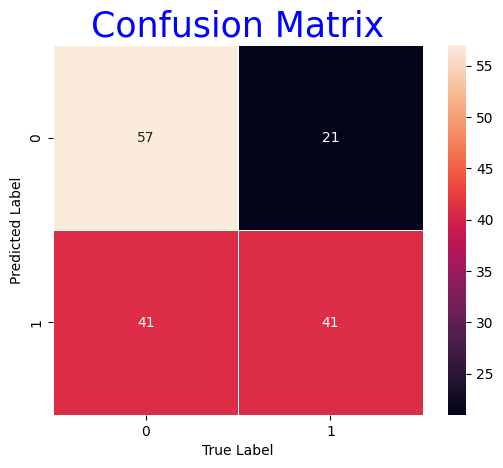

In [ ]:
# @title Fast Dev: run a small batch to see that everything works fine
# initialize the trainer

trainer = L.Trainer(fast_dev_run=5,   # 5 batches
                    accelerator="auto",
                    gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

                    )
trainer.fit(model=eq_lstm_model, datamodule=eq_lstm_data)
# trainer.validate(model=gatr_model, datamodule=gatr_data)
trainer.test(model=eq_lstm_model, datamodule=eq_lstm_data)


In [ ]:
# @title Optuna Hyperparameter Tuning for EquiLinearLSTM

# Delete the tensorboard logs dir if it already exists to not accumulate logs from multiple runs
!rm -rf lightning_logs/

class OptunaHPTuner(BaseHPTuner):
    def __init__(self,
                 model_class:Callable=SimpleGATr,
                 study_name:str="optuna_study",
                 num_epochs:int=config.num_epochs,
                 num_trials:int=10,
                 direction:str="maximize" if config.monitor_mode == "max" else "minimize"
                 ):
        super().__init__(model_class, num_epochs=num_epochs, num_trials=num_trials, study_name=study_name)
        self.direction = direction
        self.study: optuna.study.Study = optuna.create_study(study_name=study_name, direction=direction, pruner=optuna.pruners.MedianPruner())

    def objective_function(self, trial):
        # Define the hyperparameters to be optimized

        # Create your datamodule
        datamodule = GATrDataModule(train_data=X_train,
                                    val_data=val_train,
                                    test_data=X_test,
                                    batch_size = trial.suggest_int("batch_size", 32, 64, step=32), # 24, 40, step=8,
                                    num_items=config.num_items,
                                    aggr_func = trial.suggest_categorical("aggr_func", [avg_bins, take_n]),
                                    normalize = trial.suggest_categorical("normalize_data", [True, False]),
                                    )

        # Create your model and configure it with the suggested hyperparameters
        model = self.model_class(
                input_mv_channels = config.input_mv_channels,
                output_mv_channels = config.input_mv_channels,
                input_s_channels = 1,
                output_s_channels = 1, #trial.suggest_int("output_s_channels", 4, 8, step=4),
                num_items = config.num_items,
                num_classes = 1,
                num_layers = trial.suggest_int("times_n", 1, 2, step=1),
                normalize = trial.suggest_categorical("normalize_basis_elements", [False, True]), # normalize basis elements
                bias = trial.suggest_categorical("bias", [False, True]), # bias in linear layer or the weights w and v
                activation_fn = trial.suggest_categorical("activation_fn", ["gelu", "relu"]),
                lr = trial.suggest_float("lr", 1e-7, 1e-3, log=True),
                lr_sched = 'plateau', #trial.suggest_categorical("lr_sched", ["cosine", "plateau"]),
                scheduler_patience = config.scheduler_patience,
                scheduler_factor = config.scheduler_factor,
                monitor = config.monitor,
                optimizer_fn = torch.optim.AdamW,
                loss_fn = torch.nn.BCEWithLogitsLoss,
            )

        # Configure your PyTorch Lightning Trainer
        # callbacks = [PyTorchLightningPruningCallback(trial, monitor="val_f1_score")]
        # trainer = L.Trainer(max_epochs=1, callbacks=callbacks, logger=True)
        trainer = L.Trainer(
                logger=False, #loggers.TensorBoardLogger("lightning_logs", name=self.study_name+"_tuner_"+str(trial.number)),
                callbacks=[PyTorchLightningPruningCallback(trial, monitor=config.monitor)],
                accelerator="auto",             # 'cpu', 'gpu', tpu', etc
                devices="auto",                 # num devices: 1, 2, 3, 4, ... or specify which one(s) [0], [2], [3, 5, 6], etc
                enable_checkpointing=False,
                deterministic=True,
                max_epochs=1,
                gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

            )

        # Train and validate your model
        trainer.fit(model, datamodule)

        # Retrieve the metric you want to optimize
        metric = trainer.callback_metrics[config.monitor].item()

        return metric

    def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):

        self.num_epochs = num_epochs if num_epochs is not None else self.num_epochs
        self.num_trials = num_trials if num_trials is not None else self.num_trials

        self.study.optimize(self.objective_function, n_trials=self.num_trials, show_progress_bar=True)
        self.best_trial = self.study.best_trial

        print(f"Best trial: {self.best_trial.values}")
        print(f"Best value: {self.best_trial.value}")

        # No need to return bec it is accessible after tuning.
        self.best_params = self.best_trial.params
        print("\nBest Params: ")
        for key, value in self.best_params.items():
            print(f"\t{key}: {value}")


# Demo
optuna_tuner = OptunaHPTuner(EquiLinearLSTM)
optuna_tuner.tune()
# optuna_tuner.tune(num_epochs=1, num_trials=1)

[I 2024-05-27 03:54:31,980] A new study created in memory with name: optuna_study


  0%|          | 0/1 [00:00<?, ?it/s]

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type               | Params
-------------------------------------------------
0 | equi_lstm | GATrEquiLinearLSTM | 1.6 K 
1 | loss_fn   | BCEWithLogitsLoss  | 0     
-------------------------------------------------
1.6 K     Trainable params
0         Non-trainable params
1.6 K     Total params
0.007     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


[I 2024-05-27 04:00:40,547] Trial 0 finished with value: 1.9034345149993896 and parameters: {'batch_size': 64, 'aggr_func': <function avg_bins at 0x7b82809e1870>, 'normalize_data': True, 'times_n': 1, 'normalize_basis_elements': False, 'bias': True, 'activation_fn': 'relu', 'lr': 1.3416587921099198e-05}. Best is trial 0 with value: 1.9034345149993896.
Best trial: [1.9034345149993896]
Best value: 1.9034345149993896

Best Params: 
	batch_size: 64
	aggr_func: <function avg_bins at 0x7b82809e1870>
	normalize_data: True
	times_n: 1
	normalize_basis_elements: False
	bias: True
	activation_fn: relu
	lr: 1.3416587921099198e-05


In [ ]:
optuna_tuner.best_params


{'batch_size': 64,
 'aggr_func': <function __main__.avg_bins(arr: numpy.ndarray, n_items: int)>,
 'normalize_data': True,
 'times_n': 1,
 'normalize_basis_elements': False,
 'bias': True,
 'activation_fn': 'relu',
 'lr': 1.3416587921099198e-05}

In [ ]:
# @title Train Optuna Model with tuned hyperparameters
optuna_tuner.train(num_epochs=config.num_epochs)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type               | Params
-------------------------------------------------
0 | equi_lstm | GATrEquiLinearLSTM | 2.3 K 
1 | loss_fn   | BCEWithLogitsLoss  | 0     
-------------------------------------------------
2.3 K     Trainable params
0         Non-trainable params
2.3 K     Total params
0.009     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved. New best score: 5.661
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 5.661


Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved by 0.235 >= min_delta = 0.0. New best score: 5.426
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved by 0.235 >= min_delta = 0.0. New best score: 5.426
INFO: `Trainer.fit` stopped: `max_epochs=2` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=2` reached.


INFO: Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v3.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v3.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v3.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v3.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 42.5000%.

classification_report: 
              precision    recall  f1-score   support

           0       0.27      0.09      0.13       400
           1       0.46      0.76      0.57       400

    accuracy                           0.42       800
   macro avg       0.36      0.42      0.35       800
weighted avg       0.36      0.42      0.35       800




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.42500001192092896    │
│       test_f1_score       │    0.5683499574661255     │
│         test_loss         │     5.643925189971924     │
└───────────────────────────┴───────────────────────────┘

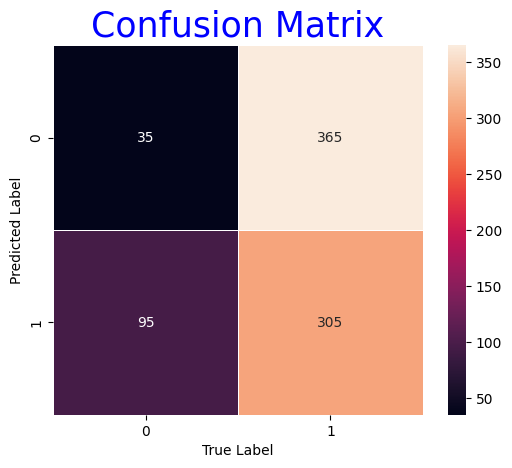

In [ ]:
# @title Test Optuna Model
optuna_tuner.test()

In [ ]:
# @title Tensorboard
%load_ext tensorboard
%tensorboard --logdir lightning_logs

---
---

# BiEquivariant LSTM Model

In [ ]:
# @title EquiLinear LSTM Cell

class GATrBiEquiLinearLSTMCell(nn.Module):
    """
    GATrEquiLinearLSTMCell is a single LSTM cell that respects the equivariant properties in Pin(3,0,1).
    It uses the GATrEquiLinear layer to compute the input gate, forget gate, cell gate, and output gate.

    Args:
        input_mv_channels (int): Number of input multivector channels.
        input_s_channels (int): Number of input scalar channels.
        hidden_mv_channels (int): Number of hidden multivector channels.
        hidden_s_channels (int): Number of hidden scalar channels.
        normalize (bool): Whether to normalize the basis elements in the GATrEquiLinear layer.
        bias (bool): Whether to use bias in the GATrEquiLinear layer.

    Attributes:
        input_gate (GATrEquiLinear): GATrEquiLinear layer for computing the input gate.
        forget_gate (GATrEquiLinear): GATrEquiLinear layer for computing the forget gate.
        cell_gate (GATrEquiLinear): GATrEquiLinear layer for computing the cell gate.
        output_gate (GATrEquiLinear): GATrEquiLinear layer for computing the output gate.
    """

    def __init__(self,
                 input_mv_channels=3,
                 input_s_channels=1,
                 hidden_mv_channels=4,
                 hidden_s_channels=4,
                 use_scalar_hidden=True,
                 normalize=False,
                 bias=True
                 ):
        super(GATrBiEquiLinearLSTMCell, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.input_gate = GATrGeometricBilinear(
            input_mv_channels=input_mv_channels * 2,
            output_mv_channels=hidden_mv_channels,
            input_scalar_channels=input_s_channels * 2,
            output_scalar_channels=hidden_s_channels,
            use_scalar_hidden=use_scalar_hidden,
            normalize=normalize,
            bias=bias
        )

        self.forget_gate = copy.deepcopy(self.input_gate)
        self.cell_gate = copy.deepcopy(self.input_gate)
        self.output_gate = copy.deepcopy(self.input_gate)

        self.gatr_sigmoid = GATrGatedActivation('sigmoid') #nn.Sigmoid()
        self.gatr_tanh = GATrGatedActivation('tanh') #nn.Tanh()

    def forward(self, x_mv, x_s, h_mv, c_mv, h_s, c_s):
        """
        Forward pass of the GATrEquiLinearLSTMCell.

        Args:
            x_mv (torch.Tensor): Input multivector tensor of shape (batch_size, num_items, in_mv_channels, out_channels).
            x_s (torch.Tensor): Input scalar tensor of shape (batch_size, num_items, in_s_channels).
            h_mv (torch.Tensor): Previous hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor): Previous cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s (torch.Tensor): Previous hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor): Previous cell scalar state of shape (batch_size, num_items, hidden_s_channels).

        Returns:
            h_mv_next (torch.Tensor): Next hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv_next (torch.Tensor): Next cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s_next (torch.Tensor): Next hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s_next (torch.Tensor): Next cell scalar state of shape (batch_size, num_items, hidden_s_channels).
        """

        # Concatenate input and previous hidden state
        combined_mv = torch.cat([x_mv, h_mv], dim=-2)  # (batch_size, num_items, in_mv_channels + hidden_mv_channels, out_channels)
        combined_s = torch.cat([x_s, h_s], dim=-1)    # (batch_size, num_items, in_s_channels + hidden_s_channels)
        # print(f"Shape of combined_mv: {combined_mv.shape}")
        # print(f"Shape of combined_s: {combined_s.shape}")

        # Reference multivector
        ref = torch.mean(combined_mv, keepdim=True, dim=(1,2))

        # Compute gates
        i_mv, i_s = self.input_gate(combined_mv, ref, combined_s)    # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)
        f_mv, f_s = self.forget_gate(combined_mv, ref, combined_s)  # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)
        g_mv, g_s = self.cell_gate(combined_mv, ref, combined_s)    # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)
        o_mv, o_s = self.output_gate(combined_mv, ref, combined_s)  # (batch_size, num_items, hidden_mv_channels), (batch_size, num_items, hidden_s_channels)

        # print(f"\nShapes: i_mv: {i_mv.shape}, i_s: {i_s.shape}")
        # print(f"Shapes: f_mv: {f_mv.shape}, f_s: {f_s.shape}")
        # print(f"Shapes: g_mv: {g_mv.shape}, g_s: {g_s.shape}")
        # print(f"Shapes: o_mv: {o_mv.shape}, o_s: {o_s.shape}\n")

        # Apply activation functions
        i_mv, i_s = self.gatr_sigmoid(i_mv, i_s)
        f_mv, f_s = self.gatr_sigmoid(f_mv, f_s)
        g_mv, g_s = self.gatr_tanh(g_mv, g_s)
        o_mv, o_s = self.gatr_sigmoid(o_mv, o_s)

        # print(f"\nShapes: i_mv: {i_mv.shape}, i_s: {i_s.shape}")
        # print(f"Shapes: f_mv: {f_mv.shape}, f_s: {f_s.shape}")
        # print(f"Shapes: g_mv: {g_mv.shape}, g_s: {g_s.shape}")
        # print(f"Shapes: o_mv: {o_mv.shape}, o_s: {o_s.shape}\n")

        # check for NoneType
        if h_mv is None:
            print("h_mv is None")
            h_mv = torch.zeros_like(i_mv, device=i_mv.device)
        if c_mv is None:
            print("c_mv is None")
            c_mv = torch.zeros_like(i_mv, device=i_mv.device)
        if h_s is None:
            print("h_s is None")
            h_s = torch.zeros_like(i_s, device=i_s.device)
        if c_s is None:
            print("c_s is None")
            c_s = torch.zeros_like(i_s, device=i_s.device)

        # Compute next cell and hidden states
        # TODO: use geo equivariant methods
        c_mv_next = f_mv * c_mv + i_mv * g_mv   # (batch_size, num_items, hidden_mv_channels)
        h_mv_next = o_mv * torch.tanh(c_mv_next)  # (batch_size, num_items, hidden_mv_channels)
        c_s_next = f_s * c_s + i_s * torch.tanh(g_s)  # (batch_size, num_items, hidden_s_channels)
        h_s_next = o_s * torch.tanh(c_s_next)  # (batch_size, num_items, hidden_s_channels)

        return h_mv_next, c_mv_next, h_s_next, c_s_next


In [ ]:
# @title Test EquiLinear LSTM Cell
lstm_cell = GATrBiEquiLinearLSTMCell(input_mv_channels=3,
                                    input_s_channels=1,
                                    hidden_mv_channels=3,
                                    hidden_s_channels=1,
                                    use_scalar_hidden=True,
                                    normalize=False,
                                    bias=True
                                    )
lstm_cell.to(device=config.device)

x_mv = torch.randn(1, 10, 3, 16, device=config.device)
x_s = torch.randn(1, 10, 1, device=config.device)
h_mv = torch.randn(1, 10, 3, 16, device=config.device)
c_mv = torch.randn(1, 10, 3, 16, device=config.device)
h_s = torch.randn(1, 10, 1, device=config.device)
c_s = torch.randn(1, 10, 1, device=config.device)

h_mv_next, c_mv_next, h_s_next, c_s_next = lstm_cell(x_mv, x_s, h_mv, c_mv, h_s, c_s)

print(h_mv_next.shape, c_mv_next.shape, h_s_next.shape, c_s_next.shape)

torch.Size([1, 10, 3, 16]) torch.Size([1, 10, 3, 16]) torch.Size([1, 10, 1]) torch.Size([1, 10, 1])


In [ ]:
# @title Equivariant LSTM

class GATrBiEquiLinearLSTM(nn.Module):
    """
    GATrEquiLinearLSTM is an LSTM module that respects the equivariant properties in Pin(3,0,1).
    It consists of a stack of GATrEquiLinearLSTMCells.

    Args:
        input_mv_channels (int): Number of input multivector channels.
        input_s_channels (int): Number of input scalar channels.
        hidden_mv_channels (int): Number of hidden multivector channels.
        hidden_s_channels (int): Number of hidden scalar channels.
        num_layers (int): Number of LSTM layers.
        normalize (bool): Whether to normalize the basis elements in the GATrEquiLinear layers.
        bias (bool): Whether to use bias in the GATrEquiLinear layers.

    Attributes:
        lstm_cells (nn.ModuleList): List of GATrEquiLinearLSTMCell instances.
    """

    def __init__(self, num_classes:int,
                 num_items:int,
                 input_mv_channels,
                 input_s_channels,
                 output_mv_channels,
                 output_s_channels,
                 num_layers=1,
                 use_scalar_hidden=False,
                 normalize=False,
                 bias=True
                 ):
        super(GATrBiEquiLinearLSTM, self).__init__()

        self.input_mv_channels = input_mv_channels
        self.input_s_channels = input_s_channels
        self.output_mv_channels = output_mv_channels
        self.output_s_channels = output_s_channels
        self.num_layers = num_layers

        # self.lstm_cells = nn.ModuleList([
        #     GATrEquiLinearLSTMCell(input_mv_channels, input_s_channels, hidden_mv_channels, hidden_s_channels, normalize, bias)
        #     for _ in range(num_layers)
        # ])

         #-----------------------------------------------------------------------
        # Define layers
        # Equivariant Linear layer
        self.equi_linear_layer_1 = GATrEquiLinear(
            multi_vec_in=input_mv_channels + input_mv_channels,
            multi_vec_out=output_mv_channels + output_mv_channels,
            scalar_in=input_s_channels + input_s_channels,
            scalar_out=output_s_channels + output_s_channels if input_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        # Create multiple layers of GATrEquiLinearLSTMCell
        self.lstm_cells = nn.ModuleList([
            GATrBiEquiLinearLSTMCell(input_mv_channels,
                                   input_s_channels,
                                   output_mv_channels,
                                   output_s_channels,
                                   use_scalar_hidden,
                                   normalize,
                                   bias
                                   )
            for _ in range(num_layers)
        ])
        self.equi_linear_2 = GATrEquiLinear(
            multi_vec_in=output_mv_channels + output_mv_channels,
            multi_vec_out=output_mv_channels,
            scalar_in=output_s_channels + output_s_channels,
            scalar_out=output_s_channels if output_s_channels is not None else None,
            normalize=normalize,
            bias=bias
        )

        self.last_classifier = nn.Linear(in_features=num_items * 4, out_features=num_classes)
        #-----------------------------------------------------------------------


    def forward(self, x_mv, x_s, flatten=False): #, h_mv=None, c_mv=None, h_s=None, c_s=None, flatten=False):
        """
        Forward pass of the GATrEquiLinearLSTM.

        Args:
            x_mv (torch.Tensor): Input multivector tensor of shape (batch_size, num_items, in_mv_channels, out_channels).
            x_s (torch.Tensor): Input scalar tensor of shape (batch_size, num_items, in_s_channels).
            h_mv (torch.Tensor, optional): Initial hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor, optional): Initial cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s (torch.Tensor, optional): Initial hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor, optional): Initial cell scalar state of shape (batch_size, num_items, hidden_s_channels).

        Returns:
            h_mv (torch.Tensor): Final hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor): Final cell multivector state of shape
                    h_s (torch.Tensor, optional): Initial hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor, optional): Initial cell scalar state of shape (batch_size, num_items, hidden_s_channels).

        Returns:
            h_mv (torch.Tensor): Final hidden multivector state of shape (batch_size, num_items, hidden_mv_channels).
            c_mv (torch.Tensor): Final cell multivector state of shape (batch_size, num_items, hidden_mv_channels).
            h_s (torch.Tensor): Final hidden scalar state of shape (batch_size, num_items, hidden_s_channels).
            c_s (torch.Tensor): Final cell scalar state of shape (batch_size, num_items, hidden_s_channels).
        """

        # Initialize hidden and cell states if not provided
        h_mv = torch.zeros(x_mv.shape, device=x_mv.device)  # Assuming x_mv shape is (batch_size, num_items, in_mv_channels, out_channels)
        c_mv = torch.zeros(x_mv.shape, device=x_mv.device)
        h_s = torch.zeros(x_s.shape, device=x_s.device)       # Assuming x_s shape is (batch_size, num_items, in_s_channels)
        c_s = torch.zeros(x_s.shape, device=x_s.device)

        #print shapes of all inputs in one line
        # print(f"\nShapes: x_mv: {x_mv.shape}, x_s: {x_s.shape}")
        # print(f"Shapes: h_mv: {h_mv.shape}, c_mv: {c_mv.shape}")
        # print(f"Shapes: h_s: {h_s.shape}, c_s: {c_s.shape}\n")

        # Concatenate x_mv and h_mv along the in_chan dimension
        cat_mv = torch.cat([x_mv, h_mv], dim=-2)  # Concatenate x_mv and h_mv along the in_chan dimension
        cat_s = torch.cat([x_s, h_s], dim=-1)
        mv_linear, s_linear = self.equi_linear_layer_1(cat_mv, cat_s)
        # print(f"equi_linear_layer_1 -> mv_linear: {mv_linear.shape}, s_linear: {s_linear.shape}")

        # Split the linear output into separate multivector and scalar outputs
        x_mv, h_mv = torch.split(mv_linear, self.input_mv_channels, dim=-2)
        x_s, h_s = torch.split(s_linear, self.output_s_channels, dim=-1)
        # print(f"\nsplit -> x_mv: {x_mv.shape}, h_mv: {h_mv.shape}")
        # print(f"split -> x_s: {x_s.shape}, h_s: {h_s.shape}\n")

        # Iterate through each layer
        for layer in range(self.num_layers):
            # Pass through the LSTM cell
            h_mv, c_mv, h_s, c_s = self.lstm_cells[layer](x_mv, x_s, h_mv, c_mv, h_s, c_s)

        # Concatenate the hidden and cell states
        # print(f"\n\nshapes of h_mv: {h_mv.shape}, c_mv: {c_mv.shape}, h_s: {h_s.shape}, c_s: {c_s.shape}\n")
        # print(f"Types of h_mv: {h_mv.dtype}, c_mv: {c_mv.dtype}, h_s: {h_s.dtype}, c_s: {c_s.dtype}\n\n")
        cat_mv = torch.cat([x_mv, h_mv], dim=-2)
        cat_s = torch.cat([x_s, h_s], dim=-1)
        mv_linear, s_linear = self.equi_linear_2(cat_mv, cat_s)
        # print(f"equi_linear_2 -> mv_linear: {mv_linear.shape}, s_linear: {s_linear.shape}")

        # shape: (batch_size, num_items, in_mv_channels, out_mv_channels) -> (batch_size, (num_items * 4))
        if flatten:
            mv_out = mv_in.view(mv_2.shape[0], -1)
        else:
            mv_out = mv_linear[:, :, 0, [1, 2, 3, 4]].squeeze()
            mv_out = rearrange(mv_out, "a b c -> a (b c)")

        logits = self.last_classifier(mv_out)


        return logits


In [ ]:
# @title Test EquiLinear LSTM

x_mv = torch.randn(2, 10, 3, 16, device=config.device)
x_s = torch.randn(2, 10, 1, device=config.device)
# h_mv = torch.randn(1, 3, 4, 16)
# c_mv = torch.randn(1, 3, 4, 16)
# h_s = torch.randn(1, 3, 1)
# c_s = torch.randn(1, 3, 1)

# Create an instance of GATrEquiLinearLSTM
equi_lstm = GATrBiEquiLinearLSTM(num_classes=2,
                                 num_items=10,
                                 input_mv_channels=3,
                                 input_s_channels=1,
                                 output_mv_channels=3,
                                 output_s_channels=1,
                                 use_scalar_hidden=True,
                                 num_layers=1,
                                 normalize=True,
                                 bias=True
                                )
equi_lstm.to(config.device)

# Forward pass through the equivariant LSTM
mv_out = equi_lstm(x_mv, x_s)

# Print shapes of final hidden and cell states
print(f"\nmv_out: {mv_out.shape}")



mv_out: torch.Size([2, 2])


In [ ]:
# @title BiEquivariant LSTM Lightning model
# Read the Lightning docs to know what can be included here
# Link: https://lightning.ai/docs/pytorch/stable/common/lightning_module.html

# define the LightningModule
class BiEquiLinearLSTM(L.LightningModule):

    def __init__(
        self,
        input_mv_channels: Optional[int]=config.input_mv_channels,
        output_mv_channels: Optional[int]=1,
        input_s_channels: Optional[int] = None,
        output_s_channels: Optional[int] = None,
        num_items: Optional[int] = config.num_items,
        num_classes: Optional[int] = 1,  # binary classification with 2 labels
        num_layers: int = 1,
        use_scalar_hidden: Optional[bool] = True,
        normalize: Optional[bool] = False,
        bias: Optional[bool] = True,
        activation_fn: Optional[str] = "gelu",
        lr: Optional[float]=config.lr,
        scheduler_patience: Optional[int] = config.scheduler_patience,
        scheduler_factor: Optional[float] = config.scheduler_factor,
        monitor: Optional[str] = config.monitor,
        optimizer_fn: Optional[torch.optim.Optimizer] = torch.optim.AdamW,
        lr_sched = "plateau",
        loss_fn = torch.nn.BCEWithLogitsLoss,
    ):
        super(BiEquiLinearLSTM, self).__init__()

        torch.autograd.set_detect_anomaly(True)

        self.lr = lr
        self.scheduler_patience = scheduler_patience
        self.scheduler_factor = scheduler_factor
        self.monitor = monitor
        self.num_layers = num_layers

        self.equi_lstm = GATrBiEquiLinearLSTM(
            num_classes=num_classes,
            num_items=num_items,
            input_mv_channels=input_mv_channels,
            input_s_channels=input_s_channels,
            output_mv_channels=output_mv_channels,
            output_s_channels=output_s_channels,
            num_layers=num_layers,
            use_scalar_hidden=use_scalar_hidden,
            normalize=normalize,
            bias=bias
            )

        try:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr, weight_decay=1e-3)
        except:
            self.optimizer_fn = optimizer_fn(params=self.parameters(), lr=self.lr)

        self.lr_scheduler_fn = torch.optim.lr_scheduler.CosineAnnealingLR if lr_sched == "consine" else torch.optim.lr_scheduler.ReduceLROnPlateau
        self.loss_fn = loss_fn()

        self.apply(self._init_weights)

    def forward(self, multivectors, scalars, flatten=False):

        logits = self.equi_lstm(multivectors, scalars, flatten)

        return logits.flatten()

    @staticmethod
    def _init_weights(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.kaiming_normal_(m.weight)
            if m.bias is not None:
                torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            torch.nn.init.constant_(m.weight, 1)
            torch.nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Embedding):
            torch.nn.init.normal_(m.weight, mean=0, std=0.01)
        elif isinstance(m, nn.Parameter):
            torch.nn.init.uniform_(m, a=-0.1, b=0.1)
        # Add more initializations as needed

    def training_step(self, batch, batch_idx):
        """training_step defines the train loop.

        `training_step` must return a Tensor, a dict, or None.
        """
        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="train")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def validation_step(self, batch, batch_idx):
        """When the validation_step() is called, the model has been put in eval mode and
        PyTorch gradients have been disabled. At the end of validation, the model goes back to
        training mode and gradients are enabled
        """

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="val")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def test_step(self, batch, batch_idx):
        """test_step defines the test loop."""

        loss, acc_mean, f1_score = self.get_loss_outputs_labels(batch, stage="test")
        return {'loss': loss, 'acc_mean': acc_mean, 'f1_score': f1_score}

    def on_test_start(self):
        # Track predictions and targets. Will be populated at the end of the test
        self.preds = []
        self.targets = []

    def on_test_end(self):
        confusion_matrix_score(self.targets, self.preds)
        self.preds.clear()
        self.targets.clear()

    def get_loss_outputs_labels(self,
                                batch,
                                stage: Literal['train', 'val', 'test'] = 'train'
                                ) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
        """Get loss, outputs, and labels from a batch

        Args:
            batch (torch.Tensor): Batch of data from the dataloader
            stage (str): 'train', 'val', or 'test'

        Returns:
            tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]: Loss, outputs, and labels
        """

        x_mv, x_s, y = batch
        x_mv = x_mv.to(self.device) # Shape: [batch_size, num_items, 3, 16] -> [256, 100, 3, 16]
        x_s = x_s.to(self.device)   # Shape:[batch_size, num_items, 1] -> [256, 100, 1]
        y = y.to(self.device)       # Shape: [batch_size] -> [256]

        logits = self.forward(x_mv, x_s) #.softmax(dim=1) Shape: [batch_size, num_classes] -> [256, 2]

        loss = self.loss_fn(logits, y.float())
        # self.log(f"{stage}_loss", loss, on_step=True, prog_bar=True, logger=True)

        # calculate acc
        labels_hat = torch.round(torch.sigmoid(logits)) # Shape: [batch_size] -> [256]
        # acc = torch.sum(y == labels_hat).item() / (len(y) * 1.0)
        acc_mean = (y==labels_hat).cpu().numpy().mean() # float

        if stage == 'test':
            self.preds.extend(labels_hat.cpu().tolist())
            self.targets.extend(y.cpu().tolist())

        # F1 score
        f1_score_fn = F1Score(task="binary", num_classes=2).to(y.device)
        f1_score = f1_score_fn(labels_hat, y) # takes ints, not floats

        # class_roc_auc = auroc(x_hat, y, task='multiclass', num_classes=num_classes)
        # for i in range(num_classes):
        #     class_roc_auc = auroc(x_hat, y)
        #     self.log(f"{i}-auroc", class_roc_auc, on_step=True, prog_bar=True, logger=True)

        # log the outputs!
        self.log_dict({f'{stage}_loss': loss, f'{stage}_acc': acc_mean, f'{stage}_f1_score': f1_score}, prog_bar=True, logger=True) # on_step=True, on_epoch=True)

        return loss, acc_mean, f1_score

    def configure_optimizers(self):
        return {
            "optimizer": self.optimizer_fn,
            "lr_scheduler": {
                "scheduler": self.lr_scheduler_fn(
                    self.optimizer_fn, patience=self.scheduler_patience, factor=self.scheduler_factor
                ),
                "monitor": self.monitor, #"val_loss",
            },
        }

    def num_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)


In [ ]:
# @title Construct Model and Data

def construct_data(
        datamodule: GATrDataModule = GATrDataModule,
        X_train: pd.DataFrame = X_train,
        val_train: pd.DataFrame = val_train,
        X_test: pd.DataFrame = X_test,
        batch_size: int = config.batch_size,
        num_items: int = config.num_items,
        aggr_func: Union[avg_bins, take_n] = avg_bins,
        normalize_data: bool = True,
    ):

    gatr_datamodule = GATrDataModule(train_data=X_train,
                                      val_data=val_train,
                                      test_data=X_test,
                                      batch_size=batch_size,
                                      num_items=num_items,
                                      aggr_func=aggr_func,
                                      normalize=normalize_data,
                                      )
    return gatr_datamodule

def construct_model(
        model: Callable = GATr,
        input_mv_channels: int = config.input_mv_channels,
        output_mv_channels: int = config.input_mv_channels,
        input_s_channels: int = 1,
        output_s_channels: int = 1,
        use_scalar_hidden: bool = True,
        num_items: int = config.num_items,
        num_classes: int = 1,
        num_layers: int = 2,
        normalize: bool = True, # normalize basis elements
        bias: bool = True,      # bias in linear layer or the weights w and v
        activation_fn: Literal['gelu', 'relu'] = 'gelu',
        lr: float = 3e-4,
        lr_sched: Literal['plateau', 'cosine'] = 'plateau',
        scheduler_patience: int = config.scheduler_patience,
        scheduler_factor: float = config.scheduler_factor,
        monitor: Literal['val_loss', 'val_acc'] = config.monitor,
        optimizer_fn: Union[torch.optim.AdamW, torch.optim.SGD] = torch.optim.AdamW,
        loss_fn = torch.nn.BCEWithLogitsLoss,
    ):

    # a dict of the function params
    params = {
        'input_mv_channels': input_mv_channels,
        'output_mv_channels': output_mv_channels,
        'input_s_channels': input_s_channels,
        'output_s_channels': output_s_channels,
        'use_scalar_hidden': use_scalar_hidden,
        'num_items': num_items,
        'num_classes': num_classes,
        'num_layers': num_layers,
        'normalize': normalize,
        'bias': bias,
        'activation_fn': activation_fn,
        'lr': lr,
        'lr_sched': lr_sched,
        'scheduler_patience': scheduler_patience,
        'scheduler_factor': scheduler_factor,
        'monitor': monitor,
        'optimizer_fn': optimizer_fn,
        'loss_fn': loss_fn,
    }

    return model(**params)

bi_eq_lstm_data = construct_data()
print(f"Data Module training data len: { len(bi_eq_lstm_data.train_data) }", end="\t")

bi_eq_lstm_model = construct_model(BiEquiLinearLSTM)
print(f"Num params: {bi_eq_lstm_model.num_parameters()}")
print(f"\nModel Construction: \n{bi_eq_lstm_model}")

Data Module training data len: 2559	Num params: 3447

Model Construction: 
BiEquiLinearLSTM(
  (equi_lstm): GATrBiEquiLinearLSTM(
    (equi_linear_layer_1): GATrEquiLinear(
      (multi_vec_2_multi_vec): GATrMultivectorLayer()
      (scalar_2_multi_vec): GATrScalarLayer(in_features=2, out_features=6, bias=False)
      (multi_vec_2_scalar): GATrScalarLayer(in_features=6, out_features=2, bias=False)
      (scalar_2_scalar): GATrScalarLayer(in_features=2, out_features=2, bias=False)
    )
    (lstm_cells): ModuleList(
      (0-1): 2 x GATrBiEquiLinearLSTMCell(
        (input_gate): GATrGeometricBilinear(
          (geo_prod_linear_x): GATrEquiLinear(
            (multi_vec_2_multi_vec): GATrMultivectorLayer()
            (scalar_2_multi_vec): GATrScalarLayer(in_features=2, out_features=1, bias=False)
            (multi_vec_2_scalar): GATrScalarLayer(in_features=1, out_features=1, bias=False)
            (scalar_2_scalar): GATrScalarLayer(in_features=2, out_features=1, bias=False)
        

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO:lightning.pytorch.utilities.rank_zero:Running in `fast_dev_run` mode: will run the requested loop using 5 batch(es). Logging and checkpointing is suppressed.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type                 | Params
---------------------------

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_steps=5` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=5` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 48.7500%.

classification_report: 
              precision    recall  f1-score   support

           0       0.47      0.49      0.48        78
           1       0.50      0.49      0.49        82

    accuracy                           0.49       160
   macro avg       0.49      0.49      0.49       160
weighted avg       0.49      0.49      0.49       160




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.48750001192092896    │
│       test_f1_score       │    0.49111852049827576    │
│         test_loss         │     202.6348876953125     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 202.6348876953125,
  'test_acc': 0.48750001192092896,
  'test_f1_score': 0.49111852049827576}]

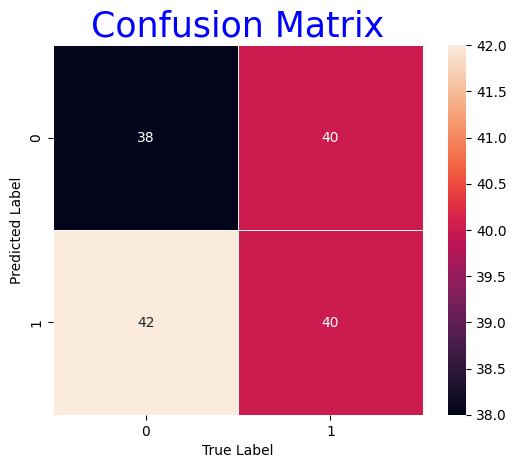

In [ ]:
# @title Fast Dev: run a small batch to see that everything works fine
# initialize the trainer

trainer = L.Trainer(fast_dev_run=5,   # 5 batches
                    accelerator="auto",
                    gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly
                    )
trainer.fit(model=bi_eq_lstm_model, datamodule=bi_eq_lstm_data)
# trainer.validate(model=gatr_model, datamodule=gatr_data)
trainer.test(model=bi_eq_lstm_model, datamodule=bi_eq_lstm_data)


In [ ]:
# @title Optuna Hyperparameter Tuning for BiEquiLinearLSTM

# Delete the tensorboard logs dir if it already exists to not accumulate logs from multiple runs
# !rm -rf lightning_logs/

class OptunaHPTuner(BaseHPTuner):
    def __init__(self,
                 model_class:Callable=SimpleGATr,
                 study_name:str="optuna_study",
                 num_epochs:int=config.num_epochs,
                 num_trials:int=10,
                 direction:str="maximize" if config.monitor_mode == "max" else "minimize"
                 ):
        super().__init__(model_class, num_epochs=num_epochs, num_trials=num_trials, study_name=study_name)
        self.direction = direction
        self.study: optuna.study.Study = optuna.create_study(study_name=study_name, direction=direction, pruner=optuna.pruners.MedianPruner())

    def objective_function(self, trial):
        # Define the hyperparameters to be optimized

        # Create your datamodule
        datamodule = GATrDataModule(train_data=X_train,
                                    val_data=val_train,
                                    test_data=X_test,
                                    batch_size = trial.suggest_int("batch_size", 32, 64, step=32), # 24, 40, step=8,
                                    num_items=config.num_items,
                                    aggr_func = trial.suggest_categorical("aggr_func", [avg_bins, take_n]),
                                    normalize = trial.suggest_categorical("normalize_data", [True, False]),
                                    )

        # Create your model and configure it with the suggested hyperparameters
        model = self.model_class(
                input_mv_channels = config.input_mv_channels,
                output_mv_channels = config.input_mv_channels,
                input_s_channels = 1,
                output_s_channels = 1, #trial.suggest_int("output_s_channels", 4, 8, step=4),
                num_items = config.num_items,
                num_classes = 1,
                num_layers = trial.suggest_int("times_n", 1, 2, step=1),
                use_scalar_hidden = trial.suggest_categorical("use_scalar_hidden", [True, False]),
                normalize = trial.suggest_categorical("normalize_basis_elements", [False, True]), # normalize basis elements
                bias = trial.suggest_categorical("bias", [False, True]), # bias in linear layer or the weights w and v
                activation_fn = "gelu", #trial.suggest_categorical("activation_fn", ["gelu", "relu"]),
                lr = trial.suggest_float("lr", 1e-7, 1e-3, log=True),
                lr_sched = 'palteau', #trial.suggest_categorical("lr_sched", ["cosine", "plateau"]),
                scheduler_patience = config.scheduler_patience,
                scheduler_factor = config.scheduler_factor,
                monitor = config.monitor,
                optimizer_fn = torch.optim.AdamW,
                loss_fn = torch.nn.BCEWithLogitsLoss,
            )

        # Configure your PyTorch Lightning Trainer
        # callbacks = [PyTorchLightningPruningCallback(trial, monitor="val_f1_score")]
        # trainer = L.Trainer(max_epochs=1, callbacks=callbacks, logger=True)
        trainer = L.Trainer(
                logger=False, #loggers.TensorBoardLogger("lightning_logs", name=self.study_name+"_tuner_"+str(trial.number)),
                callbacks=[PyTorchLightningPruningCallback(trial, monitor=config.monitor)],
                accelerator="auto",             # 'cpu', 'gpu', tpu', etc
                devices="auto",                 # num devices: 1, 2, 3, 4, ... or specify which one(s) [0], [2], [3, 5, 6], etc
                enable_checkpointing=False,
                deterministic=True,
                max_epochs=1,
                gradient_clip_val=config.gradient_clip_value, gradient_clip_algorithm='norm' # clip l2 norm of grads. use value to clip the val directly            )

            )

        # Train and validate your model
        trainer.fit(model, datamodule)

        # Retrieve the metric you want to optimize
        metric = trainer.callback_metrics[config.monitor].item()

        return metric

    def tune(self, num_epochs:Optional[int]=None, num_trials:Optional[int]=None):

        self.num_epochs = num_epochs if num_epochs is not None else self.num_epochs
        self.num_trials = num_trials if num_trials is not None else self.num_trials

        self.study.optimize(self.objective_function, n_trials=self.num_trials, show_progress_bar=True)
        self.best_trial = self.study.best_trial

        print(f"Best trial: {self.best_trial.values}")
        print(f"Best value: {self.best_trial.value}")

        # No need to return bec it is accessible after tuning.
        self.best_params = self.best_trial.params
        print("\nBest Params: ")
        for key, value in self.best_params.items():
            print(f"\t{key}: {value}")


# Demo
optuna_tuner = OptunaHPTuner(BiEquiLinearLSTM)
optuna_tuner.tune()
# optuna_tuner.tune(num_epochs=1, num_trials=1)

[I 2024-05-27 04:15:34,712] A new study created in memory with name: optuna_study


  0%|          | 0/1 [00:00<?, ?it/s]

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type                 | Params
---------------------------------------------------
0 | equi_lstm | GATrBiEquiLinearLSTM | 3.4 K 
1 | loss_fn   | BCEWithLogitsLoss    | 0     
---------------------------------------------------
3.4 K     Trainable params
0         Non-trainable params
3.4 K     Total params
0.014     Total estimated model params 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


[I 2024-05-27 04:19:11,612] Trial 0 finished with value: 0.6004542112350464 and parameters: {'batch_size': 64, 'aggr_func': <function take_n at 0x7b82809e1900>, 'normalize_data': True, 'times_n': 2, 'use_scalar_hidden': True, 'normalize_basis_elements': True, 'bias': True, 'lr': 0.00044218471809738666}. Best is trial 0 with value: 0.6004542112350464.
Best trial: [0.6004542112350464]
Best value: 0.6004542112350464

Best Params: 
	batch_size: 64
	aggr_func: <function take_n at 0x7b82809e1900>
	normalize_data: True
	times_n: 2
	use_scalar_hidden: True
	normalize_basis_elements: True
	bias: True
	lr: 0.00044218471809738666


In [ ]:
optuna_tuner.best_params

{'batch_size': 64,
 'aggr_func': <function __main__.take_n(arr: numpy.ndarray, n_items: int)>,
 'normalize_data': True,
 'times_n': 2,
 'use_scalar_hidden': True,
 'normalize_basis_elements': True,
 'bias': True,
 'lr': 0.00044218471809738666}

In [ ]:
# @title Train Optuna Model with tuned hyperparameters
optuna_tuner.train(num_epochs=config.num_epochs)

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type                 | Params
---------------------------------------------------
0 | equi_lstm | GATrBiEquiLinearLSTM | 3.4 K 
1 | loss_fn   | BCEWithLogitsLoss    | 0     
---------------------------------------------------
3.4 K     Trainable params
0         Non-trainable params
3.4 K     Total params
0.014     Total estimated model params 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO: Metric val_loss improved. New best score: 0.092
INFO:lightning.pytorch.callbacks.early_stopping:Metric val_loss improved. New best score: 0.092
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.


INFO: Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v4.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/checkpoints/optuna_study-v4.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v4.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/checkpoints/optuna_study-v4.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]



The accuracy score is 95.1250%.

classification_report: 
              precision    recall  f1-score   support

           0       1.00      0.90      0.95       400
           1       0.91      1.00      0.95       400

    accuracy                           0.95       800
   macro avg       0.96      0.95      0.95       800
weighted avg       0.96      0.95      0.95       800




┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.9512500166893005     │
│       test_f1_score       │    0.9528027176856995     │
│         test_loss         │    0.08087024092674255    │
└───────────────────────────┴───────────────────────────┘

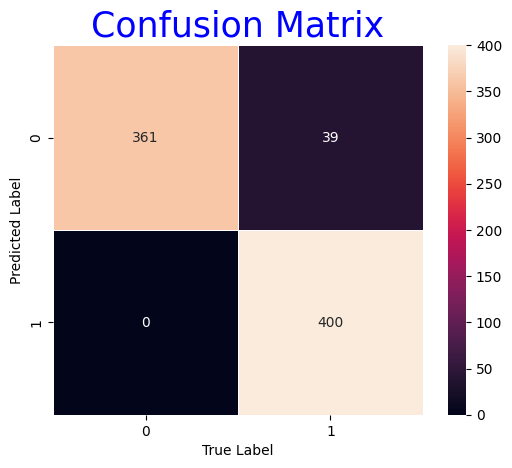

In [ ]:
# @title Test Optuna Model
optuna_tuner.test()

In [ ]:
# @title Tensorboard
%load_ext tensorboard
%tensorboard --logdir lightning_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>